## PREDICT PATIENT SURVIVAL RATE USING DATA FROM FIRST 24HOURS OF INTENSIVE CARE

MIT's GOSSIS community initiative, with privacy certification from the Harvard Privacy Lab, has provided a dataset of more than 130,000 hospital Intensive Care Unit (ICU) visits from patients, spanning a one-year timeframe. This data is part of a growing global effort and consortium spanning Argentina, Australia, New Zealand, Sri Lanka, Brazil, and more than 200 hospitals in the United States.
___

## I.IMPORT LIBRARIES

In [0]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.graph_objs as go
from plotly import tools
import matplotlib.pyplot as plt
sns.set(style="whitegrid")
%matplotlib inline

import datetime, warnings, scipy 
import matplotlib as mpl
import matplotlib.patches as patches
from matplotlib.patches import ConnectionPatch
from collections import OrderedDict
from matplotlib.gridspec import GridSpec
from scipy.optimize import curve_fit
from collections import Counter
plt.rcParams["patch.force_edgecolor"] = True
plt.style.use('fivethirtyeight')
# mpl.rc('patch', edgecolor = 'dimgray', linewidth=1)

from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn import preprocessing
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn import metrics

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "last_expr"


# pickle
import pickle

import missingno as msno

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Set standard parameters
pd.options.display.float_format = '{:.1f}'.format
pd.set_option('display.max_columns', 1000)
np.random.seed(566)
pd.set_option('display.max_rows', 500)
pd.set_option('display.width', 1000)
# pd.set_option('display.float_format', '{:20,.2f}'.format)
pd.set_option('display.max_colwidth', -1)

In [0]:
from google.colab import drive
drive.mount("/content/drive/", force_remount=True)
!ls "/content/drive/My Drive"

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive/
'Colab Notebooks'
'data mining final project'
 DEP_FinalProject
 DMP_loan_project
 Healthcare
'health project 3'
'job application'
'leadership_assignment 4_note.gdoc'
'NLP note.gdoc'
 Progressive_Insurance_1.gslides
'Progressive Insurance Business Case - Question Brainstorm.gdoc'
'renew DL'
'uchicago academic fall 2019'
'uchicago admission'
'Video script'


In [0]:
!ls "/content/drive/My Drive/Healthcare"

 100_EDA.ipynb		 300_MODELING.ipynb		        Draft
'100 EDA--LAB.ipynb'	'APACHE- What you need to know .gdoc'   Literature
 200_FEATURE_SELECTION	 Data


In [0]:
# !pip install tf-nightly-gpu-2.0-preview

In [0]:
# import tensorflow as tf
# device_name = tf.test.gpu_device_name()
# if device_name != '/device:GPU:0':
#   raise SystemError('GPU not found')
# print('Found GPU at :{}'.format(device_name))

## II.IMPORT DATA

In [0]:
import os
os.getcwd()

'/content'

In [0]:
df = pd.read_csv('/content/drive/My Drive/Healthcare/Data/training_v2.csv', low_memory = False)
dictionary = pd.read_csv('/content/drive/My Drive/Healthcare/Data/WiDS Datathon 2020 Dictionary.csv')

In [0]:
df.head()

,encounter_id,patient_id,hospital_id,hospital_death,age,bmi,elective_surgery,ethnicity,gender,height,hospital_admit_source,icu_admit_source,icu_id,icu_stay_type,icu_type,pre_icu_los_days,readmission_status,weight,albumin_apache,apache_2_diagnosis,apache_3j_diagnosis,apache_post_operative,arf_apache,bilirubin_apache,bun_apache,creatinine_apache,fio2_apache,gcs_eyes_apache,gcs_motor_apache,gcs_unable_apache,gcs_verbal_apache,glucose_apache,heart_rate_apache,hematocrit_apache,intubated_apache,map_apache,paco2_apache,paco2_for_ph_apache,pao2_apache,ph_apache,resprate_apache,sodium_apache,temp_apache,urineoutput_apache,ventilated_apache,wbc_apache,d1_diasbp_invasive_max,d1_diasbp_invasive_min,d1_diasbp_max,d1_diasbp_min,d1_diasbp_noninvasive_max,d1_diasbp_noninvasive_min,d1_heartrate_max,d1_heartrate_min,d1_mbp_invasive_max,d1_mbp_invasive_min,d1_mbp_max,d1_mbp_min,d1_mbp_noninvasive_max,d1_mbp_noninvasive_min,d1_resprate_max,d1_resprate_min,d1_spo2_max,d1_spo2_min,d1_sysbp_invasive_max,d1_sysbp_invasive_min,d1_sysbp_max,d1_sysbp_min,d1_sysbp_noninvasive_max,d1_sysbp_noninvasive_min,d1_temp_max,d1_temp_min,h1_diasbp_invasive_max,h1_diasbp_invasive_min,h1_diasbp_max,h1_diasbp_min,h1_diasbp_noninvasive_max,h1_diasbp_noninvasive_min,h1_heartrate_max,h1_heartrate_min,h1_mbp_invasive_max,h1_mbp_invasive_min,h1_mbp_max,h1_mbp_min,h1_mbp_noninvasive_max,h1_mbp_noninvasive_min,h1_resprate_max,h1_resprate_min,h1_spo2_max,h1_spo2_min,h1_sysbp_invasive_max,h1_sysbp_invasive_min,h1_sysbp_max,h1_sysbp_min,h1_sysbp_noninvasive_max,h1_sysbp_noninvasive_min,h1_temp_max,h1_temp_min,d1_albumin_max,d1_albumin_min,d1_bilirubin_max,d1_bilirubin_min,d1_bun_max,d1_bun_min,d1_calcium_max,d1_calcium_min,d1_creatinine_max,d1_creatinine_min,d1_glucose_max,d1_glucose_min,d1_hco3_max,d1_hco3_min,d1_hemaglobin_max,d1_hemaglobin_min,d1_hematocrit_max,d1_hematocrit_min,d1_inr_max,d1_inr_min,d1_lactate_max,d1_lactate_min,d1_platelets_max,d1_platelets_min,d1_potassium_max,d1_potassium_min,d1_sodium_max,d1_sodium_min,d1_wbc_max,d1_wbc_min,h1_albumin_max,h1_albumin_min,h1_bilirubin_max,h1_bilirubin_min,h1_bun_max,h1_bun_min,h1_calcium_max,h1_calcium_min,h1_creatinine_max,h1_creatinine_min,h1_glucose_max,h1_glucose_min,h1_hco3_max,h1_hco3_min,h1_hemaglobin_max,h1_hemaglobin_min,h1_hematocrit_max,h1_hematocrit_min,h1_inr_max,h1_inr_min,h1_lactate_max,h1_lactate_min,h1_platelets_max,h1_platelets_min,h1_potassium_max,h1_potassium_min,h1_sodium_max,h1_sodium_min,h1_wbc_max,h1_wbc_min,d1_arterial_pco2_max,d1_arterial_pco2_min,d1_arterial_ph_max,d1_arterial_ph_min,d1_arterial_po2_max,d1_arterial_po2_min,d1_pao2fio2ratio_max,d1_pao2fio2ratio_min,h1_arterial_pco2_max,h1_arterial_pco2_min,h1_arterial_ph_max,h1_arterial_ph_min,h1_arterial_po2_max,h1_arterial_po2_min,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,apache_3j_bodysystem,apache_2_bodysystem
0,66154,25312,118,0,68.0,22.7,0,Caucasian,M,180.3,Floor,Floor,92,admit,CTICU,0.5,0,73.9,2.3,113.0,502.0,0,0.0,0.4,31.0,2.5,nan,3.0,6.0,0.0,4.0,168.0,118.0,27.4,0.0,40.0,nan,nan,nan,nan,36.0,134.0,39.3,nan,0.0,14.1,46.0,32.0,68.0,37.0,68.0,37.0,119.0,72.0,66.0,40.0,89.0,46.0,89.0,46.0,34.0,10.0,100.0,74.0,122.0,64.0,131.0,73.0,131.0,73.0,39.9,37.2,nan,nan,68.0,63.0,68.0,63.0,119.0,108.0,nan,nan,86.0,85.0,86.0,85.0,26.0,18.0,100.0,74.0,nan,nan,131.0,115.0,131.0,115.0,39.5,37.5,2.3,2.3,0.4,0.4,31.0,30.0,8.5,7.4,2.5,2.2,168.0,109.0,19.0,15.0,8.9,8.9,27.4,27.4,nan,nan,1.3,1.0,233.0,233.0,4.0,3.4,136.0,134.0,14.1,14.1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.1,0.1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Sepsis,Cardiovascular
1,114252,59342,81,0,77.0,27.4,0,Caucasian,F,160.0,Floor,Floor,90,admit,Med-Surg ICU,0.9,0,70.2,nan,108.0,203.0,0,0.0,n

### Dictionary

Ref: https://www.urmc.rochester.edu/encyclopedia/content.aspx?contenttypeid=167&contentid=international_normalized_ratio

In [0]:
detailed=pd.DataFrame(dictionary.T.head(6))
detailed.columns=list(detailed.loc[detailed.index == 'Variable Name'].unstack())
detailed = detailed.loc[detailed.index != 'Variable Name']
df_stat = pd.DataFrame(df.describe())
df_stat = pd.concat([detailed,df_stat],axis=0)
df_stat.head(20)

,age,aids,albumin_apache,apache_2_bodysystem,apache_2_diagnosis,apache_3j_bodysystem,apache_3j_diagnosis,apache_4a_hospital_death_prob,apache_4a_icu_death_prob,apache_post_operative,arf_apache,bilirubin_apache,bmi,bun_apache,cirrhosis,creatinine_apache,d1_albumin_max,d1_albumin_min,d1_arterial_pco2_max,d1_arterial_pco2_min,d1_arterial_ph_max,d1_arterial_ph_min,d1_arterial_po2_max,d1_arterial_po2_min,d1_bilirubin_max,d1_bilirubin_min,d1_bun_max,d1_bun_min,d1_calcium_max,d1_calcium_min,d1_creatinine_max,d1_creatinine_min,d1_diasbp_invasive_max,d1_diasbp_invasive_min,d1_diasbp_max,d1_diasbp_min,d1_diasbp_noninvasive_max,d1_diasbp_noninvasive_min,d1_glucose_max,d1_glucose_min,d1_hco3_max,d1_hco3_min,d1_heartrate_max,d1_heartrate_min,d1_hemaglobin_max,d1_hemaglobin_min,d1_hematocrit_max,d1_hematocrit_min,d1_inr_max,d1_inr_min,d1_lactate_max,d1_lactate_min,d1_mbp_invasive_max,d1_mbp_invasive_min,d1_mbp_max,d1_mbp_min,d1_mbp_noninvasive_max,d1_mbp_noninvasive_min,d1_pao2fio2ratio_max,d1_pao2fio2ratio_min,d1_platelets_max,d1_platelets_min,d1_potassium_max,d1_potassium_min,d1_resprate_max,d1_resprate_min,d1_sodium_max,d1_sodium_min,d1_spo2_max,d1_spo2_min,d1_sysbp_invasive_max,d1_sysbp_invasive_min,d1_sysbp_max,d1_sysbp_min,d1_sysbp_noninvasive_max,d1_sysbp_noninvasive_min,d1_temp_max,d1_temp_min,d1_wbc_max,d1_wbc_min,diabetes_mellitus,elective_surgery,encounter_id,ethnicity,fio2_apache,gcs_eyes_apache,gcs_motor_apache,gcs_unable_apache,gcs_verbal_apache,gender,glucose_apache,h1_albumin_max,h1_albumin_min,h1_arterial_pco2_max,h1_arterial_pco2_min,h1_arterial_ph_max,h1_arterial_ph_min,h1_arterial_po2_max,h1_arterial_po2_min,h1_bilirubin_max,h1_bilirubin_min,h1_bun_max,h1_bun_min,h1_calcium_max,h1_calcium_min,h1_creatinine_max,h1_creatinine_min,h1_diasbp_invasive_max,h1_diasbp_invasive_min,h1_diasbp_max,h1_diasbp_min,h1_diasbp_noninvasive_max,h1_diasbp_noninvasive_min,h1_glucose_max,h1_glucose_min,h1_hco3_max,h1_hco3_min,h1_heartrate_max,h1_heartrate_min,h1_hemaglobin_max,h1_hemaglobin_min,h1_hematocrit_max,h1_hematocrit_min,h1_inr_max,h1_inr_min,h1_lactate_max,h1_lactate_min,h1_mbp_invasive_max,h1_mbp_invasive_min,h1_mbp_max,h1_mbp_min,h1_mbp_noninvasive_max,h1_mbp_noninvasive_min,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,h1_platelets_max,h1_platelets_min,h1_potassium_max,h1_potassium_min,h1_resprate_max,h1_resprate_min,h1_sodium_max,h1_sodium_min,h1_spo2_max,h1_spo2_min,h1_sysbp_invasive_max,h1_sysbp_invasive_min,h1_sysbp_max,h1_sysbp_min,h1_sysbp_noninvasive_max,h1_sysbp_noninvasive_min,h1_temp_max,h1_temp_min,h1_wbc_max,h1_wbc_min,heart_rate_apache,height,hematocrit_apache,hepatic_failure,hospital_admit_source,hospital_death,hospital_id,icu_admit_source,icu_admit_type,icu_id,icu_stay_type,icu_type,immunosuppression,intubated_apache,leukemia,lymphoma,map_apache,paco2_apache,paco2_for_ph_apache,pao2_apache,patient_id,ph_apache,pre_icu_los_days,pred,readmission_status,resprate_apache,sodium_apache,solid_tumor_with_metastasis,temp_apache,urineoutput_apache,ventilated_apache,wbc_apache,weight
Category,demographic,APACHE comorbidity,APACHE covariate,APACHE grouping,APACHE covariate,APACHE grouping,APACHE covariate,APACHE prediction,APACHE prediction,APACHE covariate,APACHE covariate,APACHE covariate,demographic,APACHE covariate,APACHE comorbidity,APACHE covariate,labs,labs,labs blood gas,labs blood gas,labs blood gas,labs blood gas,labs blood gas,labs blood gas,labs,labs,labs,labs,labs,labs,labs,labs,vitals,vitals,vitals,vitals,vitals,vitals,labs,labs,labs,labs,vitals,vitals,labs,labs,labs,labs,labs,labs,labs,labs,vitals,vitals,vitals,vitals,vitals,vitals,labs blood gas,labs blood gas,labs,labs,labs,labs,vitals,vitals,labs,labs,vitals,vitals,vitals,vitals,vitals,vitals,vitals,vitals,vitals,vitals,labs,labs,APACHE comorbidity,demographic,identifier,demographic,APACHE covariate,APACHE covariate,APACHE covariate,APACHE covariate,APACHE covariate,demographic,APACHE covariate,labs,labs,labs blood gas,labs blood gas,labs blood gas,labs blood gas

In [0]:
df_stat.T.head(20)

,Category,Unit of Measure,Data Type,Description,Example,count,mean,std,min,25%,50%,75%,max
age,demographic,Years,numeric,The age of the patient on unit admission,None,87485.0,62.3,16.8,16.0,52.0,65.0,75.0,89.0
aids,APACHE comorbidity,None,binary,Whether the patient has a definitive diagnosis of acquired immune deficiency syndrome (AIDS) (not HIV positive alone),1,90998.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
albumin_apache,APACHE covariate,g/L,numeric,The albumin concentration measured during the first 24 hours which results in the highest APACHE III score,30,37334.0,2.9,0.7,1.2,2.4,2.9,3.4,4.6
apache_2_bodysystem,APACHE grouping,None,string,Admission diagnosis group for APACHE II,Respiratory,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
apache_2_diagnosis,APACHE covariate,None,string,The APACHE II diagnosis for the ICU admission,308,90051.0,185.4,86.1,101.0,113.0,122.0,301.0,308.0
apache_3j_bodysystem,APACHE grouping,None,string,Admission diagnosis group for APACHE III,Cardiovascular,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
apache_3j_diagnosis,APACHE covariate,None,string,The APACHE III-J sub-diagnosis code which best describes the reason for the ICU admission,1405,90612.0,558.2,463.3,0.0,203.0,409.0,703.0,2201.1
apache_4a_hospital_death_prob,APACHE prediction,None,numeric,"The APACHE IVa probabilistic prediction of in-hospital mortality for the patient which utilizes the APACHE III score and other covariates, including diagnosis.",0.31,83766.0,0.1,0.2,-1.0,0.0,0.1,0.1,1.0
apache_4a_icu_death_prob,APACHE prediction,None,numeric,"The APACHE IVa probabilistic prediction of in ICU mortality for the patient which utilizes the APACHE III score and other covariates, including diagnosis",0.24,83766.0,0.0,0.2,-1.0,0.0,0.0,0.1,1.0
apache_post_operative,APACHE covariate,None,binary,"The APACHE operative status; 1 for post-operative, 0 for non-operative",1,91713.0,0.2,0.4,0.0,0.0,0.0,0.0,1.0


In [0]:
# Category
dictionary.Category.unique()

array(['identifier', 'demographic', 'APACHE covariate', 'vitals', 'labs',
       'labs blood gas', 'APACHE prediction', 'APACHE comorbidity',
       'APACHE grouping', 'GOSSIS example prediction'], dtype=object)

In [0]:
dictionary[dictionary['Category']=='identifier']

,Category,Variable Name,Unit of Measure,Data Type,Description,Example
0,identifier,encounter_id,None,integer,Unique identifier associated with a patient unit stay,None
1,identifier,hospital_id,None,integer,Unique identifier associated with a hospital,None
2,identifier,patient_id,None,integer,Unique identifier associated with a patient,None


___
__KEY NOTES:__

|CATEGORY| NOTES|
|--|--|
|GOSSIS example prediction | drop, just an example of prediction provided
|identifier | `counter_id`, `patient_id`, `hospital_id`. May only use hospital_id since the death_rate is different by hospital
|labs, vitals, labs blood gas| We have both 24hrs and 1st hour measurements, however, higher percentage of missing values belong to 1st hours measurement features
|APACHE prediction| 2 feautures: probabilistic prediction of *in-hospital* and *ICU* **mortality**
|APACHE comorbidity| Binary (8 columns) | Whether the patient has been diagnosed with a specific ailment or not: AIDS, cirrhosis, diabetes_mellitus, hepatic_failure, immunosupression, leukemia, lyphoma, solid tumor with metastasis
|APACHE grouping | Read in detailed
|APACHE coveriate | Read in detailed



___
## III. CHECKING MISSING VALUES

All of the maps below represent the missing values using missingo package. The correlation map lets you know which features are missing together.

In [0]:
# look at how many missing values for the columns
missing_values_count= df.isnull().sum()
missing_values_percentage=np.round(df.isnull().sum()/df.shape[0]*100,2)

#show it in dataframe
data = {'Number_missing':missing_values_count, 'Missing_percentage':missing_values_percentage} 
  
# Create DataFrame 
missing_info = pd.DataFrame(data) 
  
# Print the output. 
missing_info.sort_values('Missing_percentage',ascending = False)

,Number_missing,Missing_percentage
h1_bilirubin_min,84619,92.3
h1_bilirubin_max,84619,92.3
h1_lactate_max,84369,92.0
h1_lactate_min,84369,92.0
h1_albumin_max,83824,91.4
h1_albumin_min,83824,91.4
h1_pao2fio2ratio_min,80195,87.4
h1_pao2fio2ratio_max,80195,87.4
h1_arterial_ph_max,76424,83.3
h1_arterial_ph_min,76424,83.3


- Here we can see, we have most of lab results variables in the lab dataset contains missing values.
- First hour ususally contains more missing variables. we can keep only one measurement either first_hour/ 24_hour with same measurement

__KEY NOTES__

|CATEOGRY| NOTES|
|--|--|
|demographic |`bmi` and `height` are often missing together. Check `hospital_admi_source` ( higher % if missing values)
|APACHE covariate| high % of missing values for these features: `albumin_apche`, `bilirubin_apache`, `fio2_apache`, `paco2_apache`, `paco2_for_ph_apache`, `pao2_apache`, `ph_apache`, `urineoutput_apache`.GO DEEPDIVE INTO THOSE FEATURES
|vitals | anything with `invasive` are missing a lot of values. The rest can be imputed
|labs| most of data within 1 hours admitted are missing >> thinking of using 24hrs measurements instead. Check out `inr`,`lactate`,`albumin`, and `bilirubin`, a lot of missing values, even using 24hours results.
|labs blood gas | Check how importance these features are. Most of them are missing. Maybe drop if can use other features instead
|APACHE prediction | if one of the 2 features has missing values, the other also has missing values
|APACHE comorbidity| very few missing value. Can be imputed
|APACHE grouping |  `apache2_bodysystem` and `apache3_bodysystem` are missing together. Check out what is the difference bt these two

In [0]:
for color, variable in enumerate(dictionary['Category'].unique()):
  if variable not in ['GOSSIS example prediction','identifier']:
    print(variable)
    column_list = list(dictionary[dictionary['Category']==variable]['Variable Name'].values)
    column_list = [f for f in column_list if f in df.columns]
    if len(column_list) > 0:
        msno.matrix(df[column_list].sample(1000),figsize=(30, 10), labels=True, color=(color/10, 1/(color+1), 0.5),  fontsize=16)
        msno.heatmap(df[column_list],figsize=(10, 10),labels=False,fontsize=14)
        plt.show()

Output hidden; open in https://colab.research.google.com to view.

___
## IV.EXPLORATORY DATA ANALYSIS


#### 1. Target Varaiable

<Figure size 720x576 with 0 Axes>

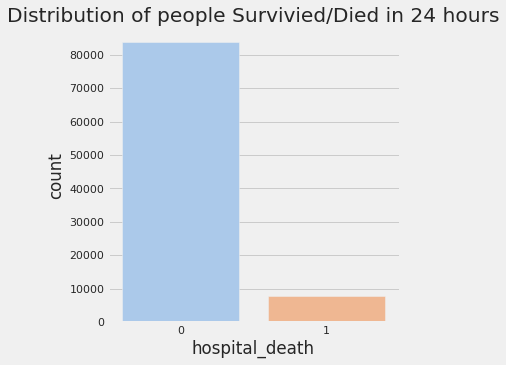

There are 8.63% of people who died in the dataset. Thus data is very imbalanced


In [0]:
#check distribution of y label in the dataset.
plt.figure(figsize=(10, 8))
sns.catplot(x ='hospital_death', kind ='count',palette='pastel', data = df)
plt.title('Distribution of people Survivied/Died in 24 hours')
plt.show()
print('There are {}% of people who died in the dataset. Thus data is very imbalanced'.format(np.round(df.loc[df.hospital_death==1,'hospital_death'].count()/df.hospital_death.count()*100,2)))

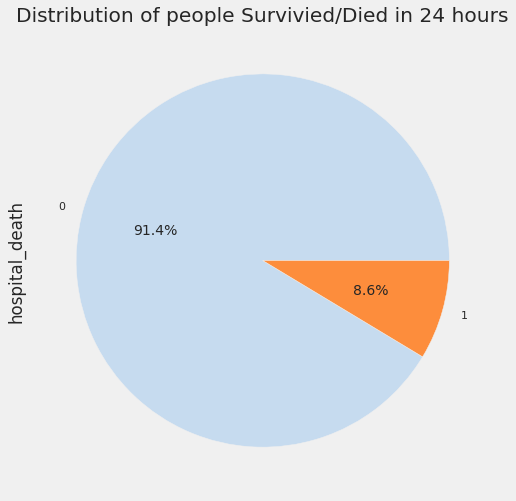

In [0]:
plt.figure(figsize=(10, 8))
cmap = plt.get_cmap("tab20c")
outer_colors = cmap(np.arange(3)*4)
inner_colors = cmap(np.array([3, 5]))

df['hospital_death'].value_counts().plot.pie(explode=[0, 0], autopct='%1.1f%%',colors=inner_colors)
plt.title('Distribution of people Survivied/Died in 24 hours')
plt.show()

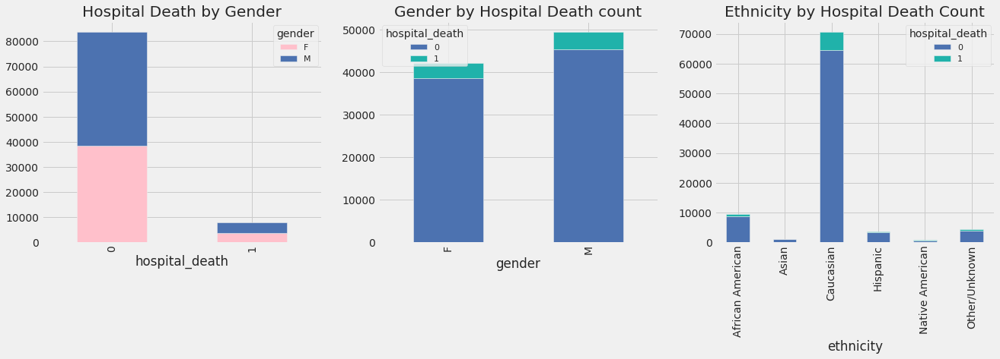

In [0]:
fig, ax = plt.subplots(1, 3, figsize=(20, 5))

df.groupby(by = ['gender', 'hospital_death']
                    ).size().reset_index().pivot(columns='gender', 
                                                 index='hospital_death', 
                                                 values=0).plot(kind='bar', 
                                                                stacked=True, 
                                                                color =['pink','b'],
                                                                title = 'Hospital Death by Gender', 
                                                                fontsize = 14, ax = ax[0])

df.groupby(by = ['gender', 'hospital_death']
                    ).size().reset_index().pivot(columns='hospital_death', 
                                                 index='gender', 
                                                 values=0).plot(kind='bar', 
                                                                stacked=True, 
                                                                color =['b','lightseagreen'],
                                                                title = 'Gender by Hospital Death count', 
                                                                fontsize = 14, ax = ax[1])
plt.figsize=(12, 5)
df.groupby(by = ['ethnicity', 'hospital_death']
                    ).size().reset_index().pivot(columns='hospital_death', 
                                                 index='ethnicity', 
                                                 values=0).plot(kind='bar', 
                                                                stacked=True, 
                                                                color =['b','lightseagreen'],
                                                                title = 'Ethnicity by Hospital Death Count', 
                                                                fontsize = 14, ax = ax[2])                                               
plt.show()

In [0]:
stats1 =df.groupby(['gender']).agg({'hospital_death':['sum','count']}).reset_index()
stats1['death_rate']=np.round(stats1['hospital_death']['sum']/stats1['hospital_death']['count']*100,2)
stats1.sort_values('death_rate',ascending = False)

gender hospital_death        death_rate
                    sum  count           
0  F      3731           42219 8.8       
1  M      4176           49469 8.4

In [0]:
stats1 =df.groupby(['ethnicity']).agg({'hospital_death':['sum','count']}).reset_index()
stats1['death_rate']=np.round(stats1['hospital_death']['sum']/stats1['hospital_death']['count']*100,2)
stats1.sort_values('death_rate',ascending = False)

ethnicity hospital_death        death_rate
                               sum  count           
3  Hispanic          376            3796  9.9       
4  Native American   70             788   8.9       
2  Caucasian         6168           70684 8.7       
1  Asian             93             1129  8.2       
5  Other/Unknown     353            4374  8.1       
0  African American  750            9547  7.9

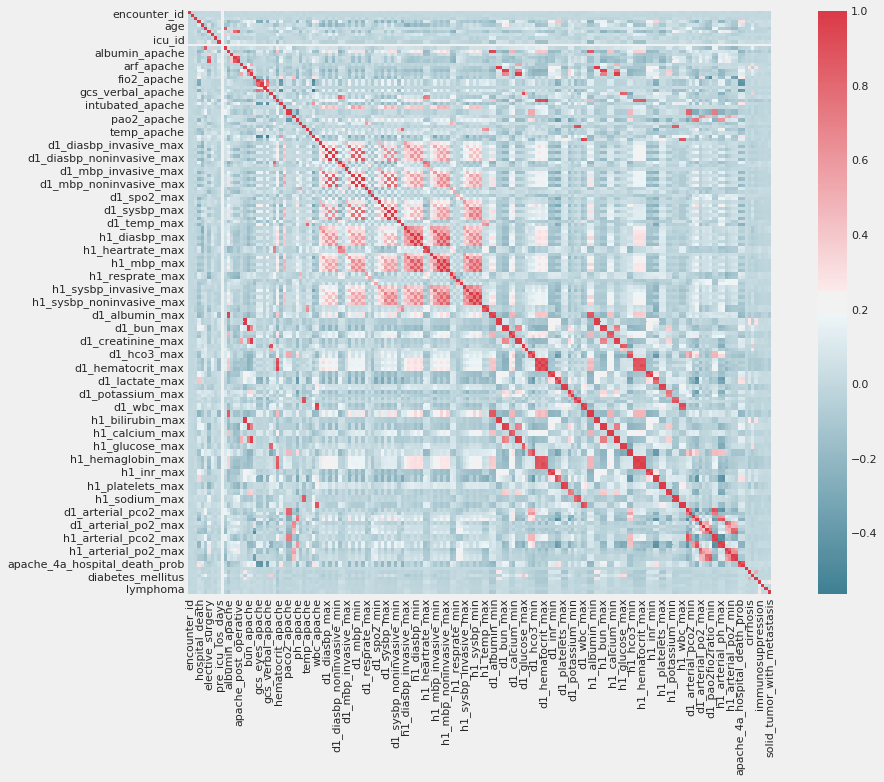

In [0]:
#heat map to check the overall correlation with all variables
f, ax = plt.subplots(figsize=(15, 10))
corr = df.corr()
sns.heatmap(corr, mask=np.zeros_like(corr, dtype=np.bool), cmap=sns.diverging_palette(220, 10, as_cmap=True),
            square=True, ax=ax)
plt.show()

### 2.Lab Analysis

In [0]:
subset =dictionary[dictionary.Category=='labs']['Variable Name'].to_list()+dictionary[dictionary.Category=='labs blood gas']['Variable Name'].to_list()
#adding target variable
subset =subset+['hospital_death','patient_id','hospital_id']

#subset the data
df_lab =df[subset]

- h1 stands for the lab results from first 1 hour
- d1 stands for the lab results from first 24 hour

In [0]:
len(missing_info)

186


- Maybe we should drop variables which contains more than 75% of data is missing, it is hard to impute those missing values. 
- Not sure how to handle this now.
- Try not to remove dataset more than 20%

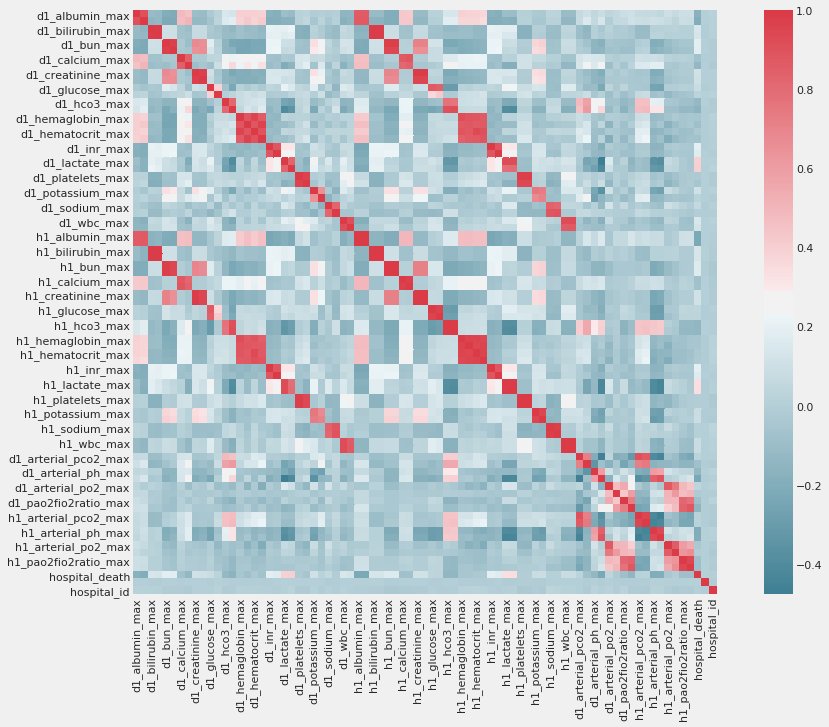

In [0]:
#heat map to check the correlation
f, ax = plt.subplots(figsize=(15, 10))
corr = df_lab.corr()
sns.heatmap(corr, mask=np.zeros_like(corr, dtype=np.bool), cmap=sns.diverging_palette(220, 10, as_cmap=True),
            square=True, ax=ax)
plt.show()

- Here we have variables that are highly correlated.
- Data Also shows the same lab measurements it has high correlations.
- For modeling, maybe not use any linear or GLM

#### 2.1 Lab All in one

##### 2.1.1 Lab with less than 50% of missing values

In [0]:
# look at how many missing values for the columns
missing_values_count= df_lab.isnull().sum()
missing_values_percentage=np.round(df_lab.isnull().sum()/df_lab.shape[0]*100,2)

#show it in dataframe
data = {'Number_missing':missing_values_count, 'Missing_percentage':missing_values_percentage} 
  
# Create DataFrame 
missing_info = pd.DataFrame(data) 
missing_info
  

,Number_missing,Missing_percentage
d1_albumin_max,49096,53.5
d1_albumin_min,49096,53.5
d1_bilirubin_max,53673,58.5
d1_bilirubin_min,53673,58.5
d1_bun_max,10514,11.5
d1_bun_min,10514,11.5
d1_calcium_max,13069,14.2
d1_calcium_min,13069,14.2
d1_creatinine_max,10169,11.1
d1_creatinine_min,10169,11.1


In [0]:
names = missing_info[missing_info.Missing_percentage<50].index.tolist()
names.remove('patient_id')
names.remove('hospital_id')
names.remove('hospital_death')
names

['d1_bun_max',
 'd1_bun_min',
 'd1_calcium_max',
 'd1_calcium_min',
 'd1_creatinine_max',
 'd1_creatinine_min',
 'd1_glucose_max',
 'd1_glucose_min',
 'd1_hco3_max',
 'd1_hco3_min',
 'd1_hemaglobin_max',
 'd1_hemaglobin_min',
 'd1_hematocrit_max',
 'd1_hematocrit_min',
 'd1_platelets_max',
 'd1_platelets_min',
 'd1_potassium_max',
 'd1_potassium_min',
 'd1_sodium_max',
 'd1_sodium_min',
 'd1_wbc_max',
 'd1_wbc_min']

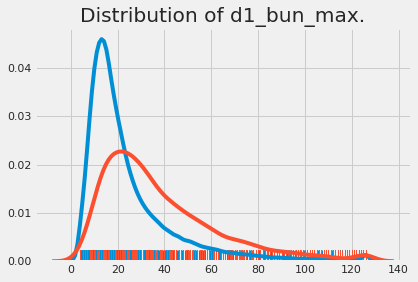

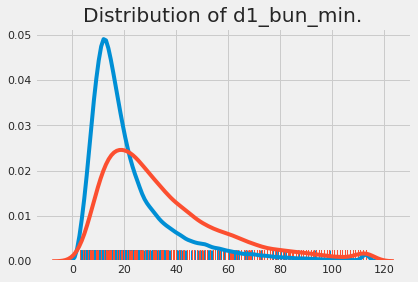

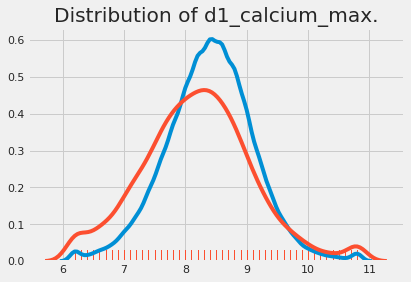

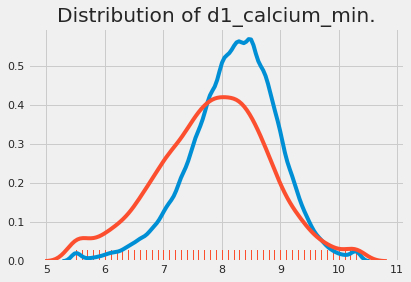

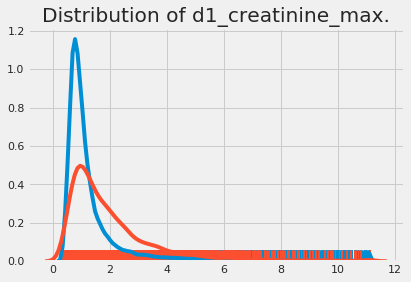

...

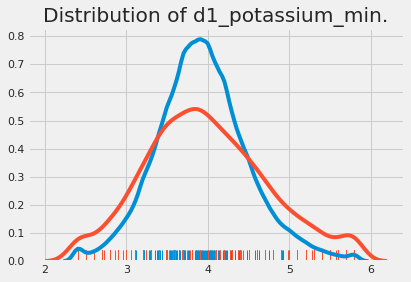

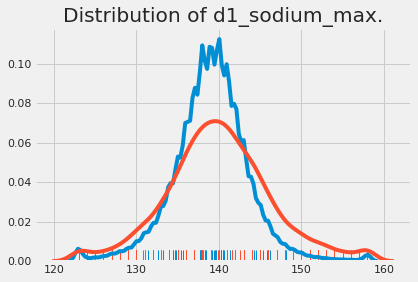

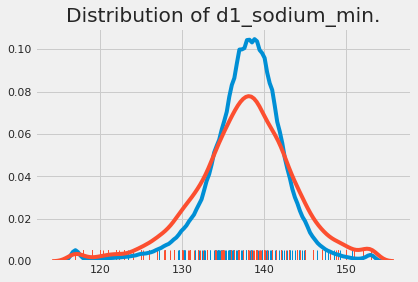

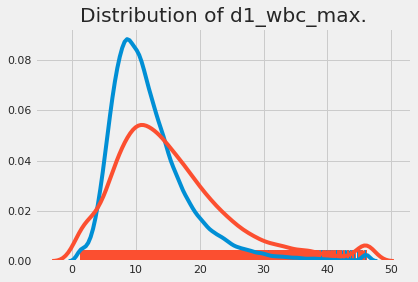

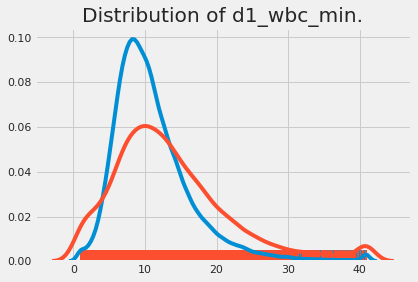

In [0]:
for i in names:
    # Sort the dataframe by target
    target_0 = df_lab.loc[df_lab['hospital_death'] == 0]
    target_1 = df_lab.loc[df_lab['hospital_death'] == 1]


    sns.distplot(target_0[[i]], hist=False, rug=True)
    sns.distplot(target_1[[i]], hist=False, rug=True)
    plt.title('Distribution of {}.'.format(i))


    plt.show()

- All Variables above shows different distribution between people who survived and dealth.
- People who died ususally have less value based for all measurements show above
- hemaglboin: min max; hematocrit: min max; shows similar distribution for survival and death compare to other measurements

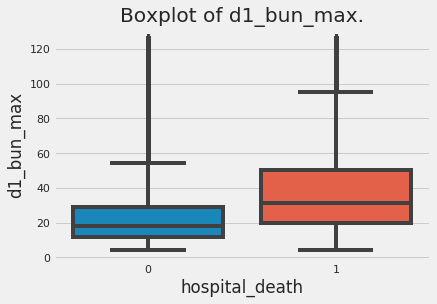

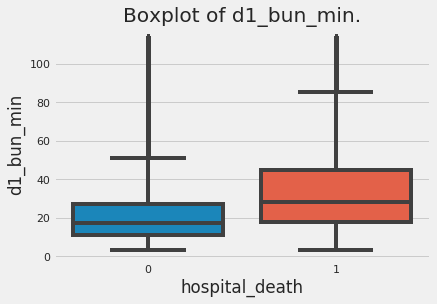

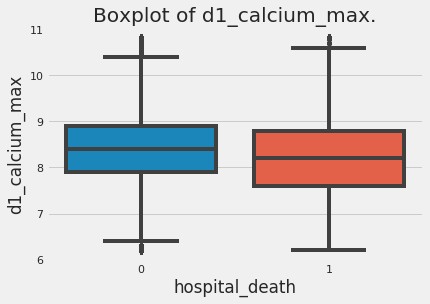

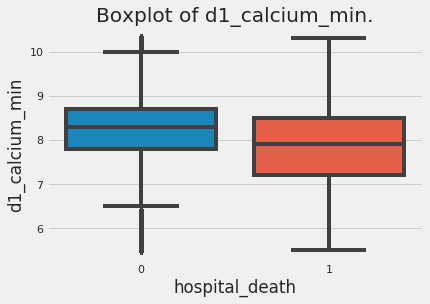

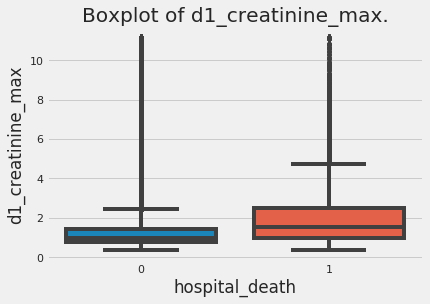

...

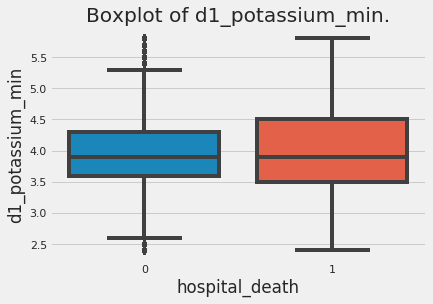

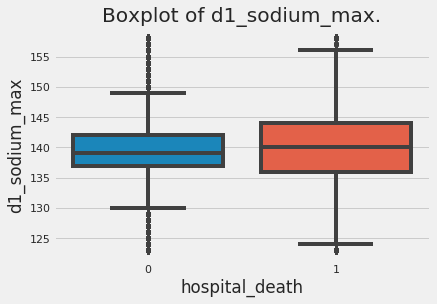

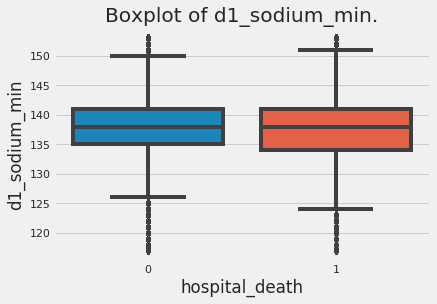

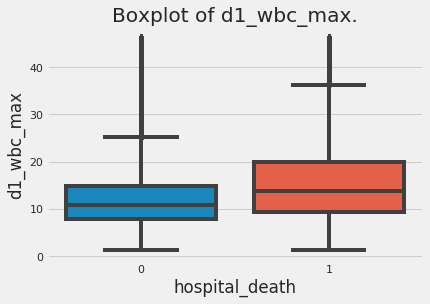

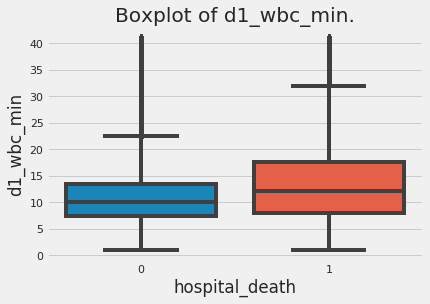

In [0]:
for i in names:
    # Sort the dataframe by target
   
    sns.boxplot(x="hospital_death", y=i, data=df_lab)
    plt.title('Boxplot of {}.'.format(i))


    plt.show()

- sodium_min

##### 2.1.2 Lab with more than 50% of missing values

In [0]:
#scatter plot for variables that has more than 50% of missing values
names_miss = missing_info[missing_info.Missing_percentage>=50].index.tolist()
#names_miss.append('hospital_death')

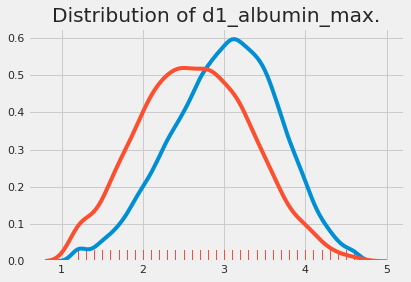

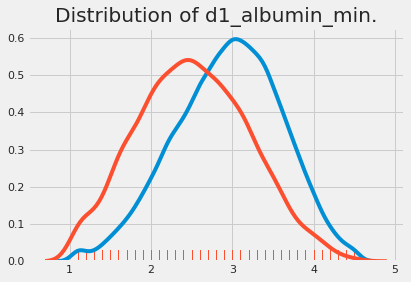

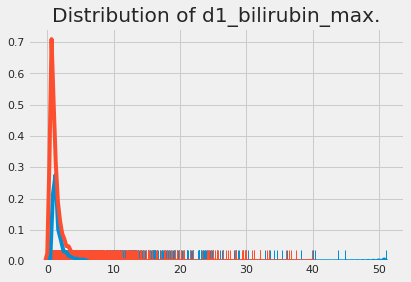

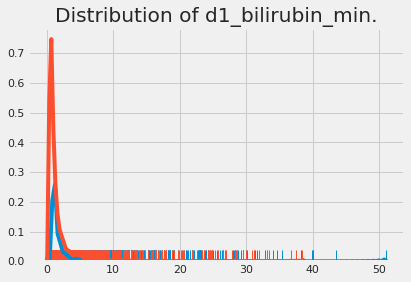

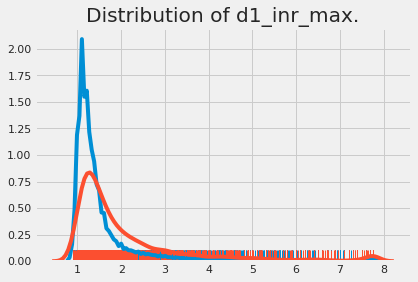

...

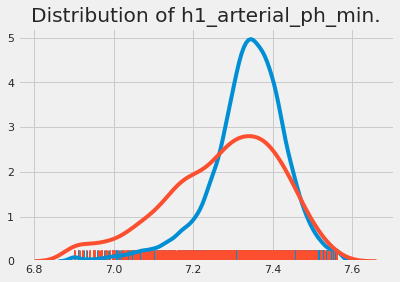

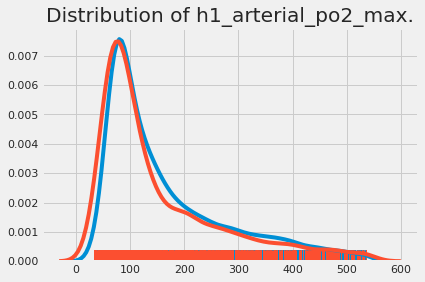

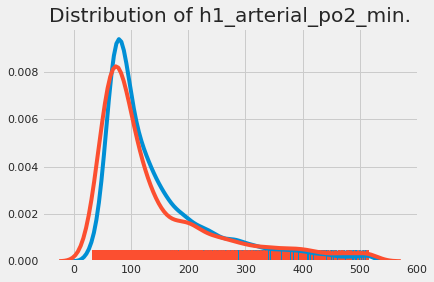

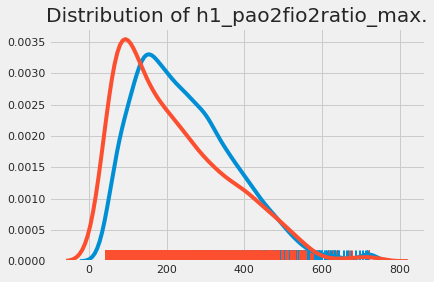

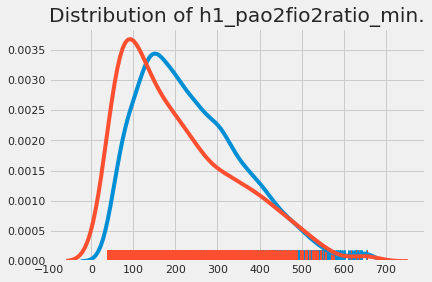

In [0]:
for i in names_miss:
    # Sort the dataframe by target
    target_0 = df_lab.loc[df_lab['hospital_death'] == 0]
    target_1 = df_lab.loc[df_lab['hospital_death'] == 1]


    sns.distplot(target_0[[i]], hist=False, rug=True)
    sns.distplot(target_1[[i]], hist=False, rug=True)
    plt.title('Distribution of {}.'.format(i))


    plt.show()

- Distribution of d1_bilirubin:min and max ; d1_inr: min and max; d1_lactate: min max; h1_bilirubin: min max is extremely skewed to the right
- we can drop hi_bilirubin: min and max for sure because pretty much the same distribution compare to d1_bilirubin:min and max.
- for imputation I think we can just choose impute mean.

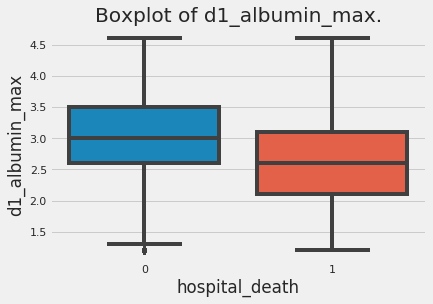

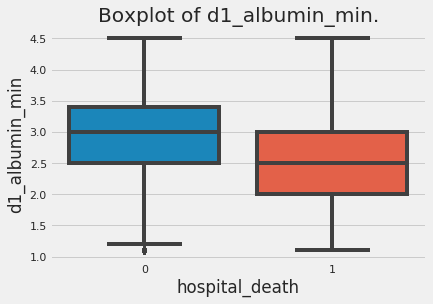

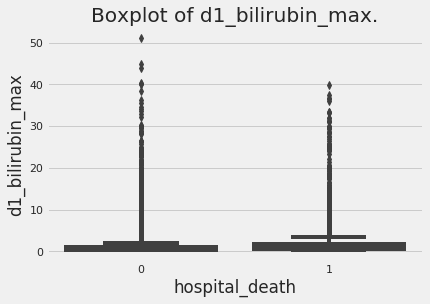

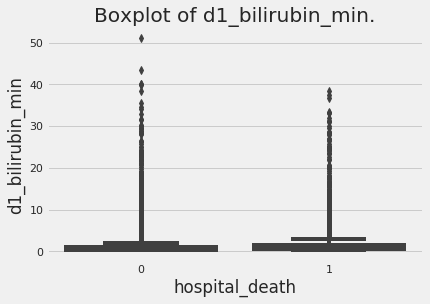

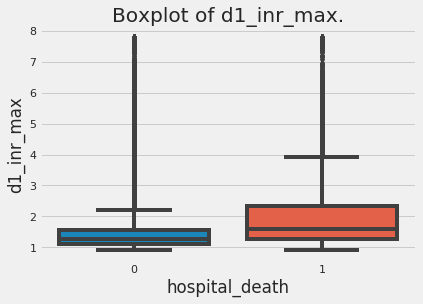

...

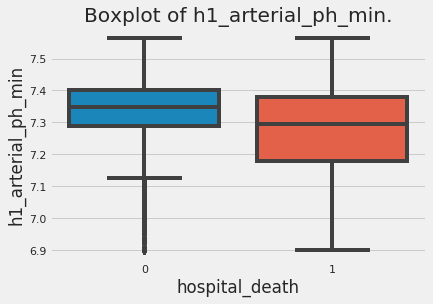

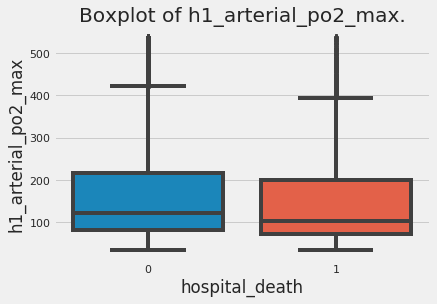

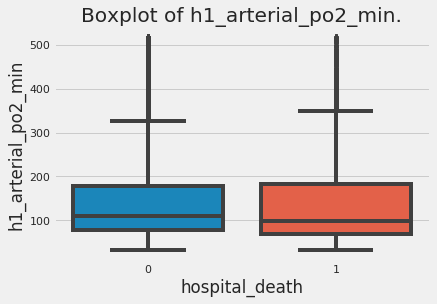

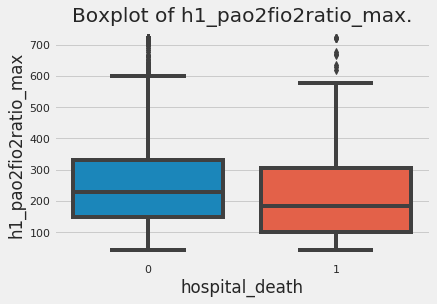

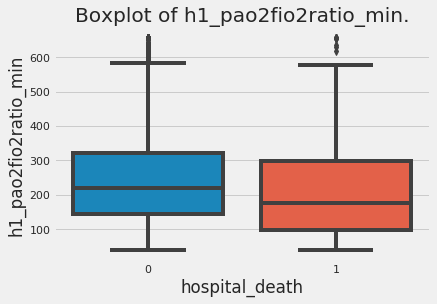

In [0]:
for i in names_miss:
    # Sort the dataframe by target
   
    sns.boxplot(x="hospital_death", y=i, data=df_lab)
    plt.title('Boxplot of {}.'.format(i))


    plt.show()

#### 2.2 Individual Measurement Analysis

##### Albumin
Albumin is a protein made by your liver. Low albumin levels can indicate a problem with your liver or kidneys.

'albumin_apache':
 - missing value: 59.3%
 - The albumin concentration measured during the first 24 hours which results in the highest `APACHE III` score

Missing Data: 
  - 1 hour: 91.4% missing
  - 24 hour:53.5% missing

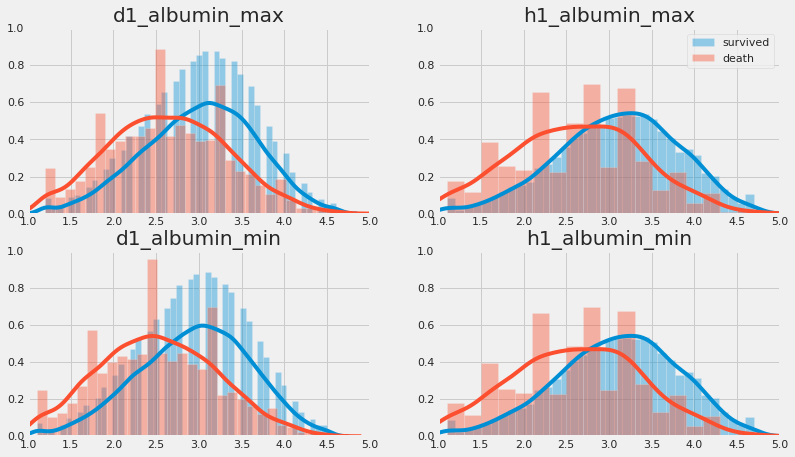

In [0]:
#check same measurements for first hour and first 24 hour
albumin=['d1_albumin_max','d1_albumin_min','h1_albumin_max','h1_albumin_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),albumin[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  ax[j][0].set_xlim([1, 5])
  ax[j][0].set_ylim([0, 1])
for (j,i) in zip(range(0,2),albumin[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  ax[j][1].set_xlim([1, 5])
  ax[j][1].set_ylim([0, 1])

###### Demo-Gender

In [0]:
demo = dictionary[dictionary.Category=='demographic']['Variable Name'].to_list()
demo

['hospital_death',
 'age',
 'bmi',
 'elective_surgery',
 'ethnicity',
 'gender',
 'height',
 'hospital_admit_source',
 'icu_admit_source',
 'icu_admit_type',
 'icu_id',
 'icu_stay_type',
 'icu_type',
 'pre_icu_los_days',
 'readmission_status',
 'weight']

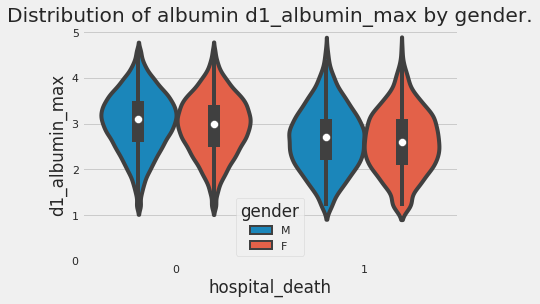

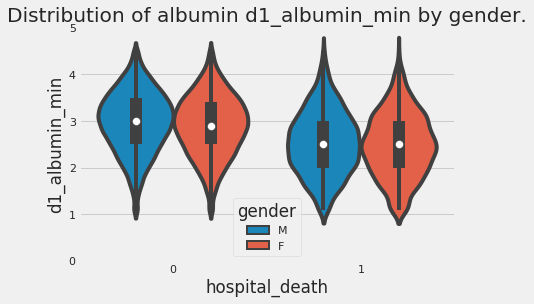

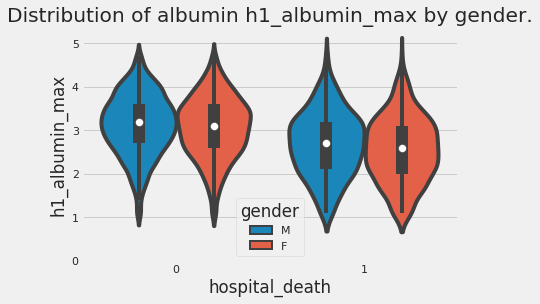

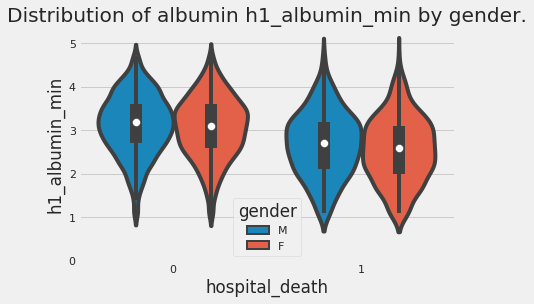

In [0]:
for i in albumin:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of albumin {} by gender.'.format(i))
  plt.show()

It looks like both Male and female have similar distribution for albumin measurement.

###### Demo-elective_surgery

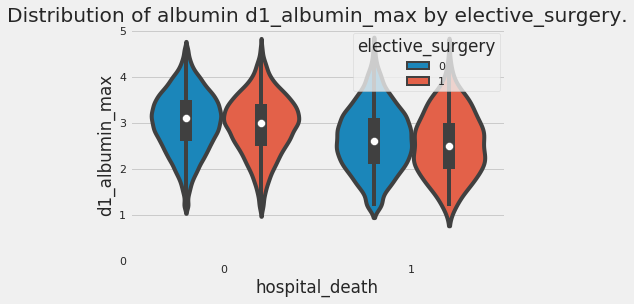

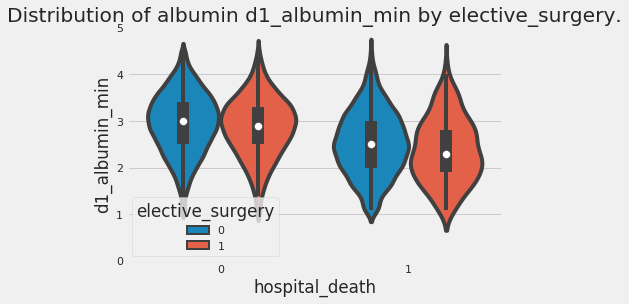

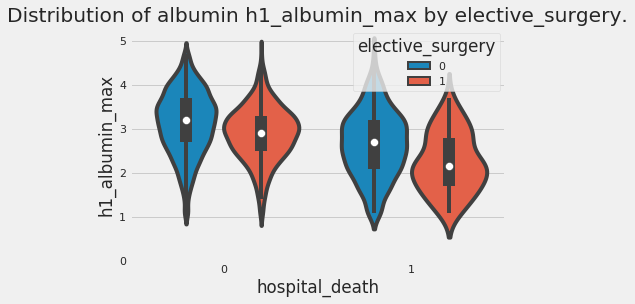

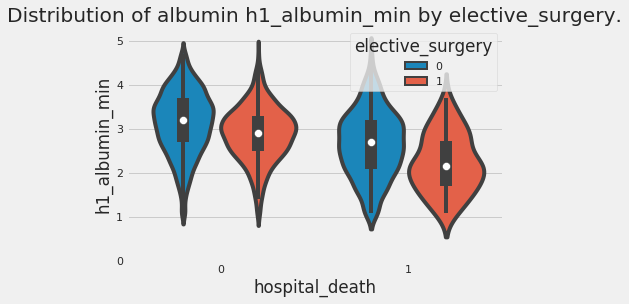

In [0]:
for i in albumin:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of albumin {} by elective_surgery.'.format(i))
  plt.show()

Look at the very right curve. pepole who had surgery shows very different distribution compare to who did not have surgery. This show more distictive in h1_albumin_min/max.

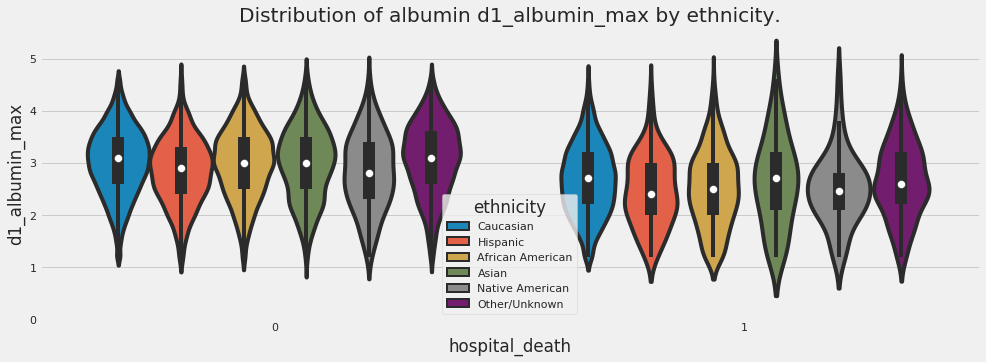

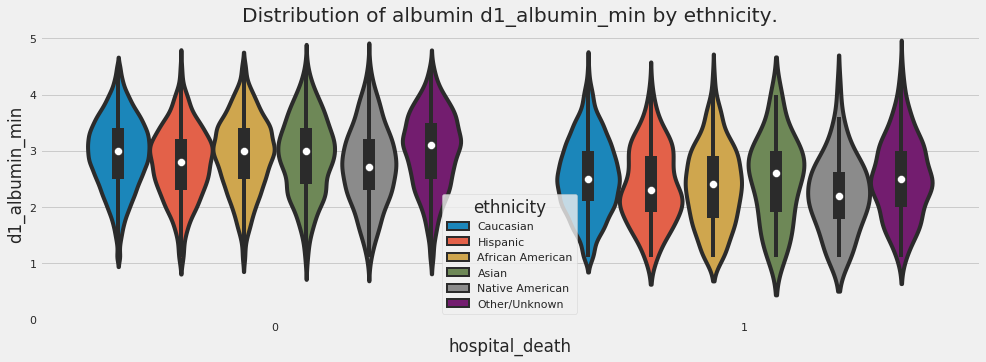

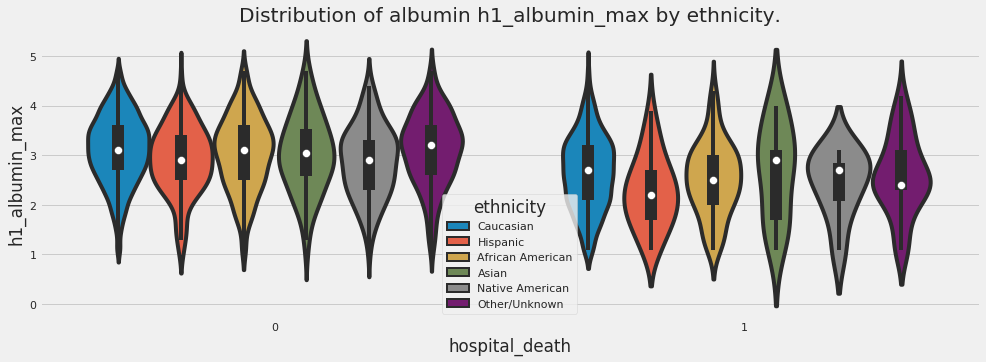

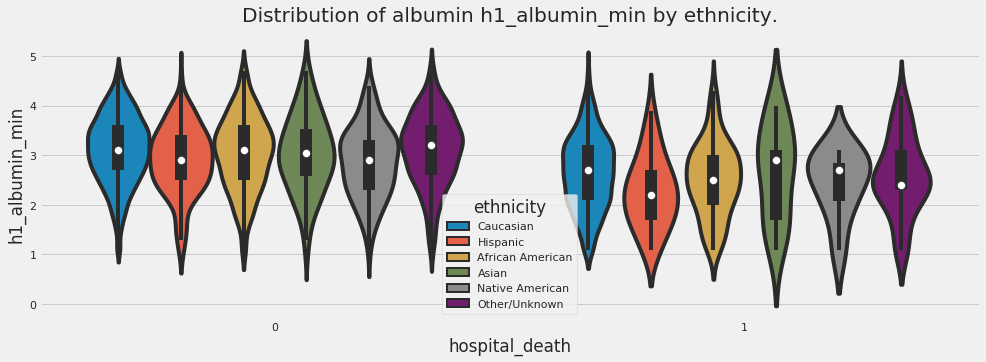

In [0]:
for i in albumin:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of albumin {} by ethnicity.'.format(i))
  plt.show()

###### Demo-age

In [0]:
for i in albumin:
  sns.relplot(x="age", y=i,col="ethnicity", hue="hospital_death", style="hospital_death",kind="scatter", data=df)

Output hidden; open in https://colab.research.google.com to view.

handle missing values: https://www.kaggle.com/usharengaraju/wids2020-handlingmissingvalues


###### Demo-Readmission_status
For this one we do not have any 1s; The dataset does not contain any patient that is readmitted to another hospital

In [0]:
df.groupby(['readmission_status']).count()['patient_id']

readmission_status
0    91713
Name: patient_id, dtype: int64

######Demo-weight

In [0]:
for i in albumin:
  sns.relplot(x="weight", y=i,col="ethnicity", hue="hospital_death", style="hospital_death",kind="scatter", data=df)

Output hidden; open in https://colab.research.google.com to view.

###### albumin_apache

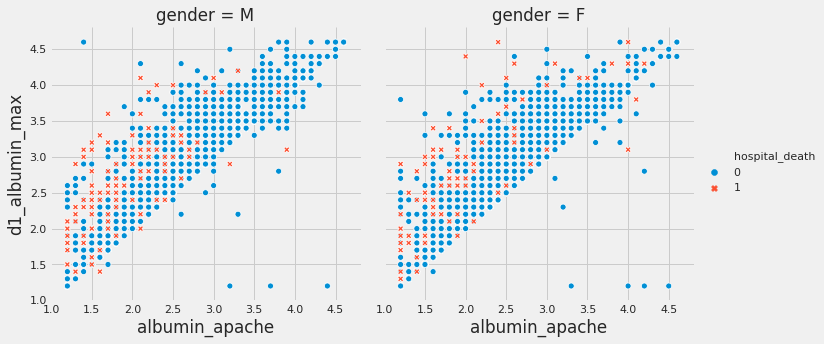

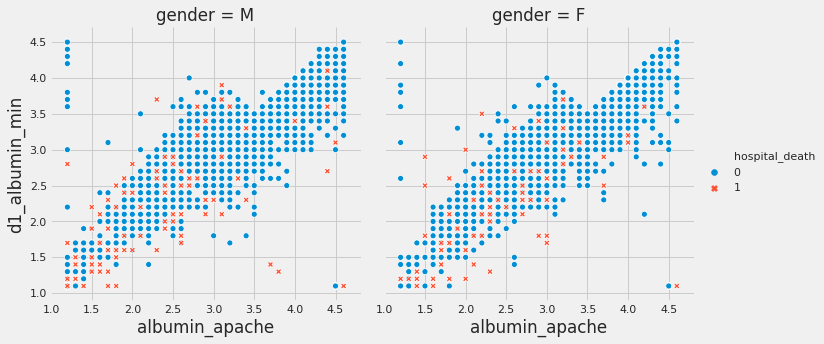

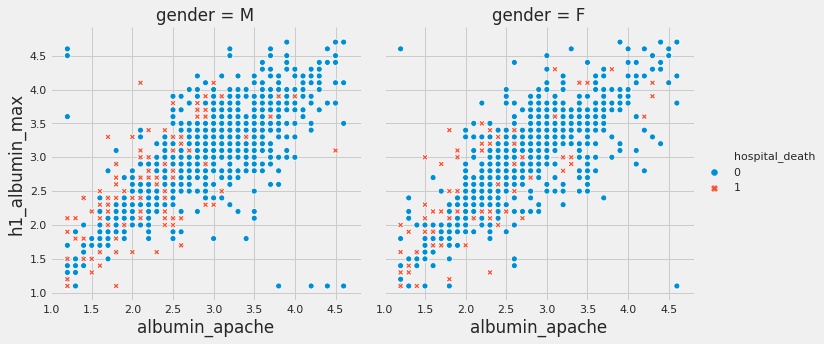

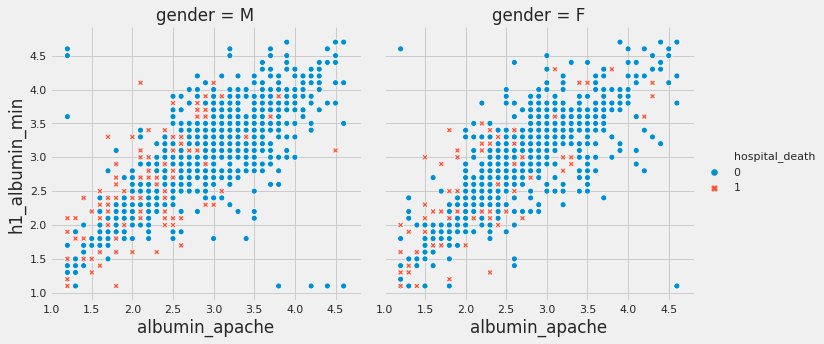

In [0]:
for i in albumin:
  sns.relplot(x="albumin_apache", y=i,col="gender", hue="hospital_death", style="hospital_death",kind="scatter", data=df)

##### Bilirubin
Elevated levels may indicate liver damage or disease. Higher than normal levels of direct bilirubin in your blood may indicate your liver isn't clearing bilirubin properly.

bilirubin_apache:
 - Missing values: 63.4%
 - The bilirubin concentration measured during the first 24 hours which results in the highest APACHE III score

Missing values: 
 - 1h: 92.3%
 - 24h: 52.5%

plot with hospital 
apache_3j_bodysystem
apache_2_bodysystem


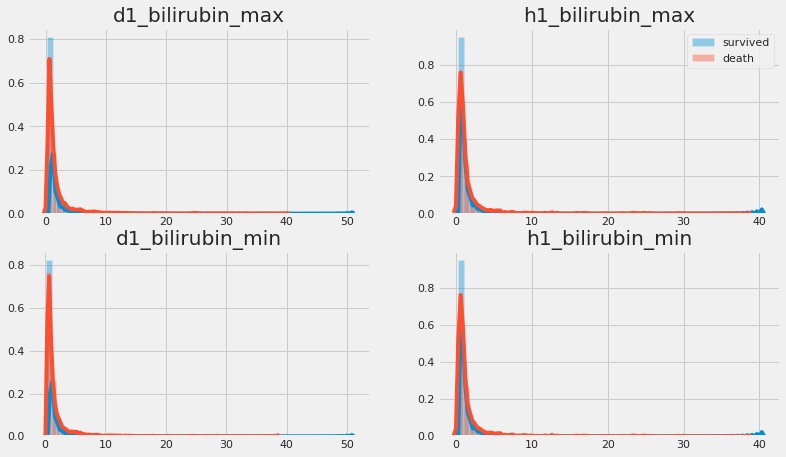

In [0]:
#check same measurements for first hour and first 24 hour
bilirubin=['d1_bilirubin_max','d1_bilirubin_min','h1_bilirubin_max','h1_bilirubin_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),bilirubin[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)

for (j,i) in zip(range(0,2),bilirubin[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])

For d1 hour measurments, those two variable shows similar distritbuion between survived/death. I believe we can drop this dataset.

###### bilirubin_apache

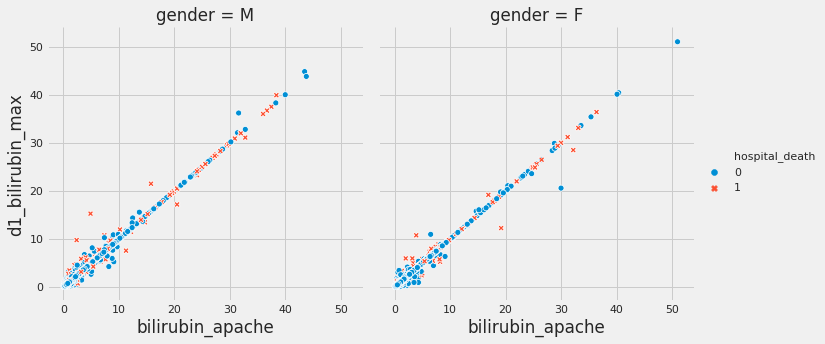

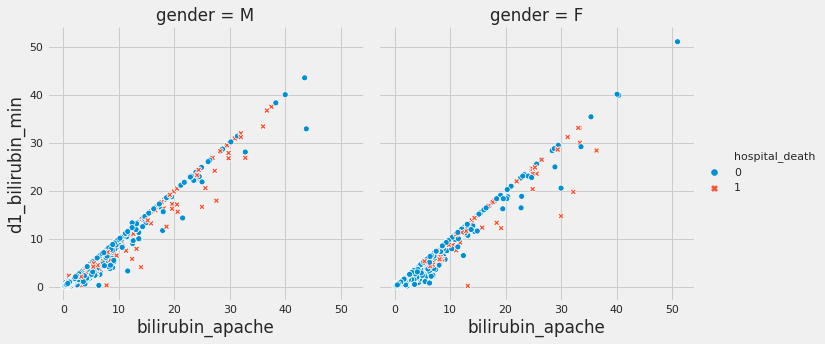

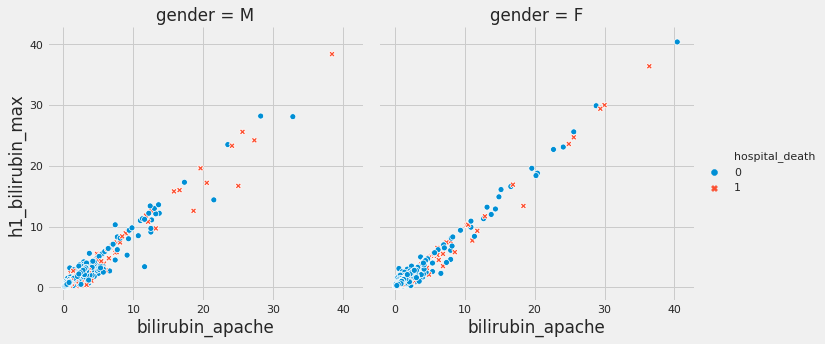

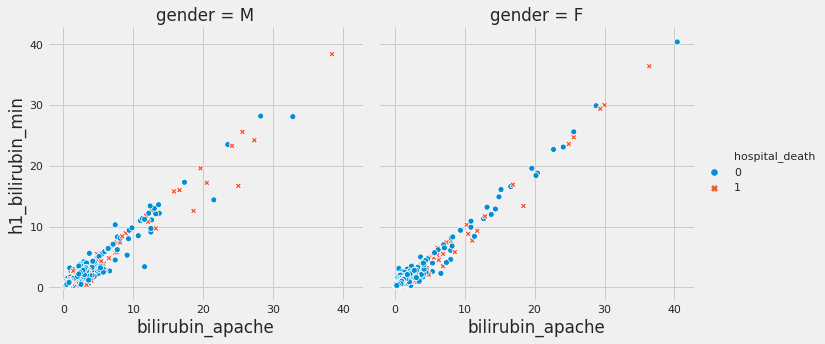

In [0]:
for i in bilirubin:
  sns.relplot(x="bilirubin_apache", y=i,col="gender", hue="hospital_death", style="hospital_death",kind="scatter", data=df)

##### Bun
The normal BUN level is between about 7 and 21 milligrams per deciliter (mg/dL). Unless this level is greater than 60 mg/dL, it may not help your healthcare provider measure your kidney health

Missing values:
 - 1h: 81.9%
 - 24: 52.5%

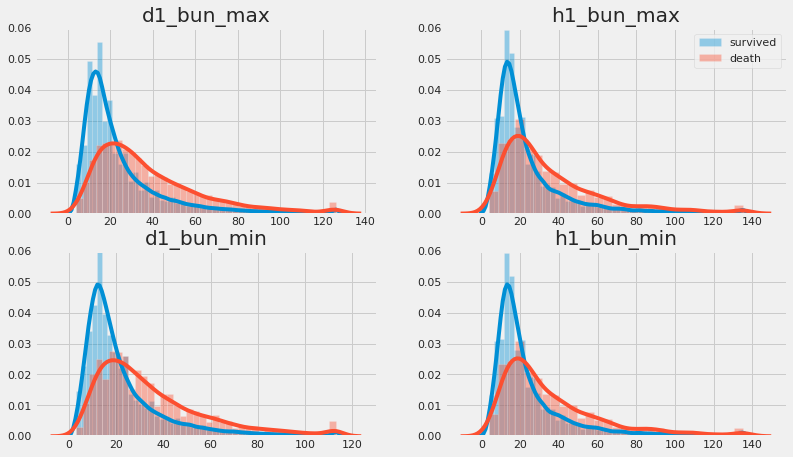

In [0]:
#check same measurements for first hour and first 24 hour
bun=['d1_bun_max','d1_bun_min','h1_bun_max','h1_bun_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),bun[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),bun[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  ax[j][1].set_ylim([0, 0.06])

###### Demo-Gender

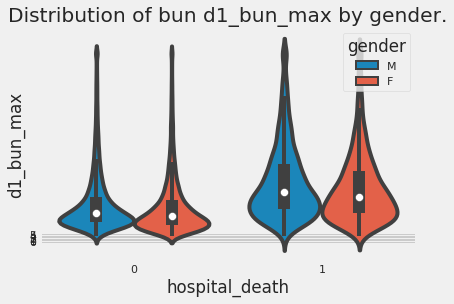

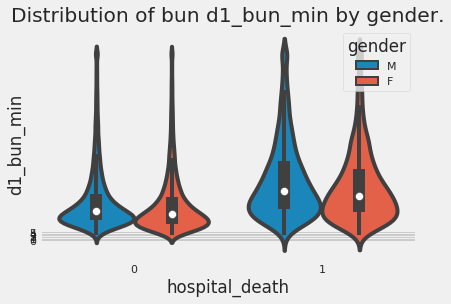

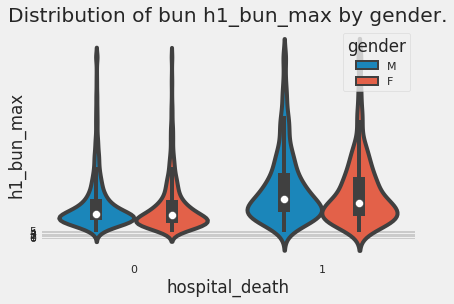

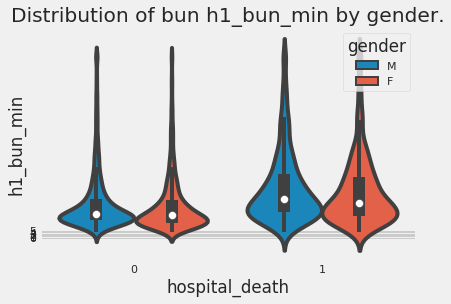

In [0]:
for i in bun:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of bun {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

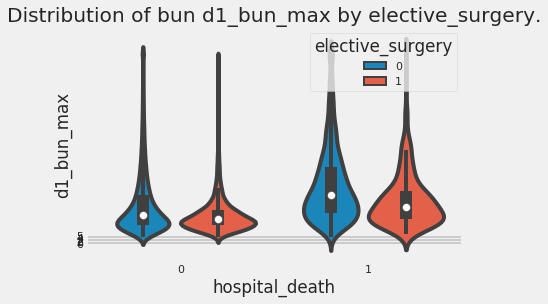

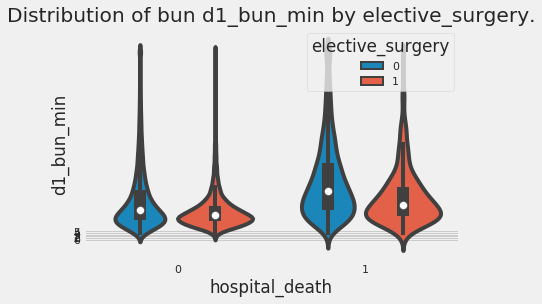

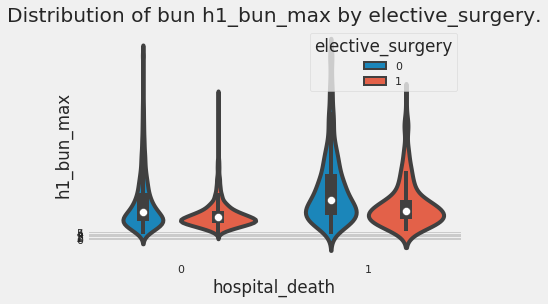

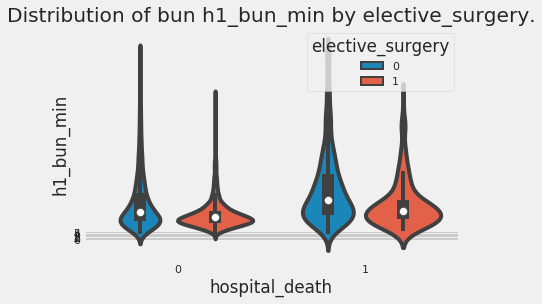

In [0]:
for i in bun:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of bun {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

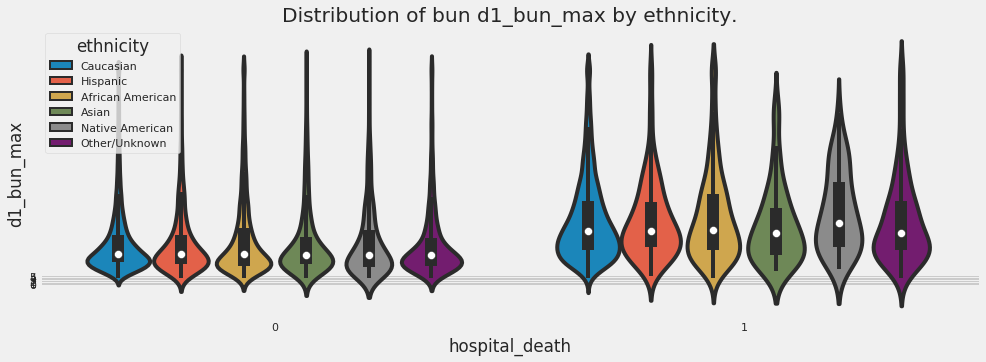

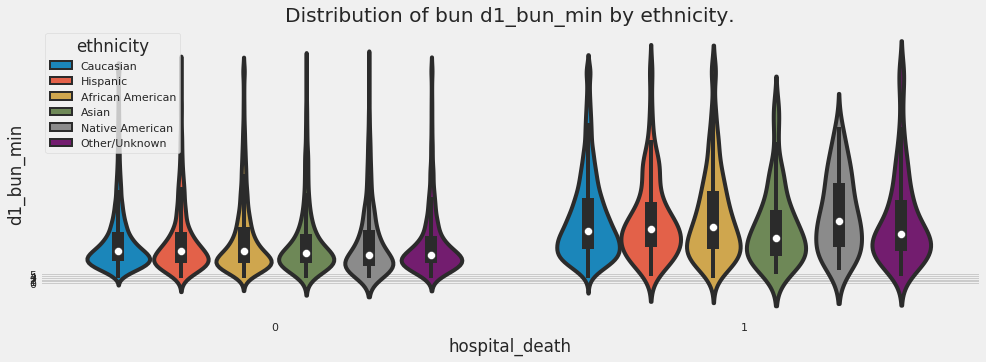

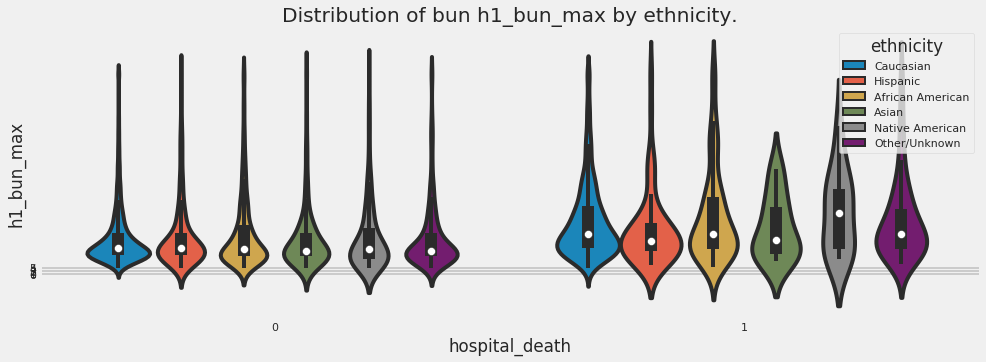

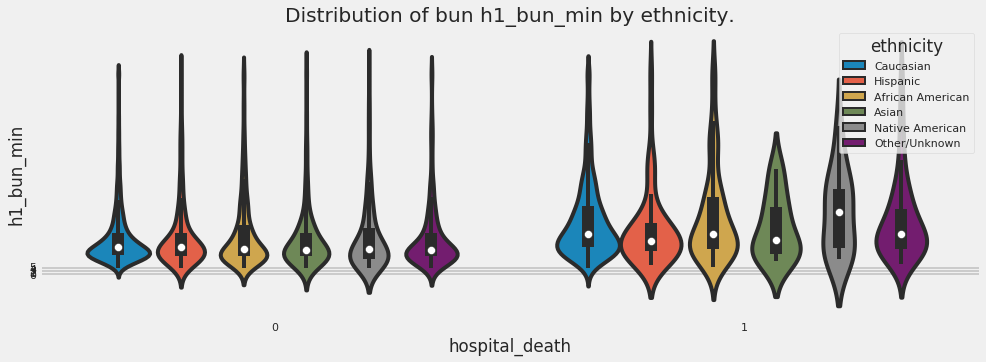

In [0]:
for i in bun:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of bun {} by ethnicity.'.format(i))
  plt.show()

##### Calcium
Normal blood calcium results in adults are: Total blood calcium: 8.5 to 10.3 milligrams per deciliter (mg/dL) Ionized calcium: 4.4 to 5.4 mg/dl

Missing values:
 - 1h: 82.7%
 - 24: 14.2%

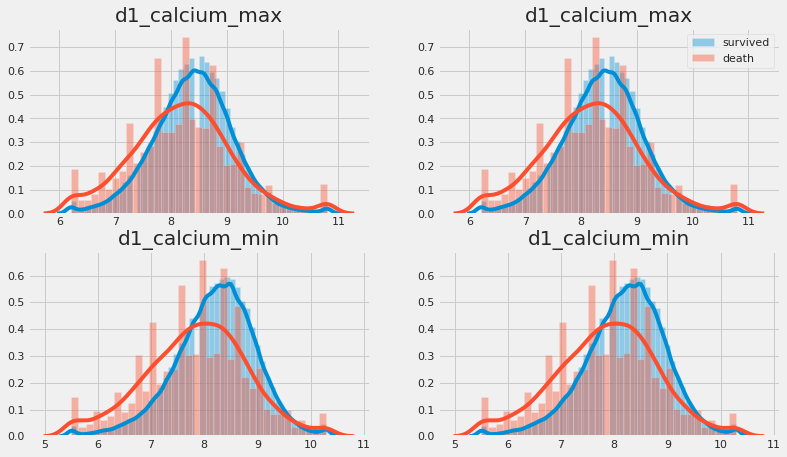

In [0]:
#check same measurements for first hour and first 24 hour
calcium=['d1_calcium_max','d1_calcium_min','h1_calcium_max','h1_calcium_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),calcium[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)


for (j,i) in zip(range(0,2),calcium[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])


###### Demo-Gender

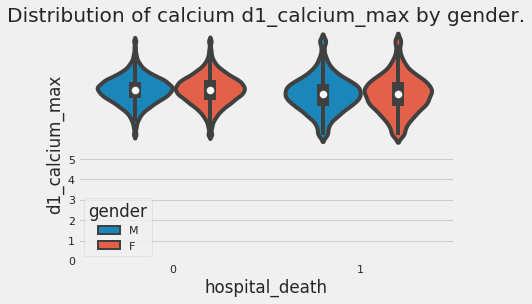

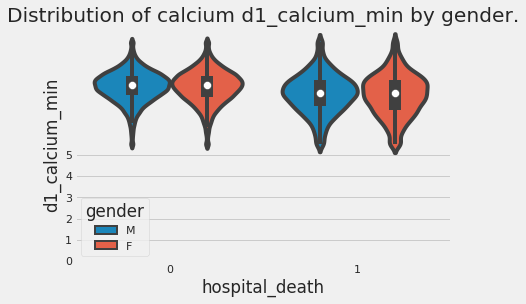

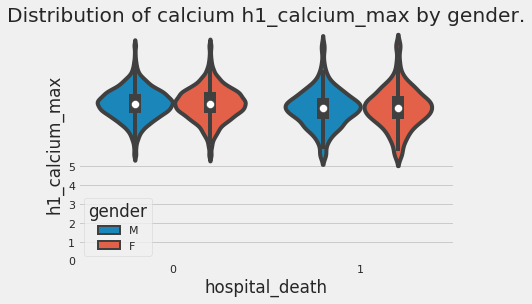

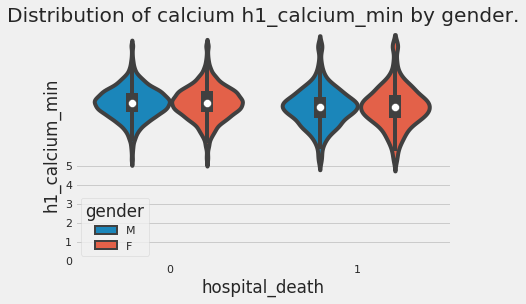

In [0]:
for i in calcium:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of calcium {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

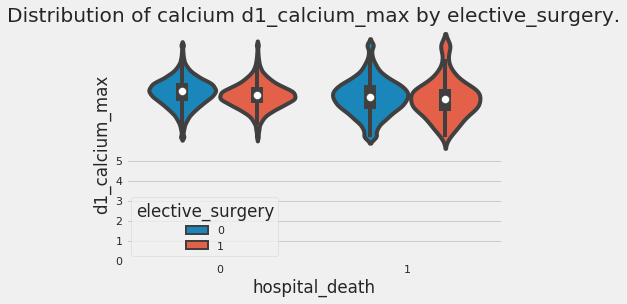

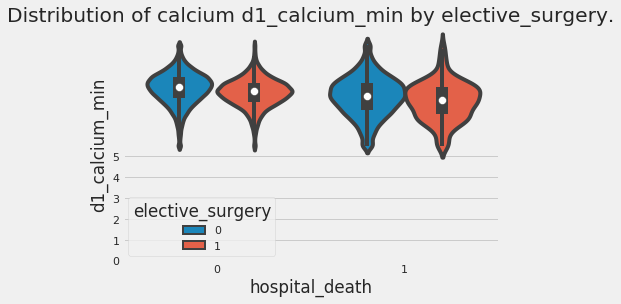

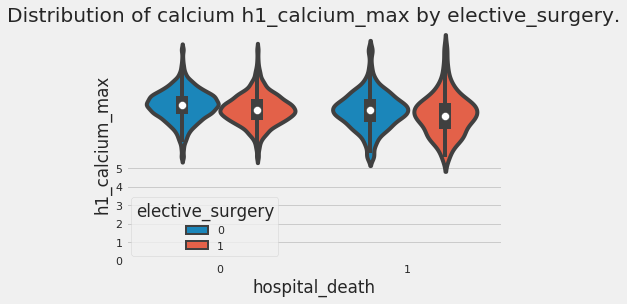

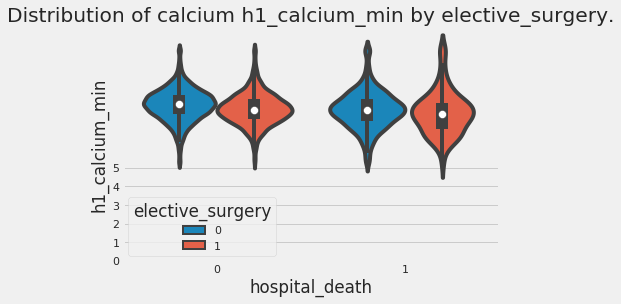

In [0]:
for i in calcium:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of calcium {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

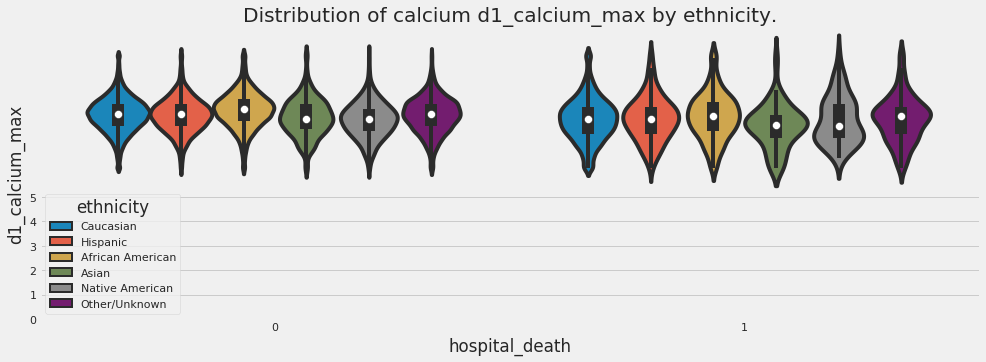

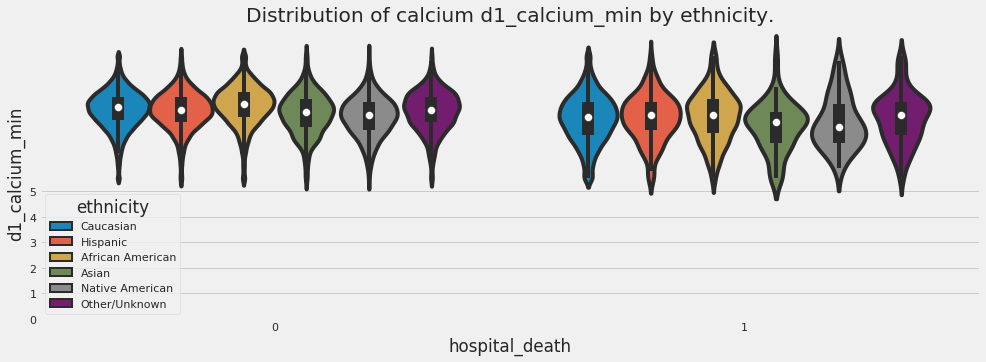

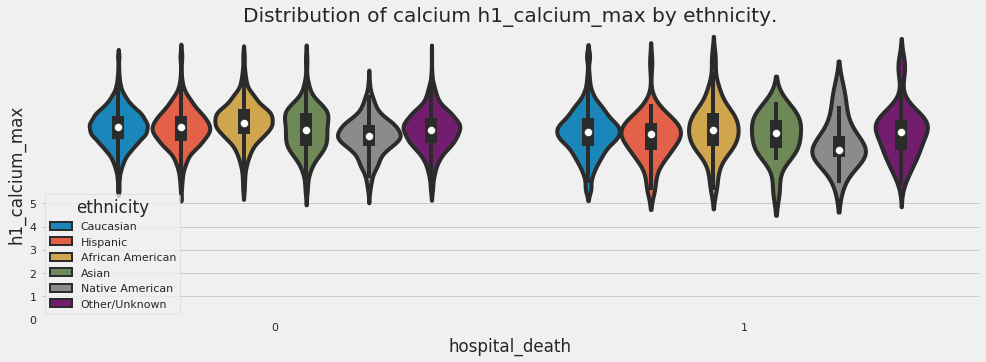

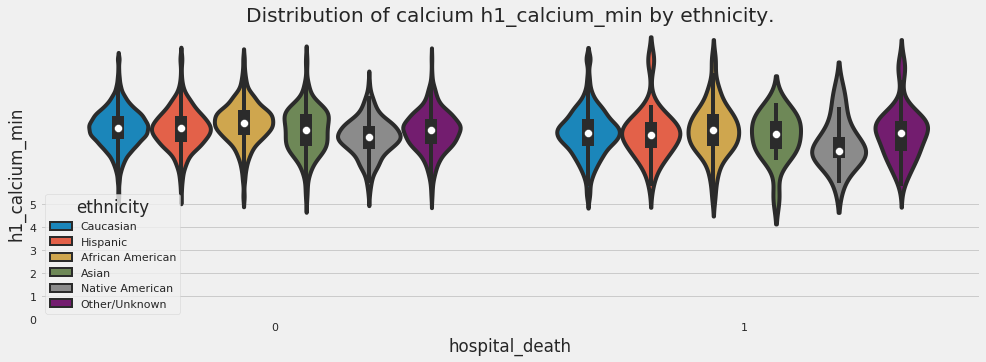

In [0]:
for i in calcium:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of calcium {} by ethnicity.'.format(i))
  plt.show()

##### Creatinine
Levels of creatinine in the blood reflect both the amount of muscle a person has and their amount of kidney function. Most men with normal kidney function have approximately 0.6 to 1.2 milligrams/deciliters (mg/dL) of creatinine.

Missing values:
 - 1h: 81.7%
 - 24: 11.1%

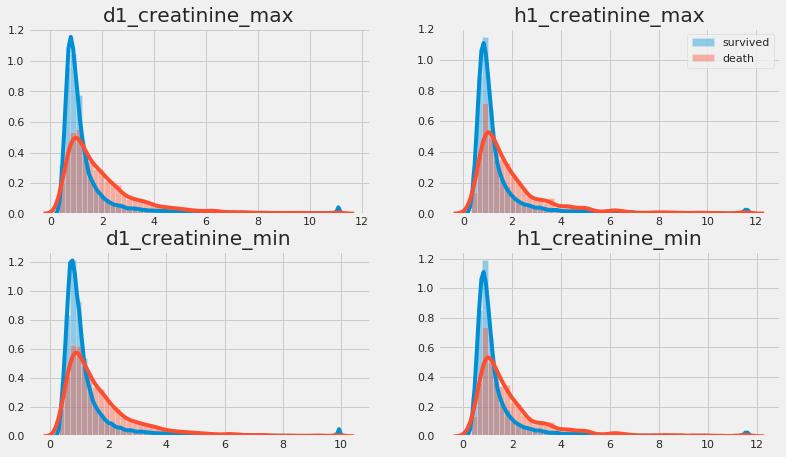

In [0]:
#check same measurements for first hour and first 24 hour
creatinine=['d1_creatinine_max','d1_creatinine_min','h1_creatinine_max','h1_creatinine_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),creatinine[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),creatinine[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])


###### Demo-Gender

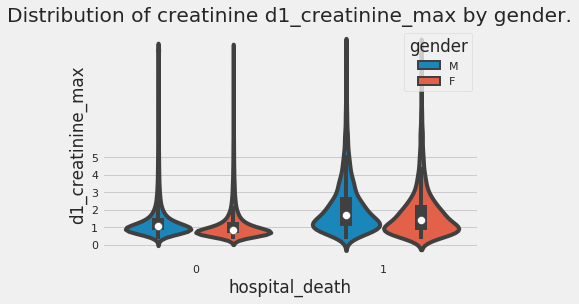

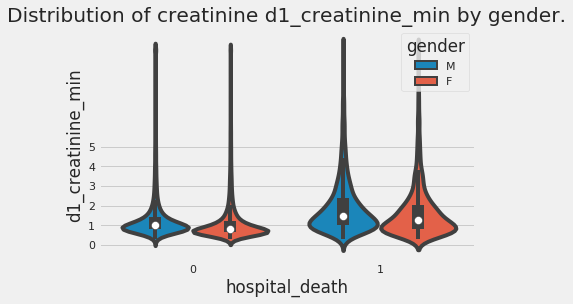

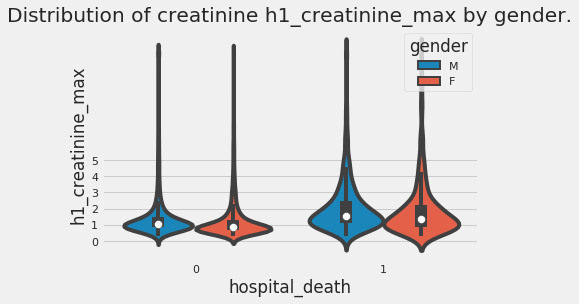

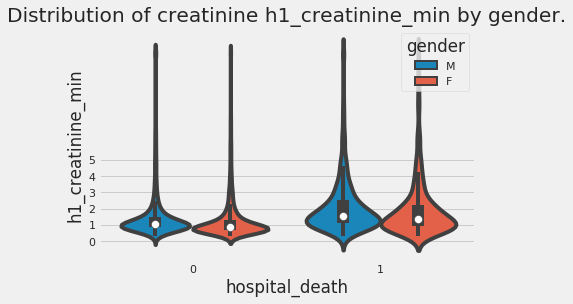

In [0]:
for i in creatinine:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of creatinine {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

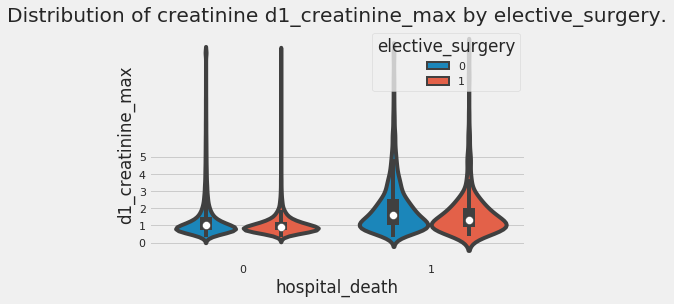

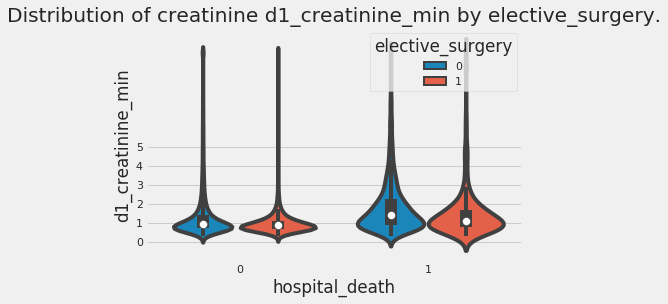

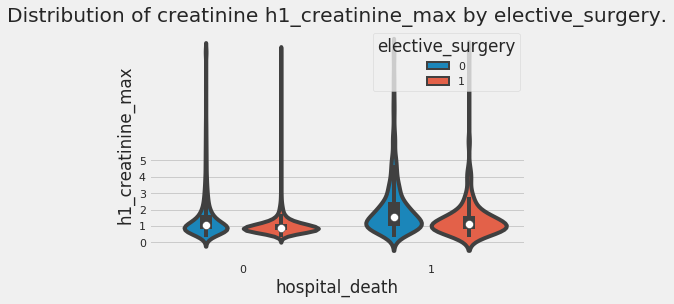

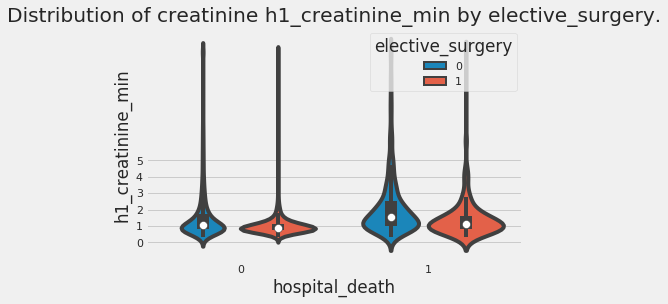

In [0]:
for i in creatinine:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of creatinine {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

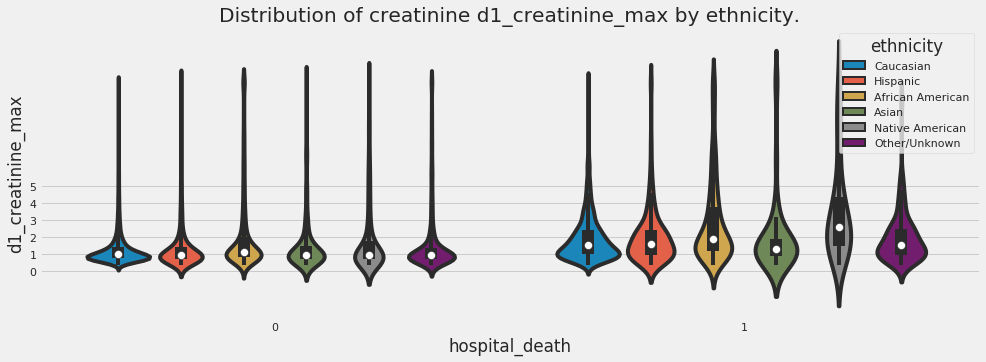

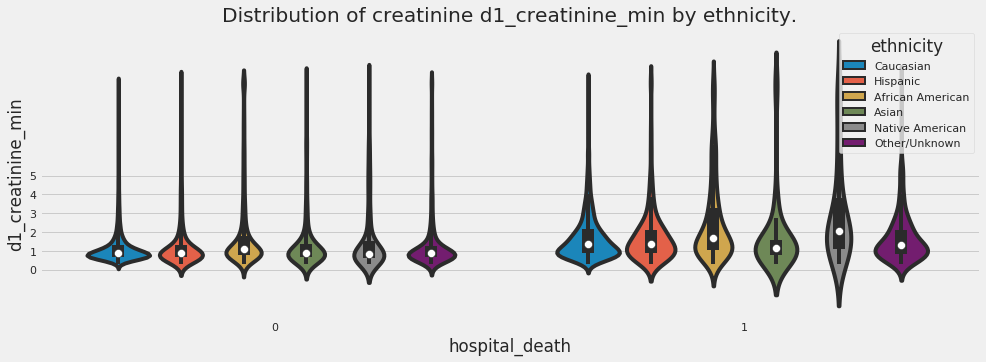

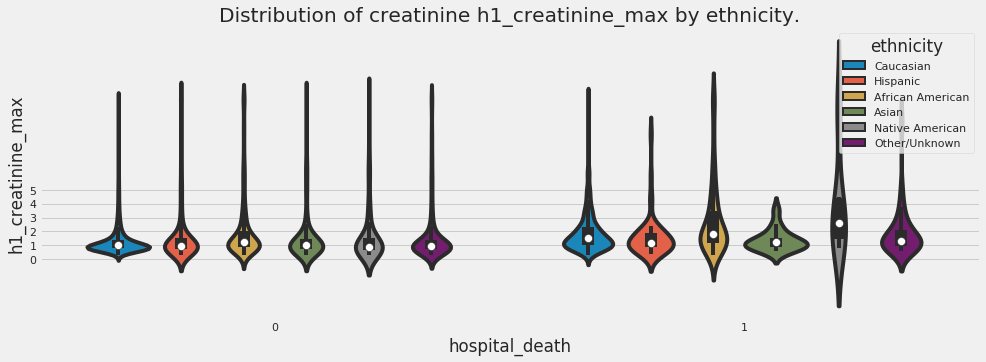

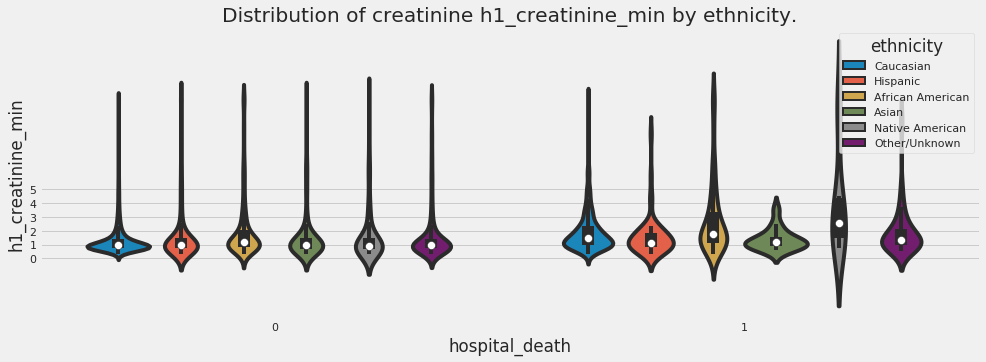

In [0]:
for i in creatinine:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of creatinine {} by ethnicity.'.format(i))
  plt.show()

###### creatinine_apache

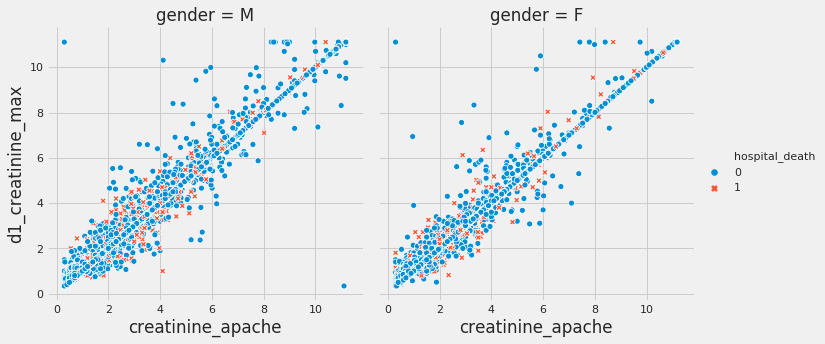

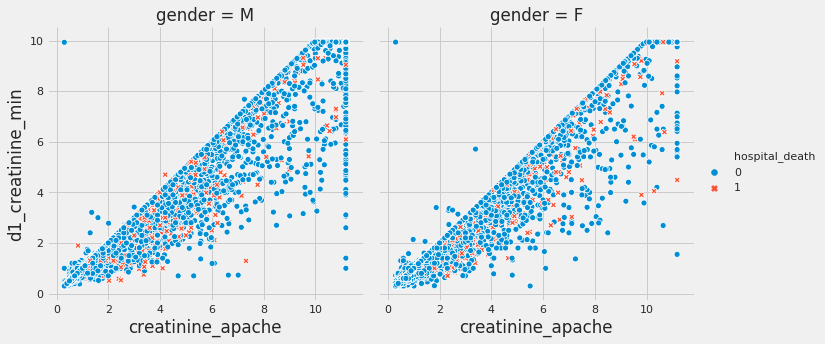

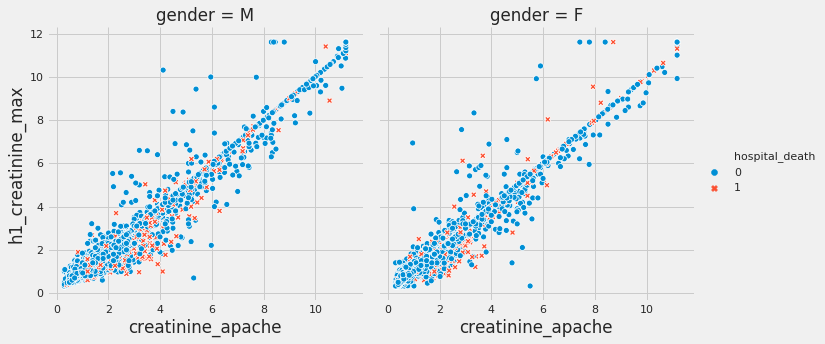

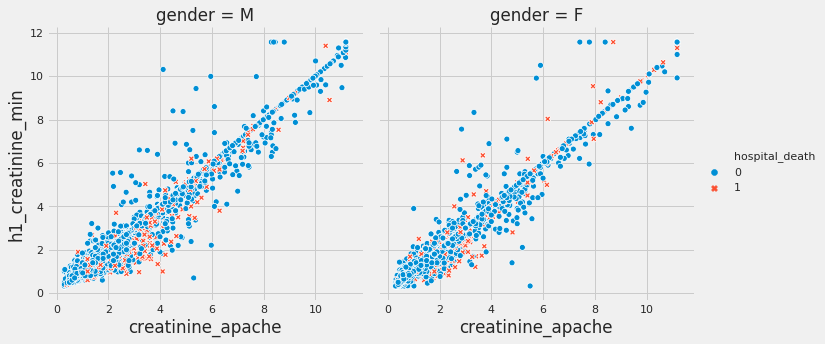

In [0]:
for i in creatinine:
  sns.relplot(x="creatinine_apache", y=i,col="gender", hue="hospital_death", style="hospital_death",kind="scatter", data=df)

##### Glucose
Normal blood sugar levels are less than 100 mg/dL after not eating (fasting) for at least eight hours. And they're less than 140 mg/dL two hours after eating. During the day, levels tend to be at their lowest just before meals.

Missing values:
 - 1h: 57.4%
 - 24: 6.3%

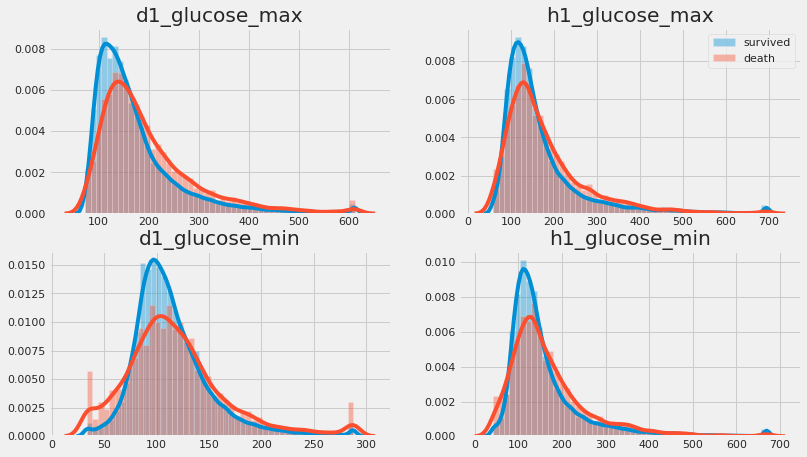

In [0]:
#check same measurements for first hour and first 24 hour
glucose=['d1_glucose_max','d1_glucose_min','h1_glucose_max','h1_glucose_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),glucose[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),glucose[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])


###### Demo-Gender

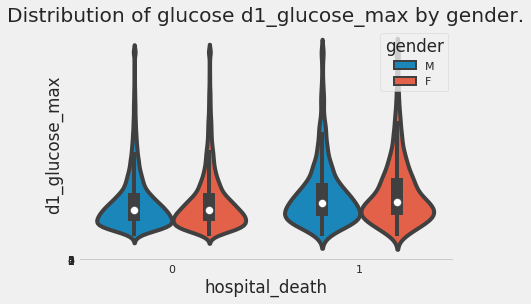

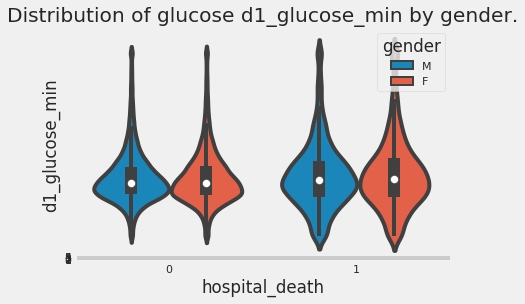

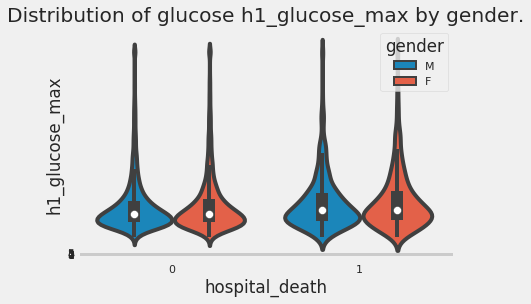

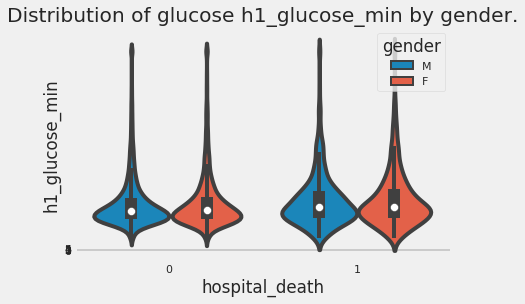

In [0]:
for i in glucose:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of glucose {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

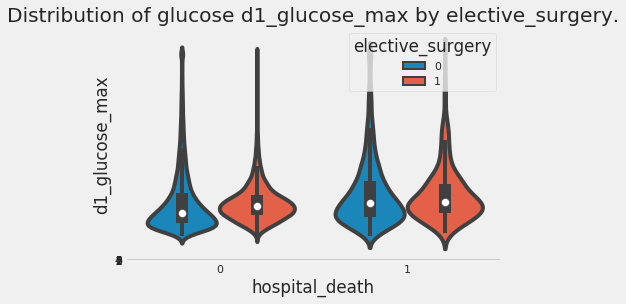

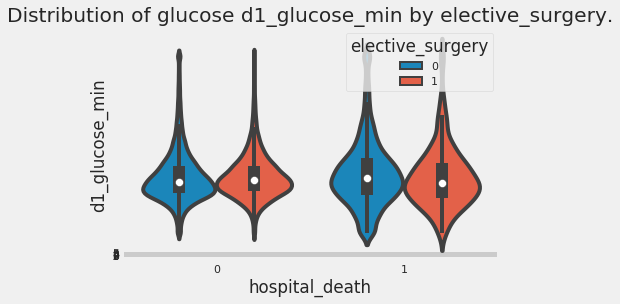

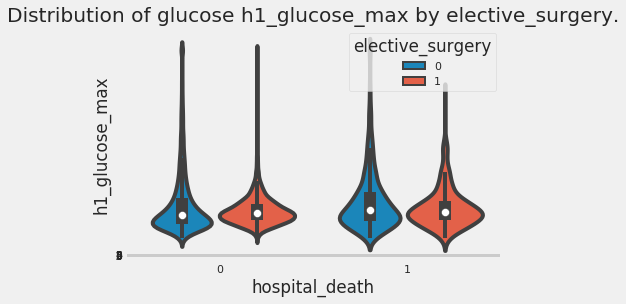

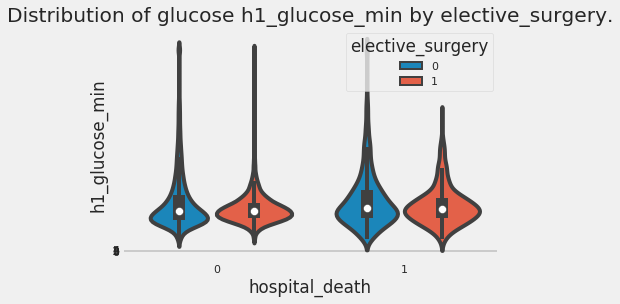

In [0]:
for i in glucose:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of glucose {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

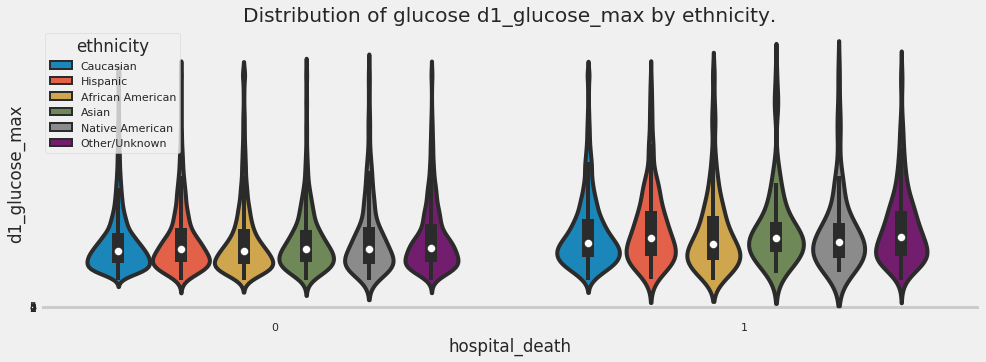

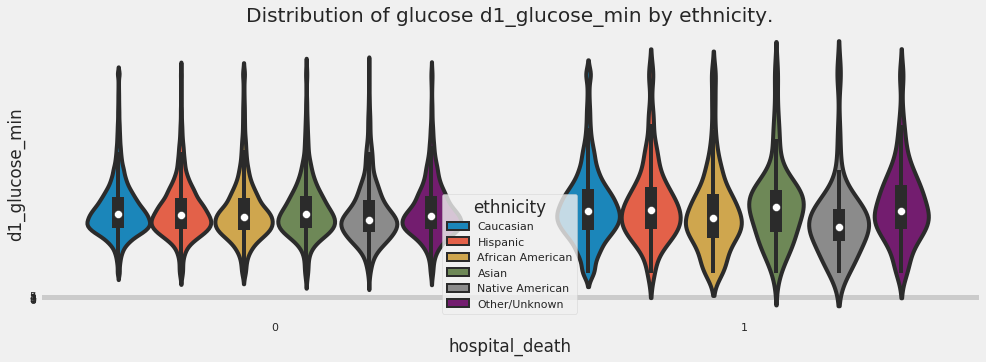

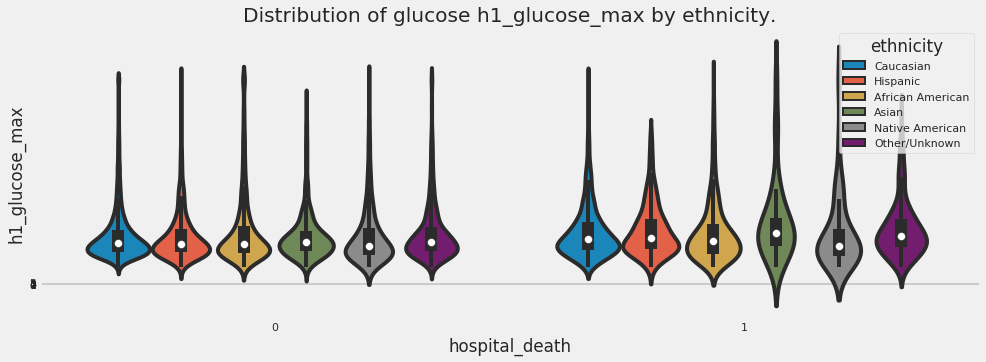

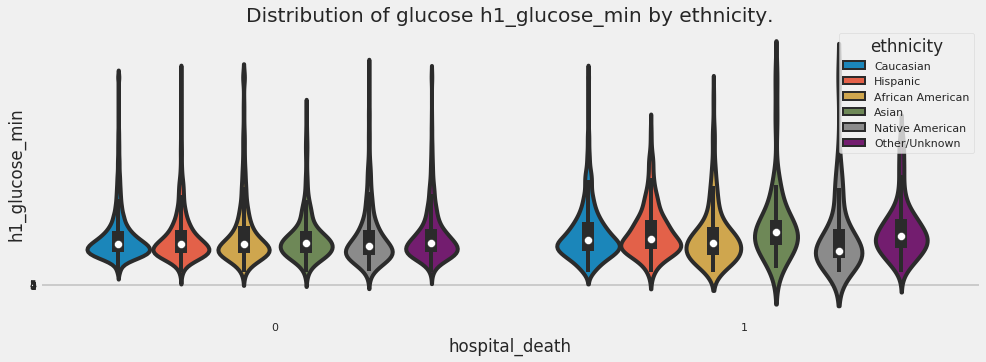

In [0]:
for i in glucose:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of glucose {} by ethnicity.'.format(i))
  plt.show()

##### hco3
A high level of bicarbonate in your blood can be from metabolic alkalosis, a condition that causes a pH increase in tissue. Metabolic alkalosis can happen from a loss of acid from your body, such as through vomiting and dehydration.

Missing values:
 - 1h: 83.0%
 - 24: 16.4%

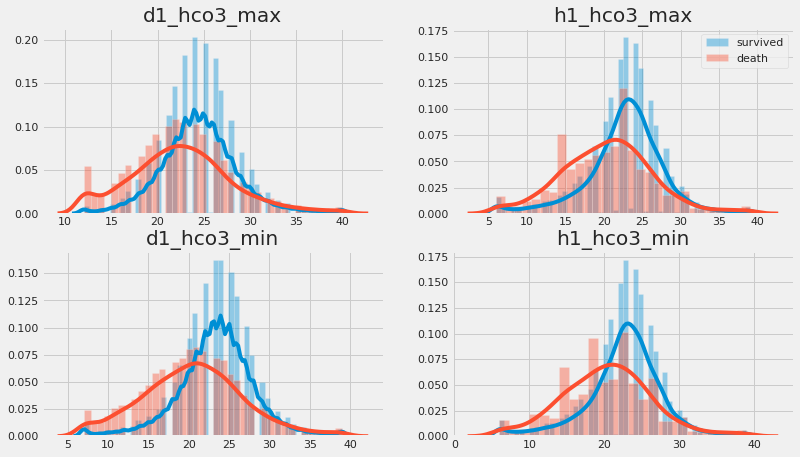

In [0]:
#check same measurements for first hour and first 24 hour
hco3=['d1_hco3_max','d1_hco3_min','h1_hco3_max','h1_hco3_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),hco3[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),hco3[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])


###### Demo-Gender

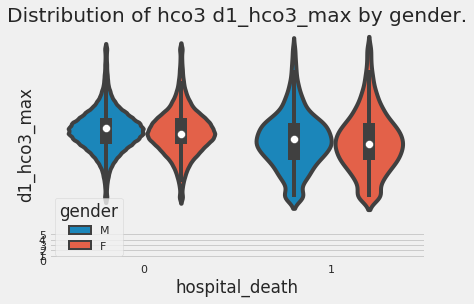

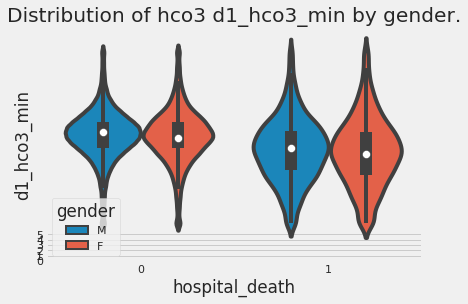

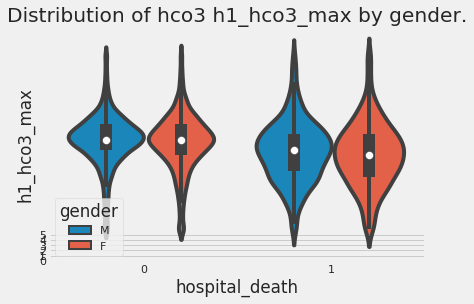

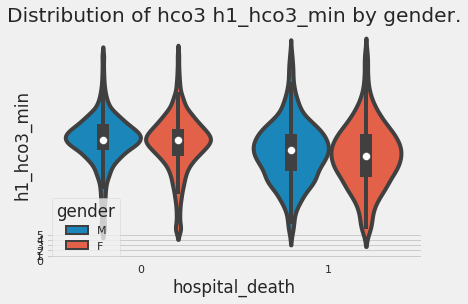

In [0]:
for i in hco3:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of hco3 {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

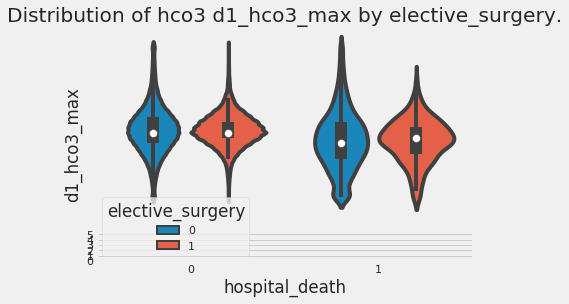

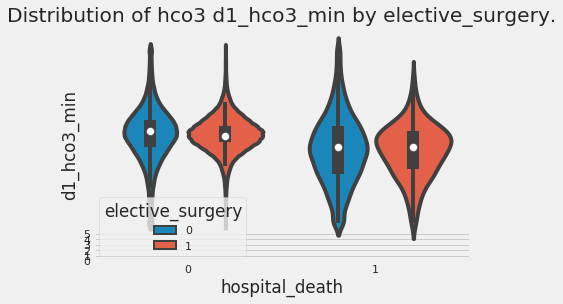

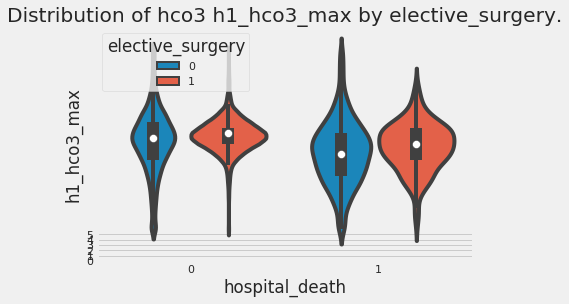

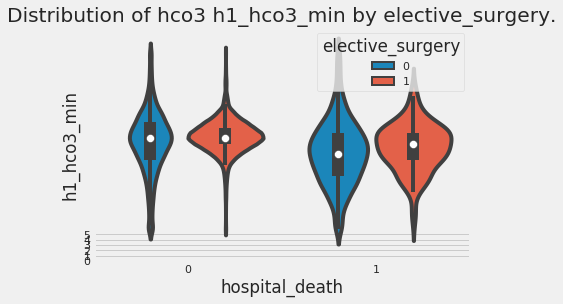

In [0]:
for i in hco3:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of hco3 {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

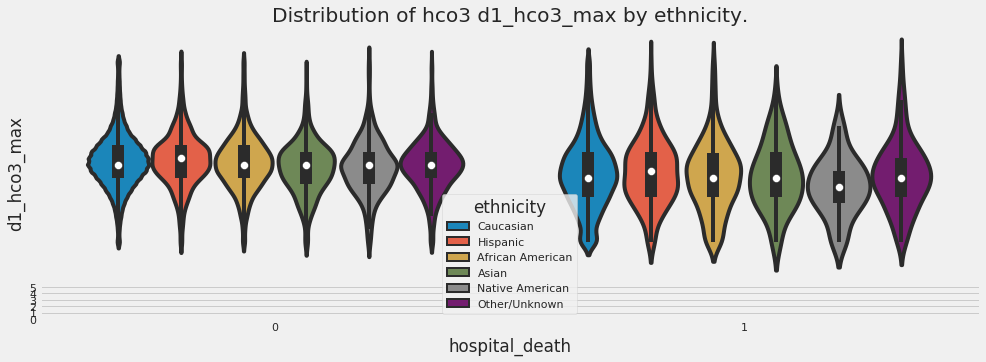

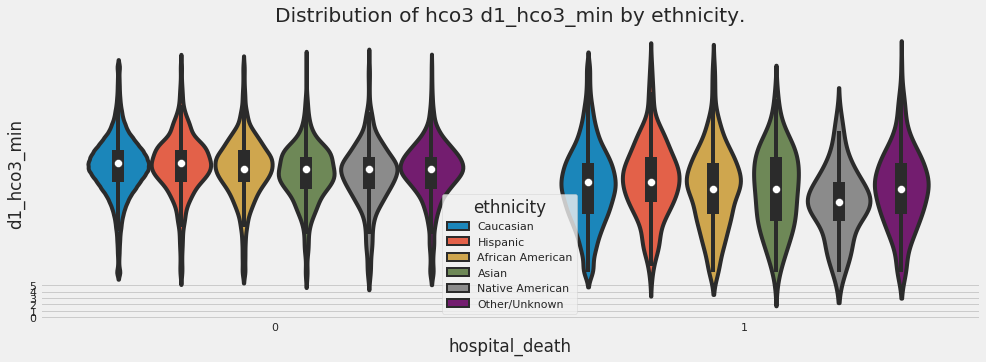

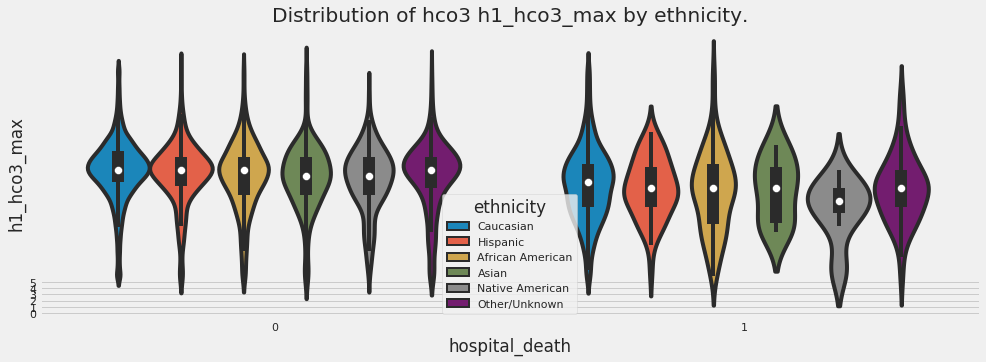

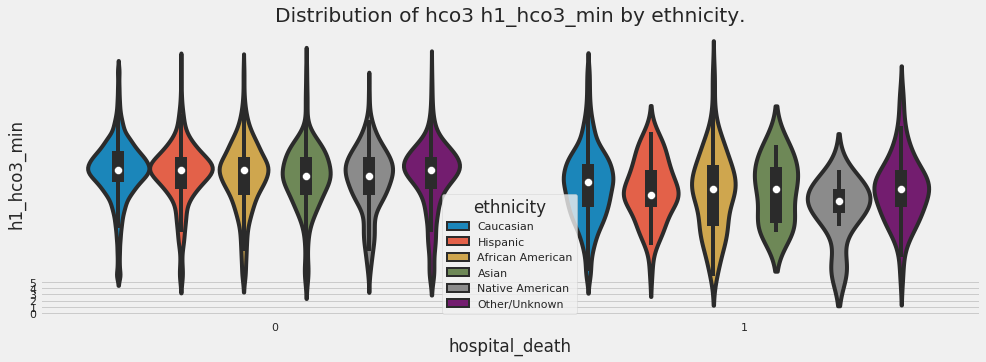

In [0]:
for i in hco3:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of hco3 {} by ethnicity.'.format(i))
  plt.show()

##### Hemaglobin
The normal range for hemoglobin is: For men, 13.5 to 17.5 grams per deciliter. For women, 12.0 to 15.5 grams per deciliter.

Missing values:
 - 1h: 79.7%
 - 24: 13.2%

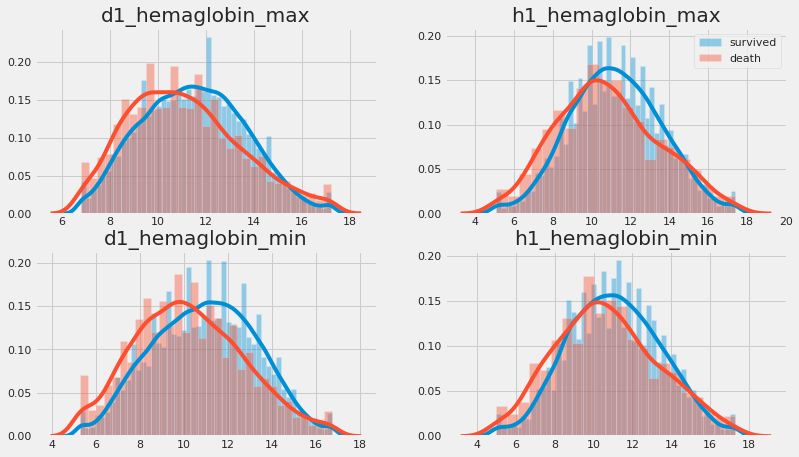

In [0]:
#check same measurements for first hour and first 24 hour
hemaglobin=['d1_hemaglobin_max','d1_hemaglobin_min','h1_hemaglobin_max','h1_hemaglobin_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),hemaglobin[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),hemaglobin[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])


###### Demo-Gender

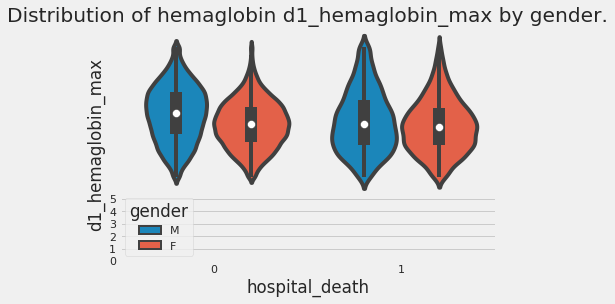

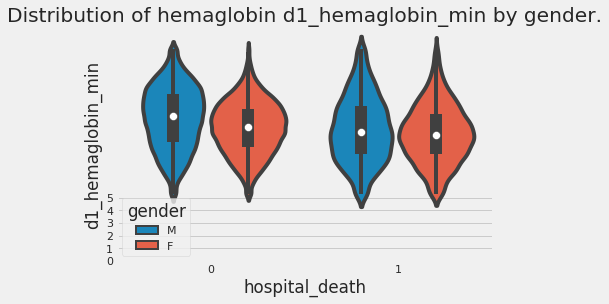

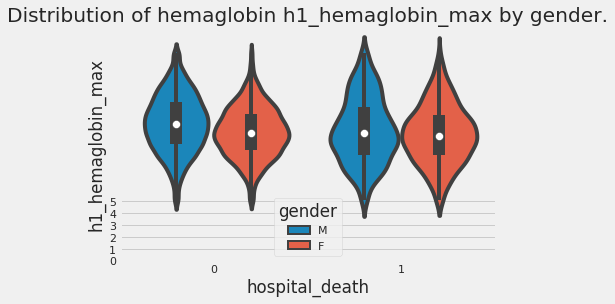

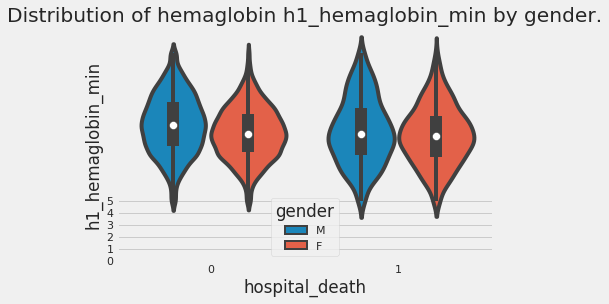

In [0]:
for i in hemaglobin:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of hemaglobin {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

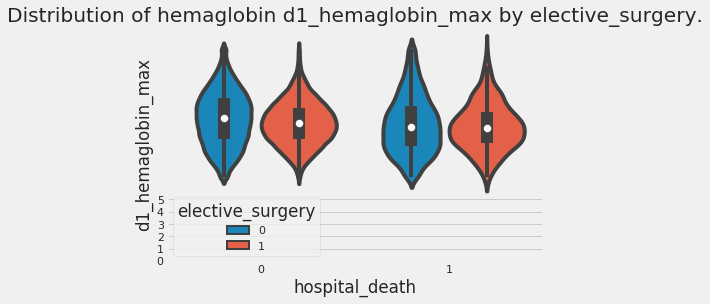

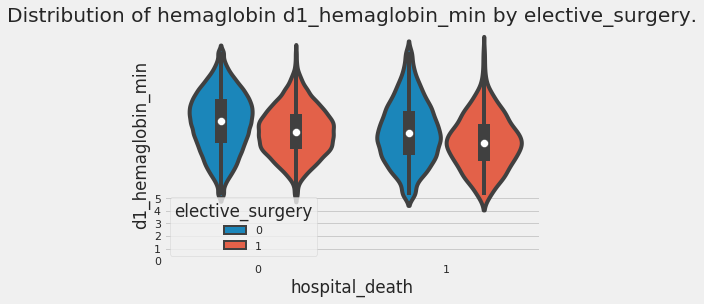

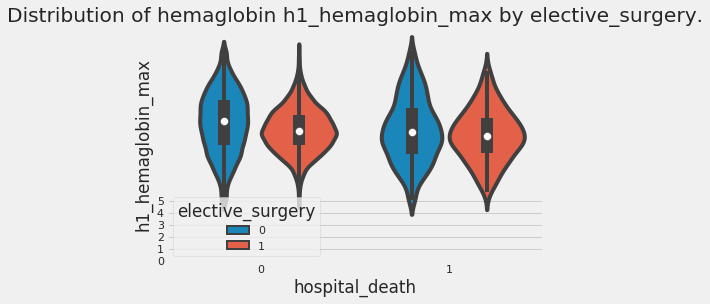

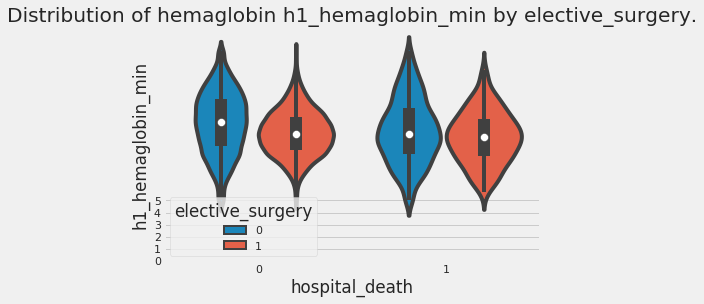

In [0]:
for i in hemaglobin:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of hemaglobin {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

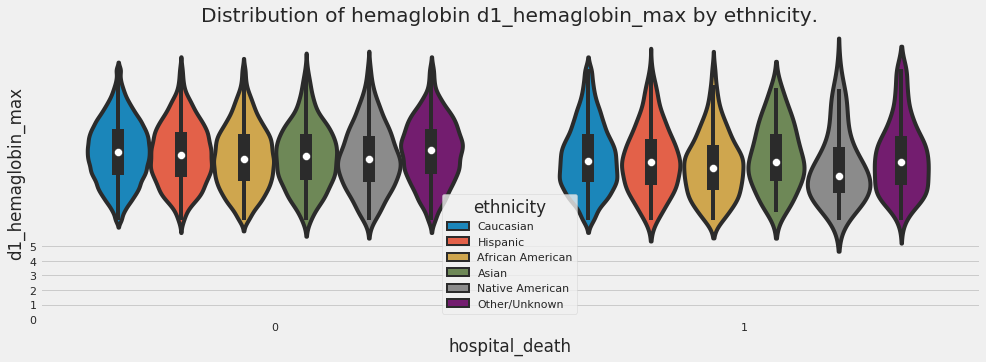

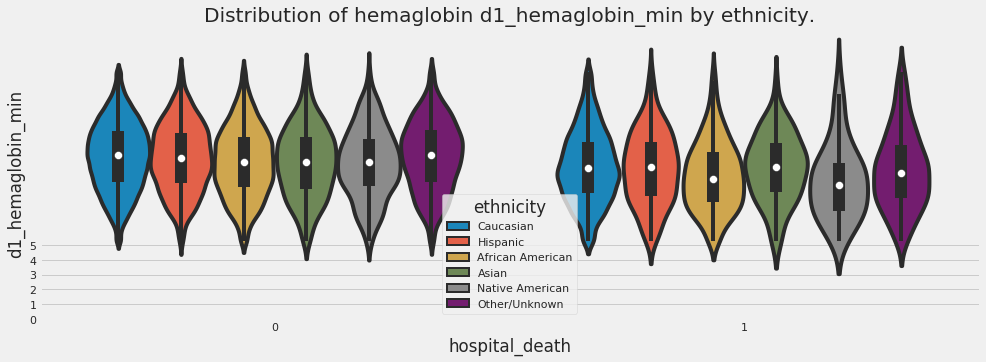

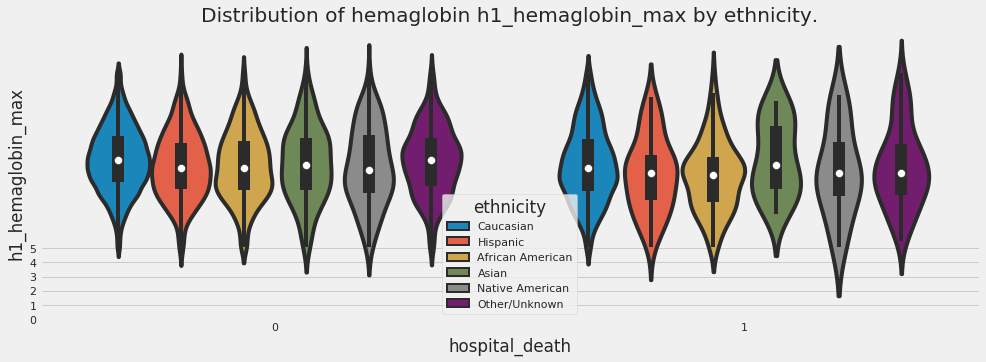

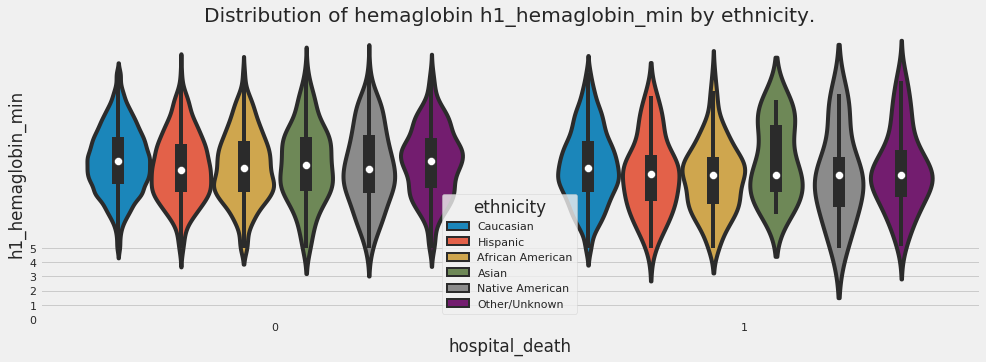

In [0]:
for i in hemaglobin:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of hemaglobin {} by ethnicity.'.format(i))
  plt.show()

##### Hematocrit
This is the ratio of the volume of red cells to the volume of whole blood. Normal range for hematocrit is different between the sexes and is approximately 45% to 52% for men and 37% to 48% for women.

Missing values:
 - 1h: 80.0%
 - 24: 12.7%

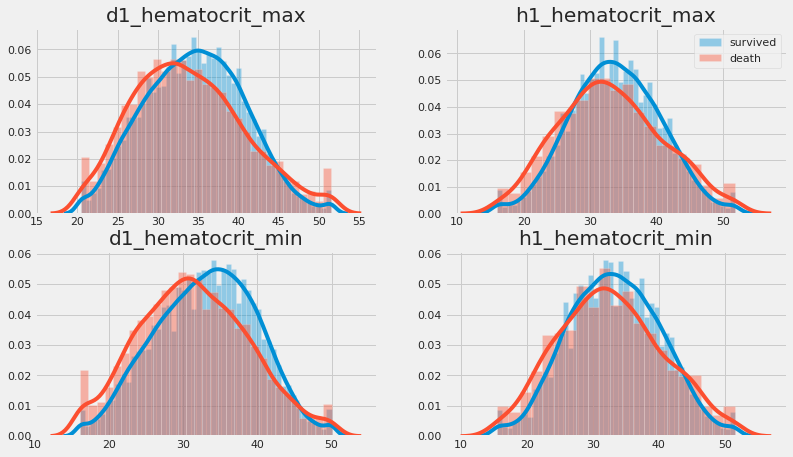

In [0]:
#check same measurements for first hour and first 24 hour
hematocrit=['d1_hematocrit_max','d1_hematocrit_min','h1_hematocrit_max','h1_hematocrit_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),hematocrit[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),hematocrit[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])


###### Demo-Gender

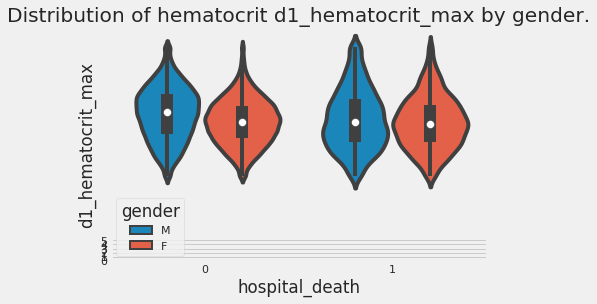

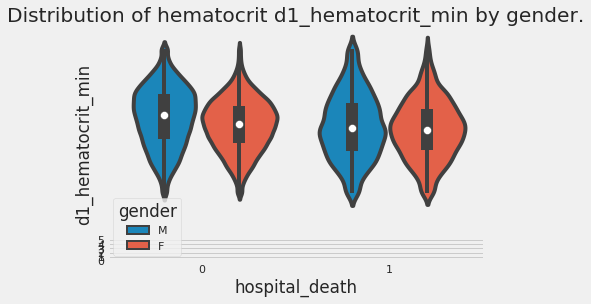

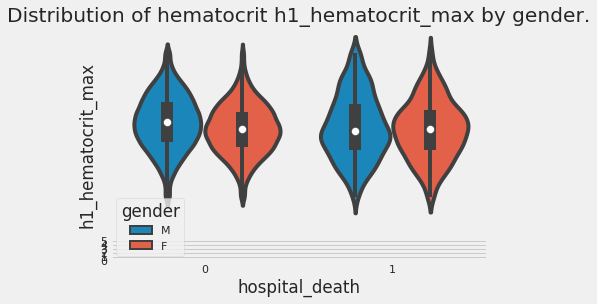

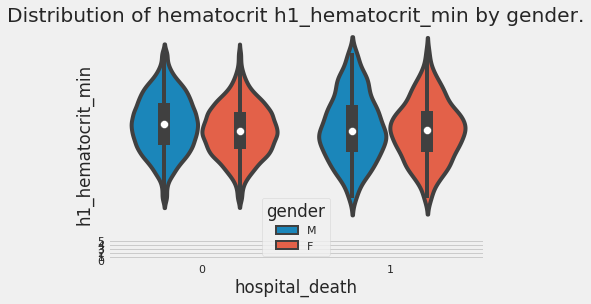

In [0]:
for i in hematocrit:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of hematocrit {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

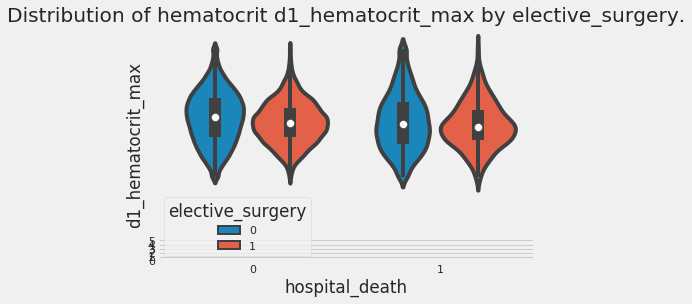

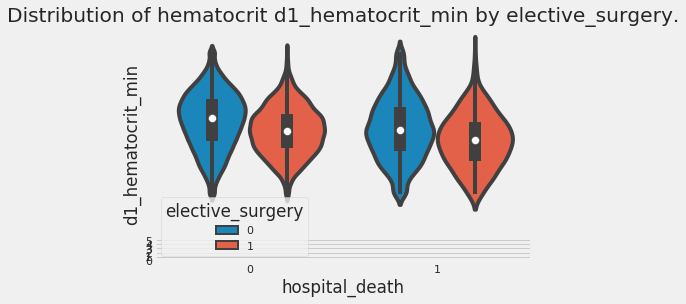

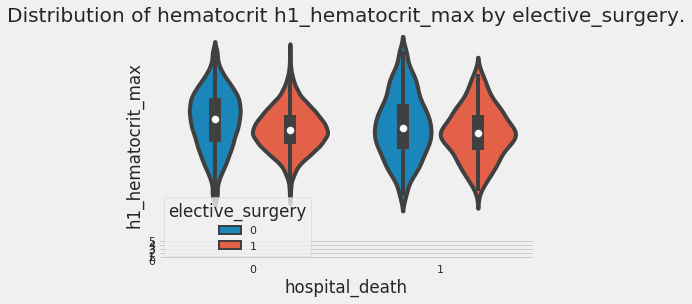

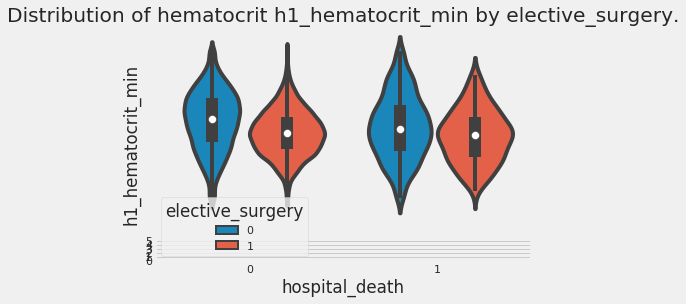

In [0]:
for i in hematocrit:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of hematocrit {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

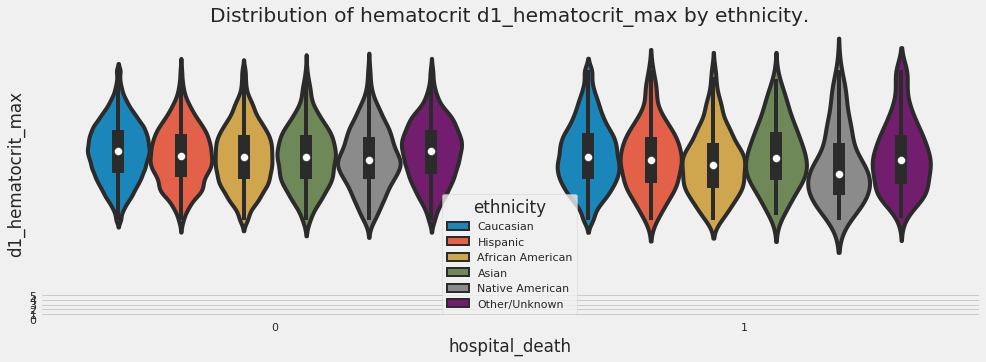

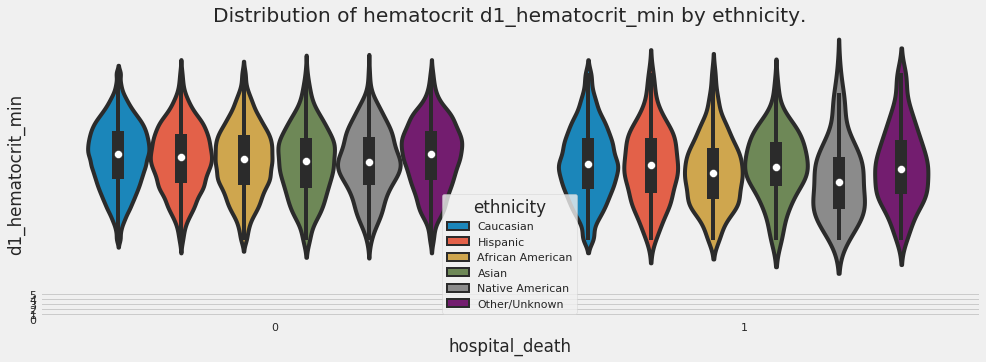

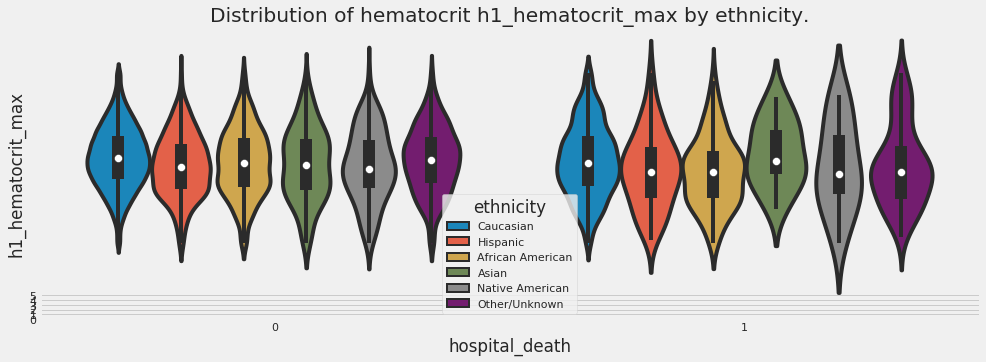

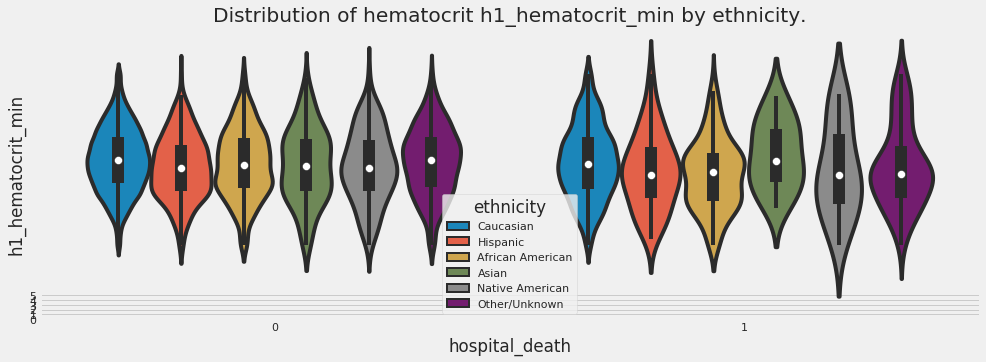

In [0]:
for i in hematocrit:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of hematocrit {} by ethnicity.'.format(i))
  plt.show()

##### inr
In healthy people an INR of 1.1 or below is considered normal. An INR range of 2.0 to 3.0 is generally an effective therapeutic range for people taking warfarin for disorders such as atrial fibrillation or a blood clot in the leg or lung.

Missing values:
 - 1h: 63.2%
 - 24: 63.2%

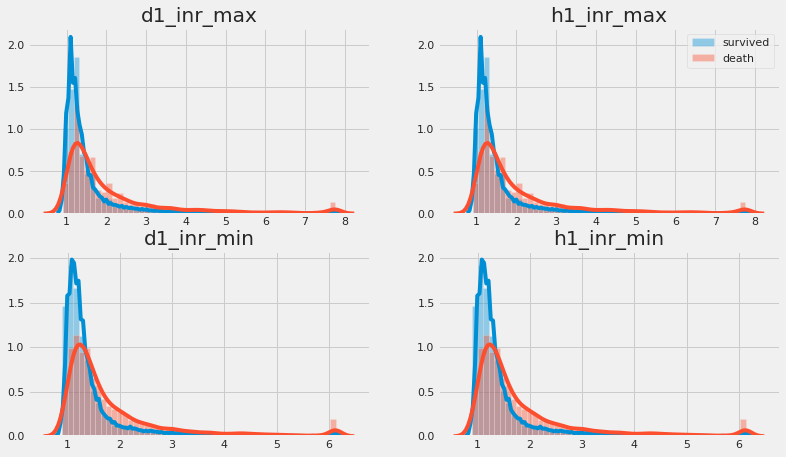

In [0]:
#check same measurements for first hour and first 24 hour
inr=['d1_inr_max','d1_inr_min','h1_inr_max','h1_inr_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),inr[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),inr[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])


###### Demo-Gender

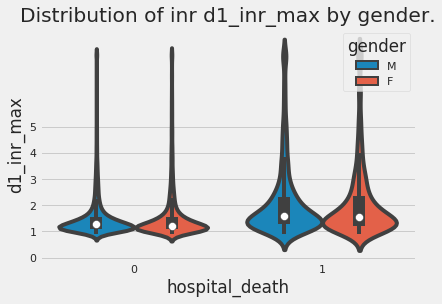

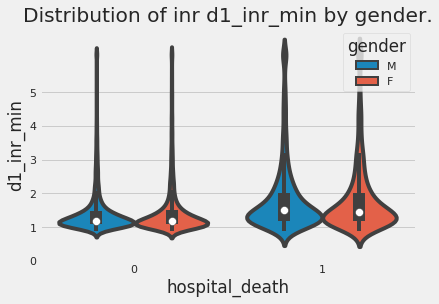

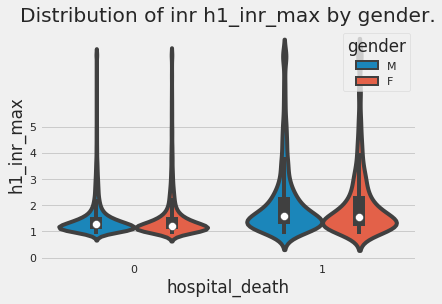

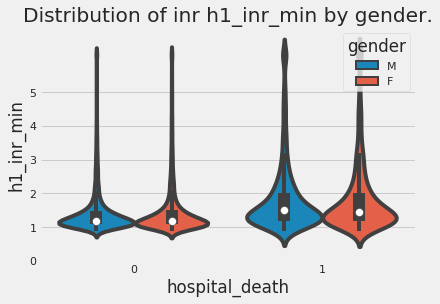

In [0]:
for i in inr:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of inr {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

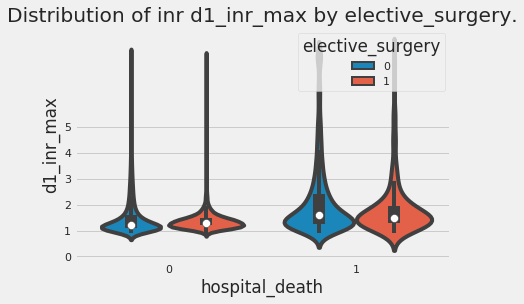

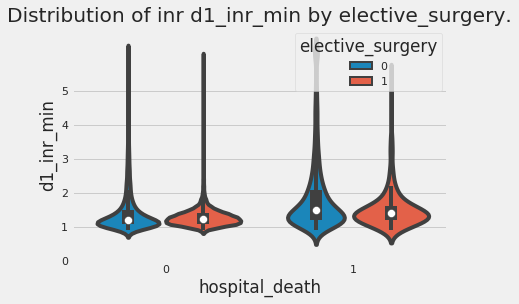

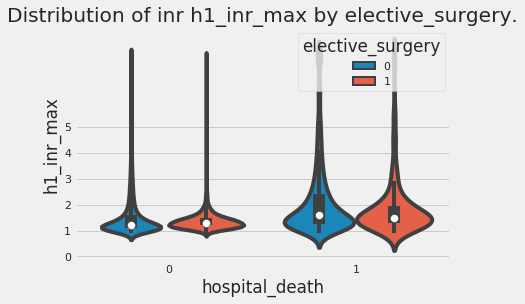

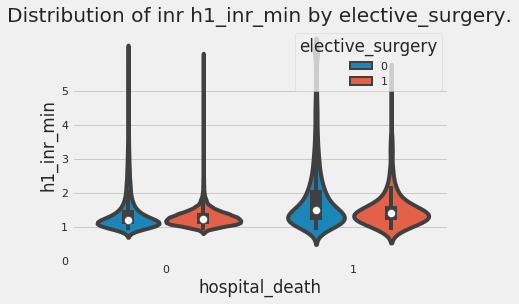

In [0]:
for i in inr:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of inr {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

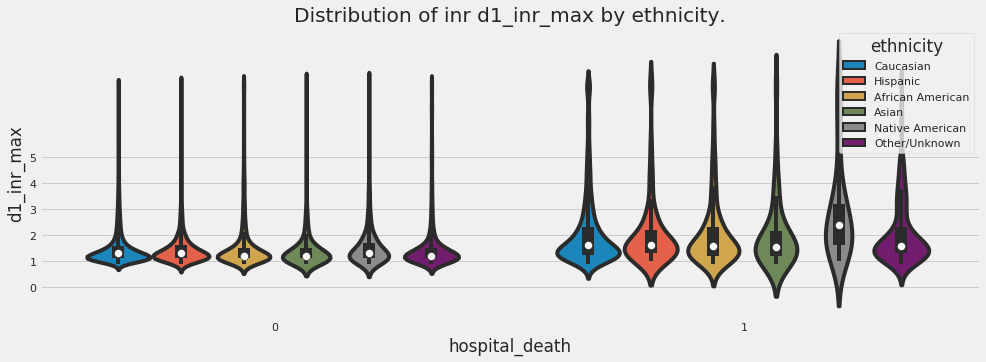

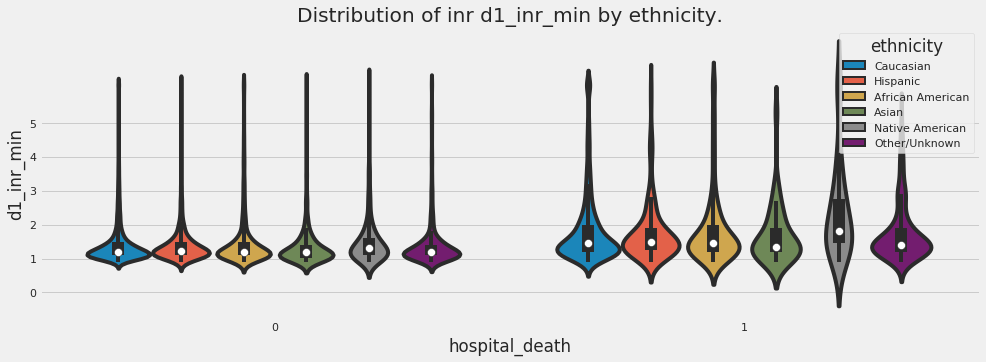

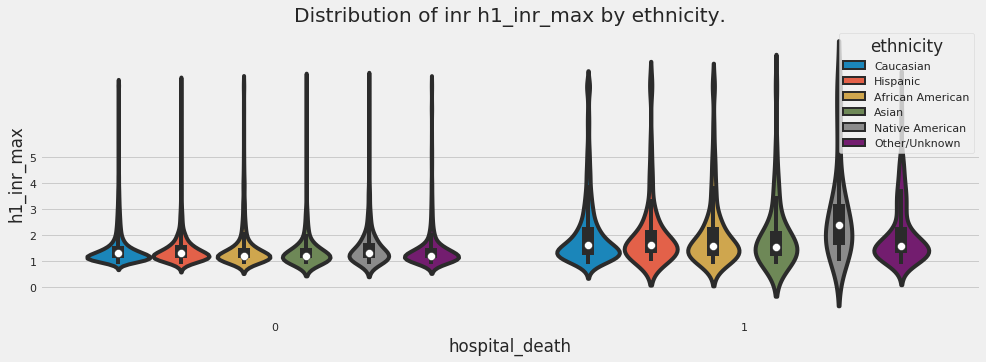

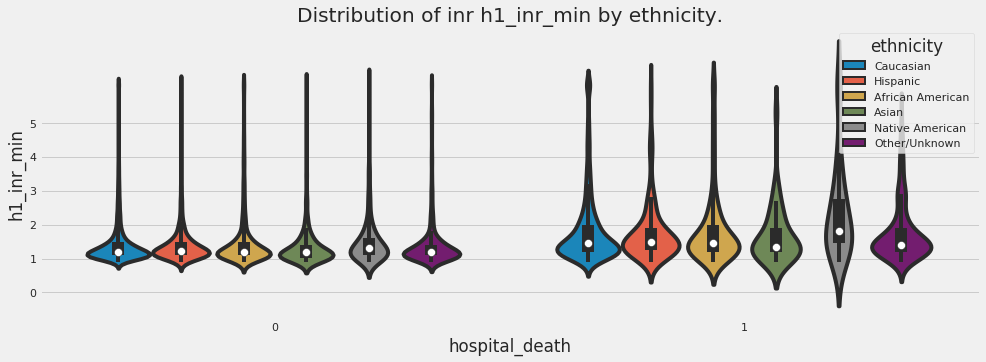

In [0]:
for i in inr:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of inr {} by ethnicity.'.format(i))
  plt.show()

##### Lactate
A normal blood lactate level is 0.5-1 mmol/L. Hyperlactatemia is defined as a persistent, mild to moderately elevated (2-4 mmol/L) lactate level without metabolic acidosis. This can occur with adequate tissue perfusion and tissue oxygenation

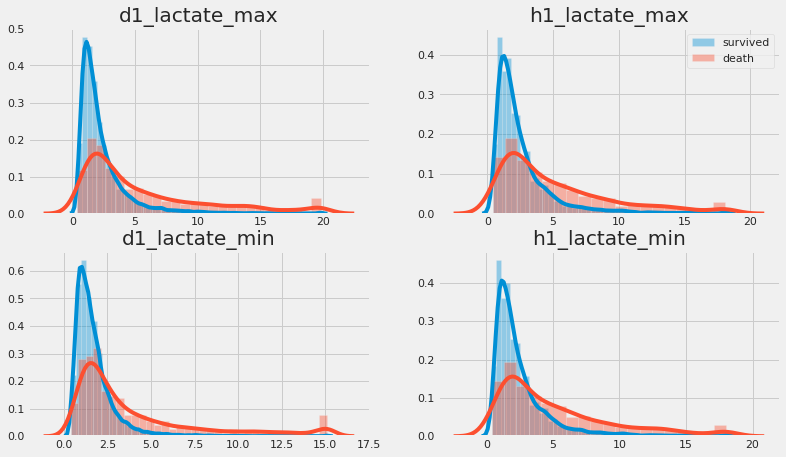

In [0]:
#check same measurements for first hour and first 24 hour
lactate=['d1_lactate_max','d1_lactate_min','h1_lactate_max','h1_lactate_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),lactate[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),lactate[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])


###### Demo-Gender

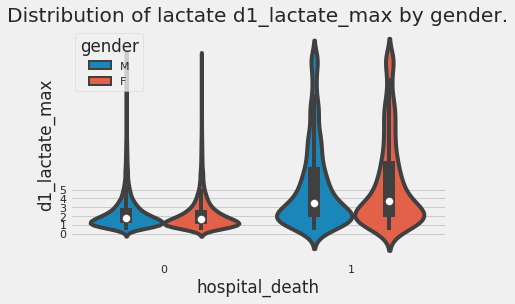

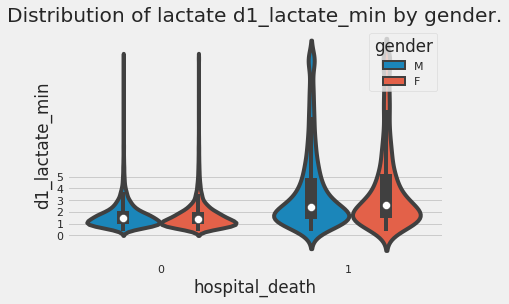

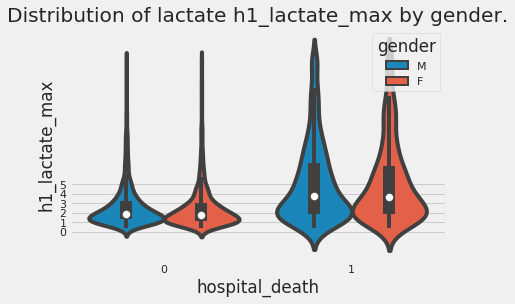

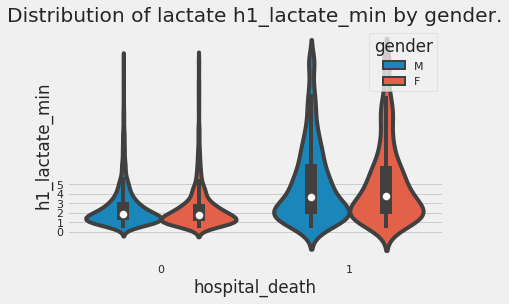

In [0]:
for i in lactate:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of lactate {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

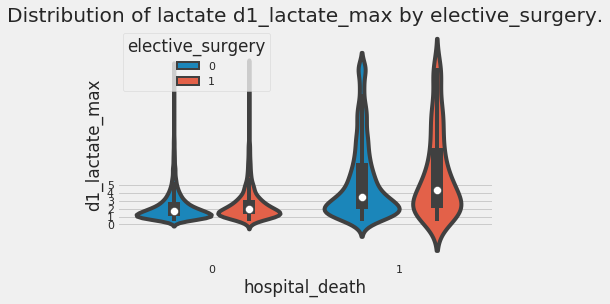

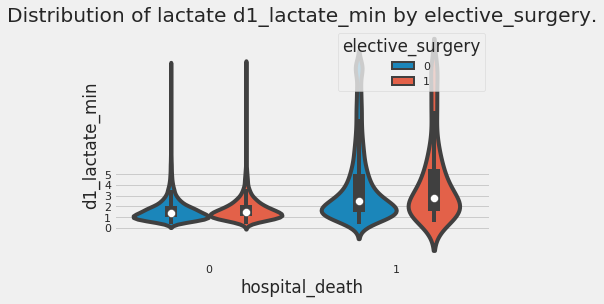

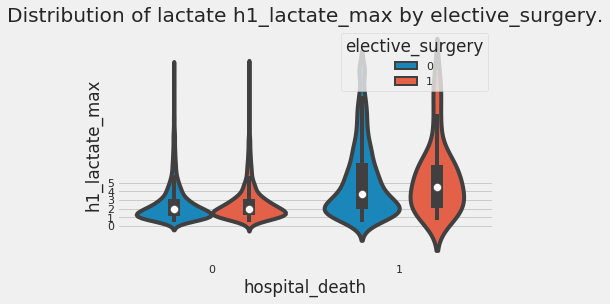

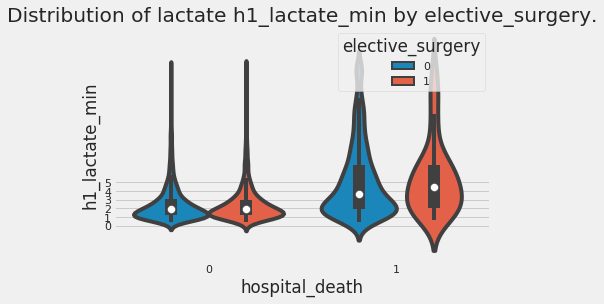

In [0]:
for i in lactate:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of lactate {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

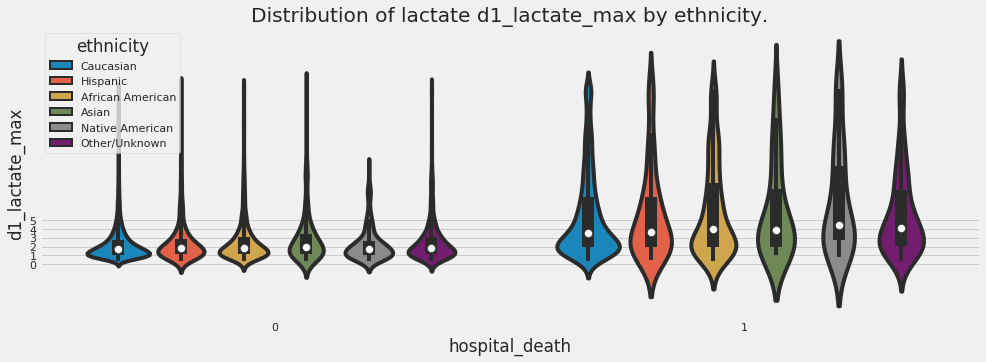

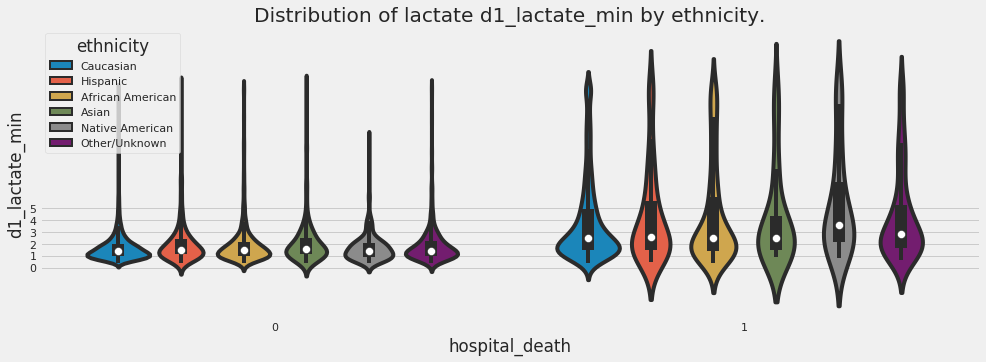

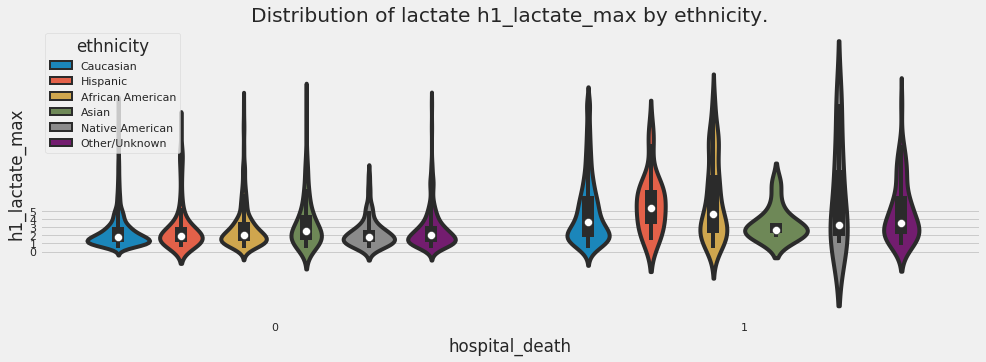

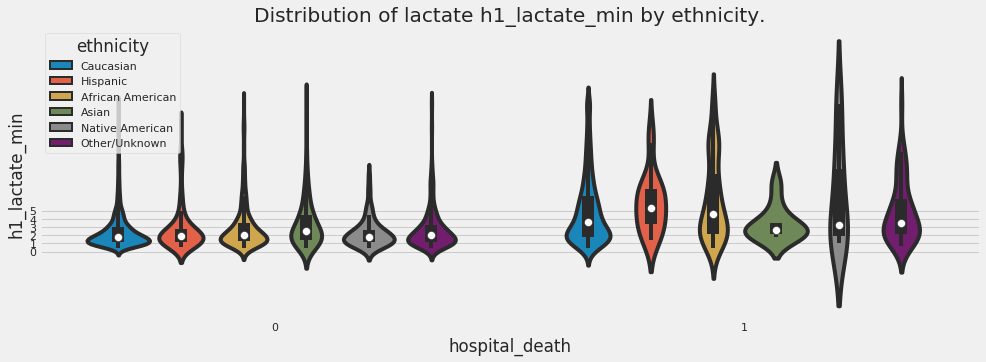

In [0]:
for i in lactate:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of lactate {} by ethnicity.'.format(i))
  plt.show()

##### Platelets

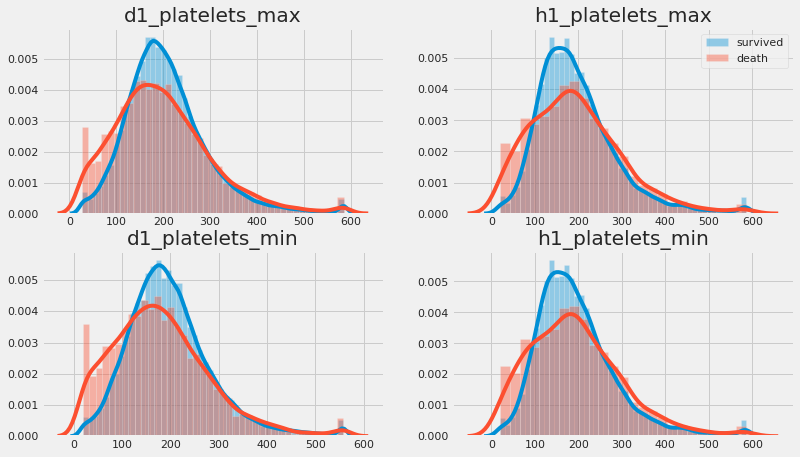

In [0]:
#check same measurements for first hour and first 24 hour
platelets=['d1_platelets_max','d1_platelets_min','h1_platelets_max','h1_platelets_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),platelets[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),platelets[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])

###### Demo-Gender

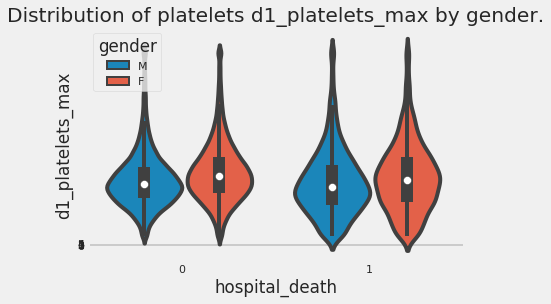

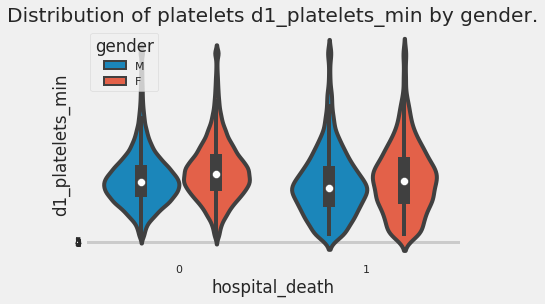

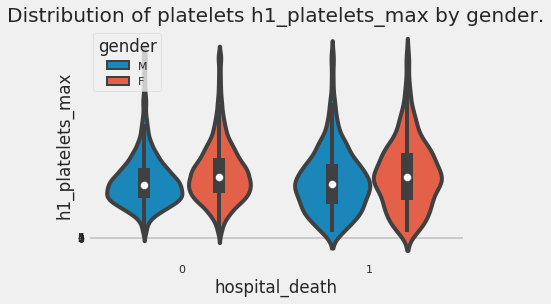

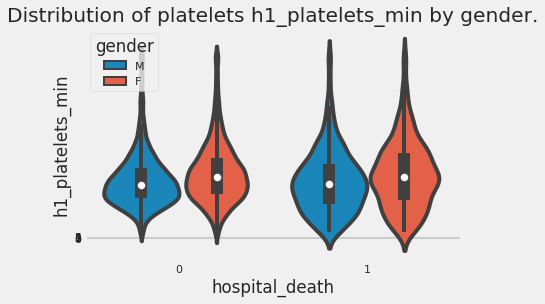

In [0]:
for i in platelets:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of platelets {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

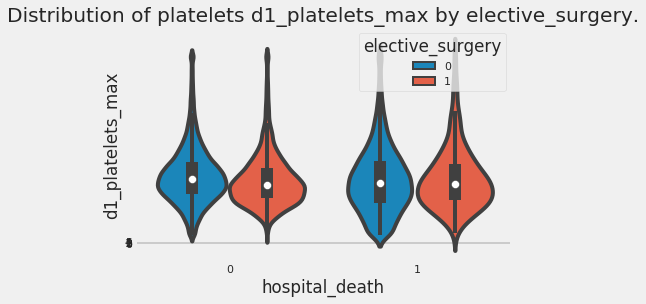

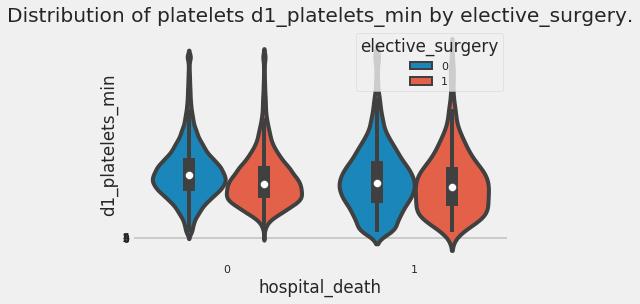

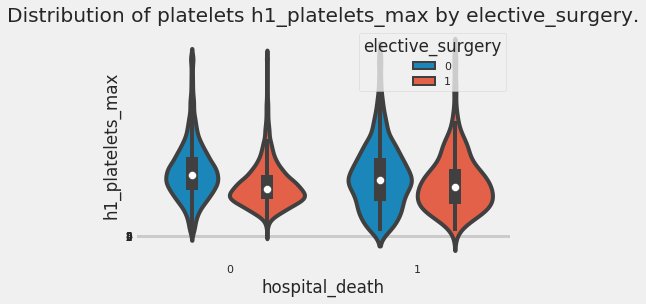

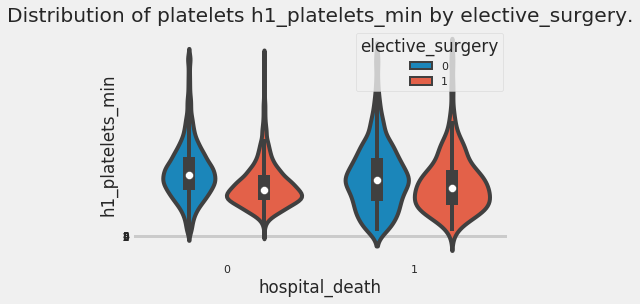

In [0]:
for i in platelets:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of platelets {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

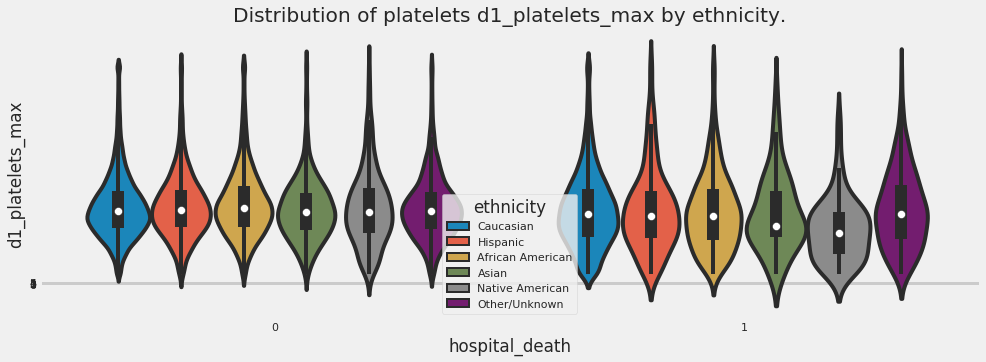

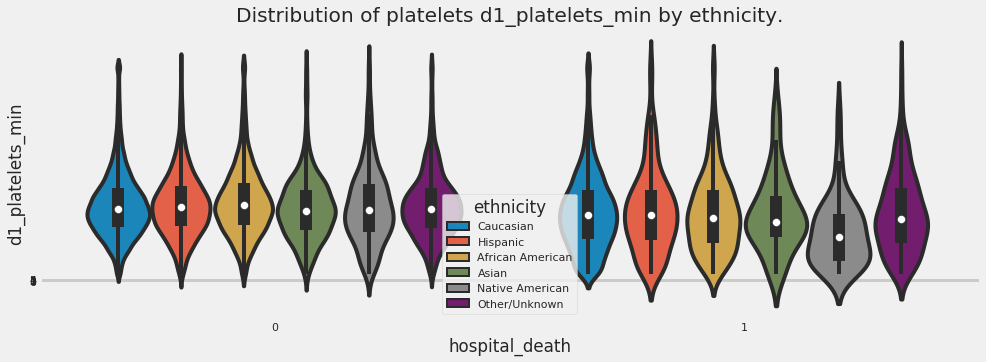

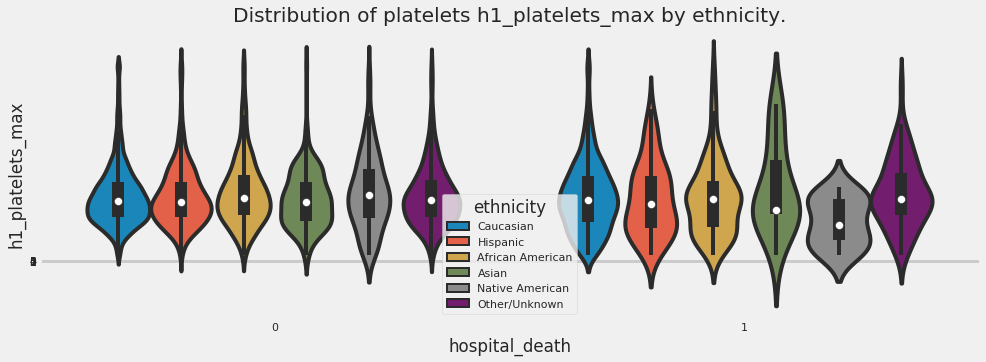

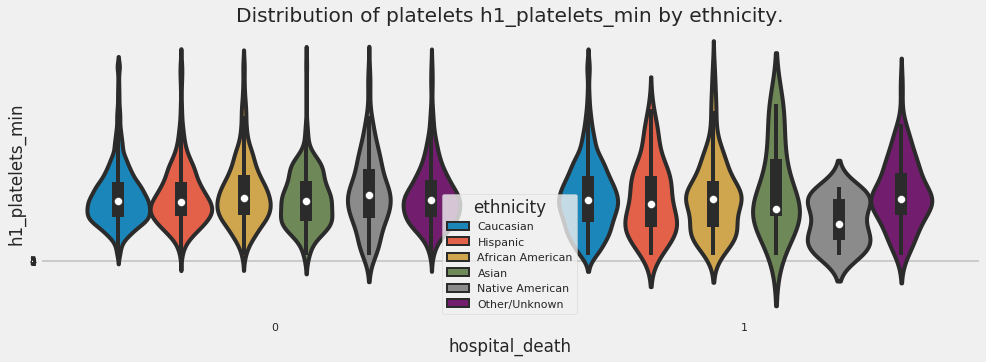

In [0]:
for i in platelets:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of platelets {} by ethnicity.'.format(i))
  plt.show()

##### Potassium

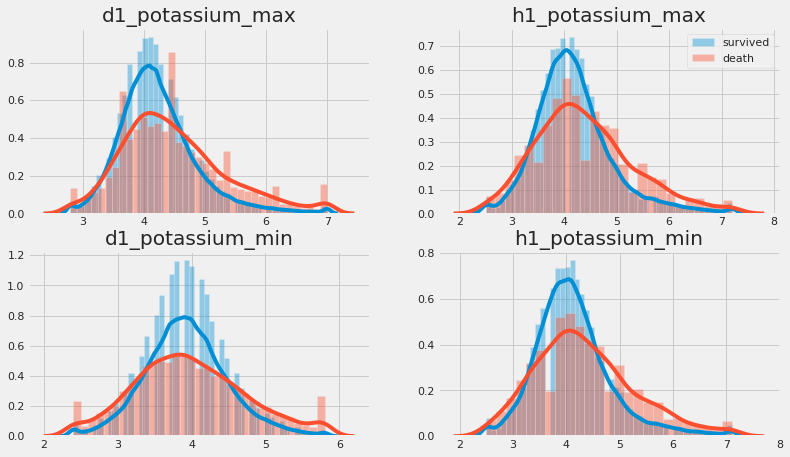

In [0]:
#check same measurements for first hour and first 24 hour
potassium=['d1_potassium_max','d1_potassium_min','h1_potassium_max','h1_potassium_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),potassium[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),potassium[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])

###### Demo-Gender

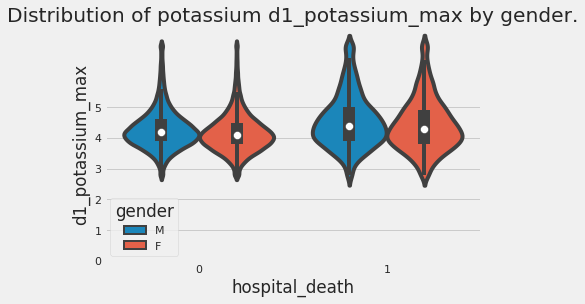

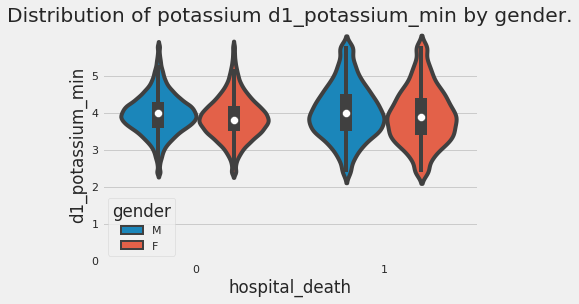

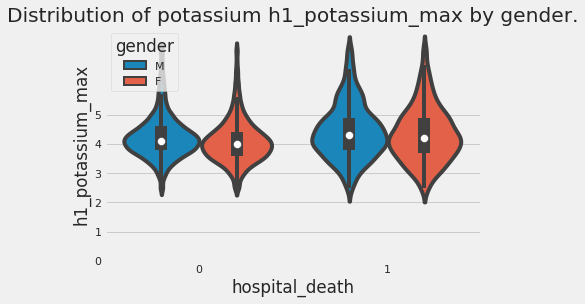

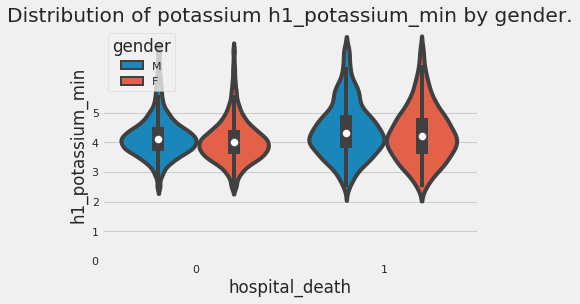

In [0]:
for i in potassium:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of potassium {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

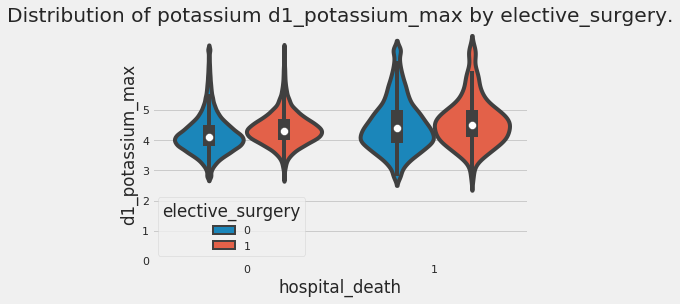

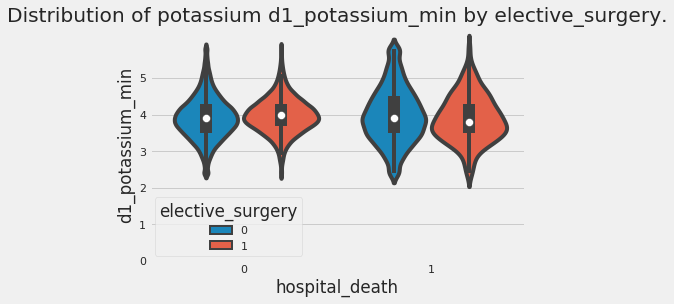

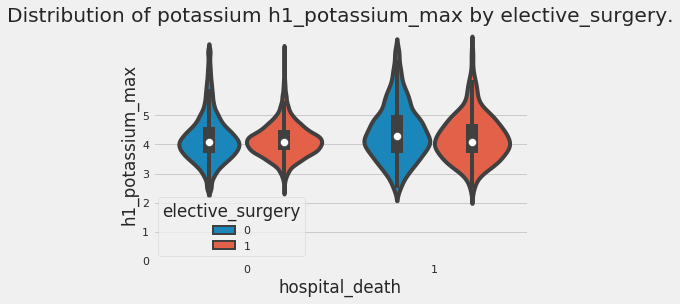

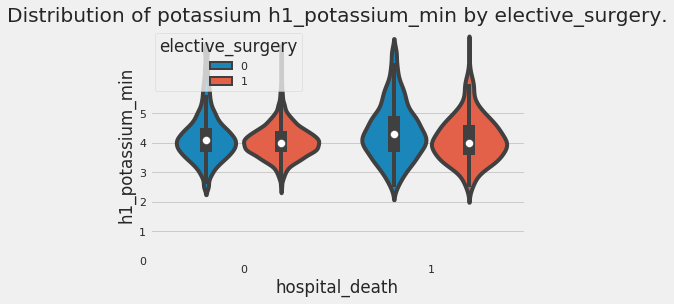

In [0]:
for i in potassium:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of potassium {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

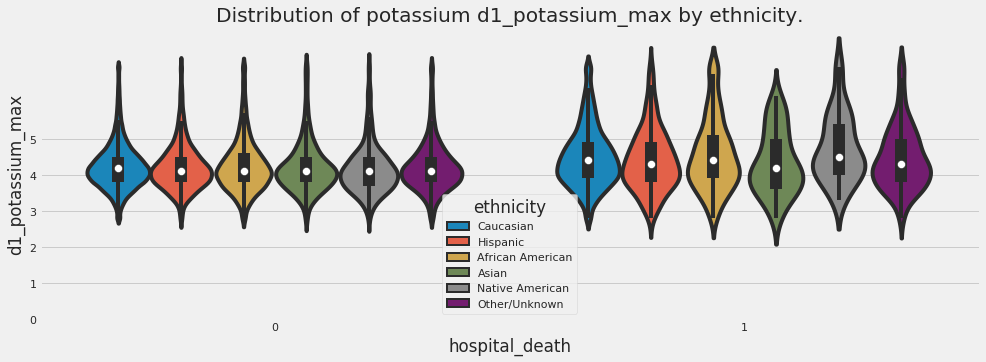

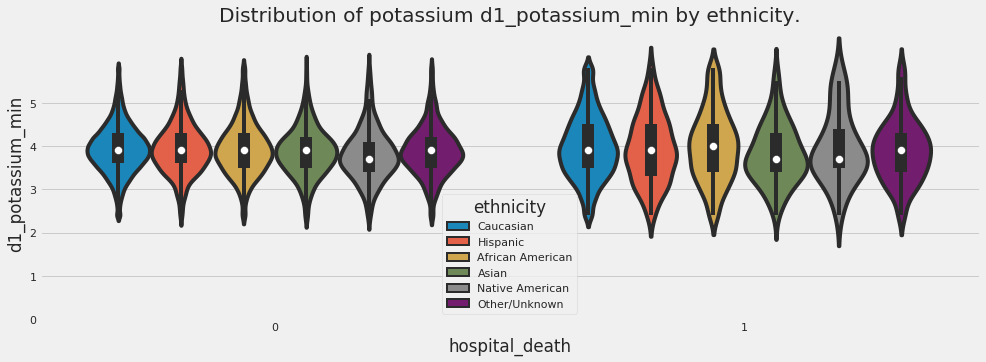

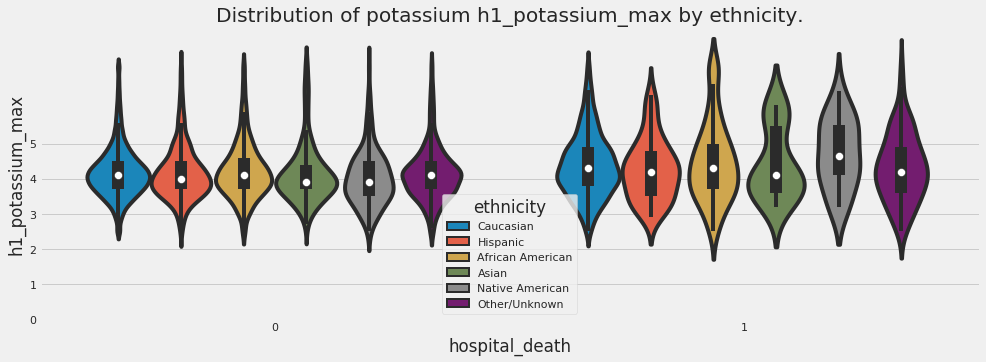

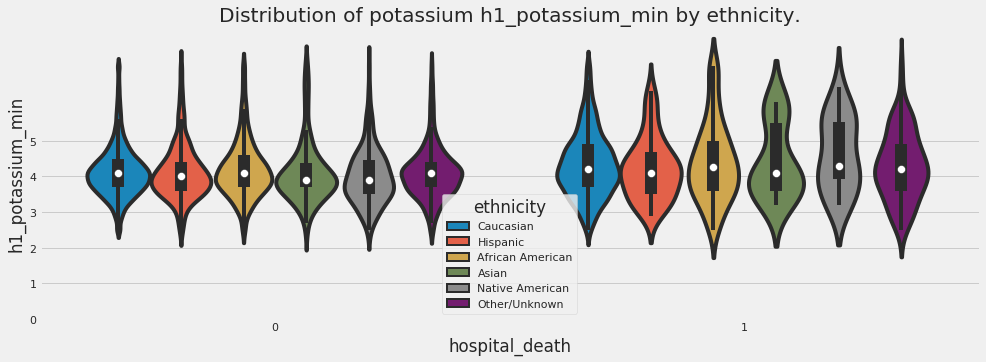

In [0]:
for i in potassium:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of potassium {} by ethnicity.'.format(i))
  plt.show()

##### Sodium

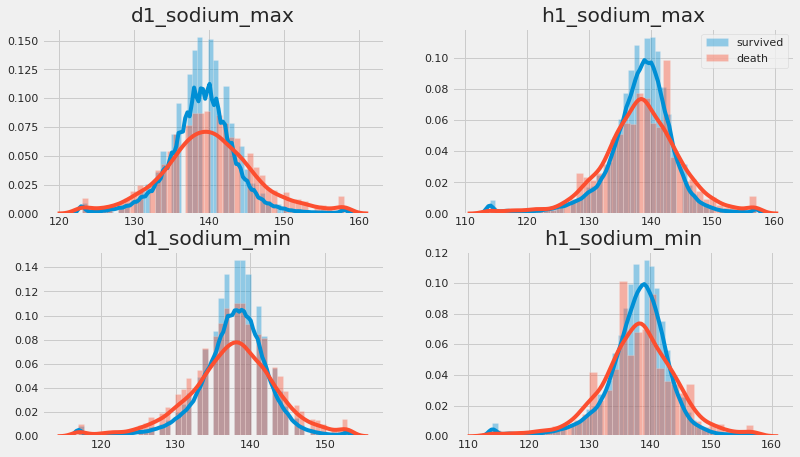

In [0]:
#check same measurements for first hour and first 24 hour
sodium=['d1_sodium_max','d1_sodium_min','h1_sodium_max','h1_sodium_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),sodium[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),sodium[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])

###### Demo-Gender

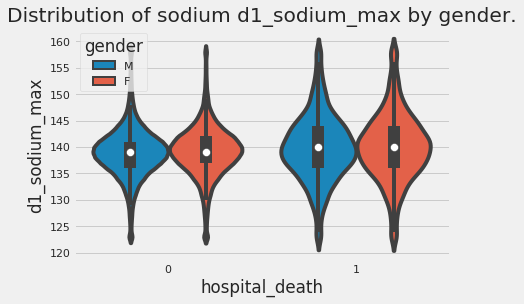

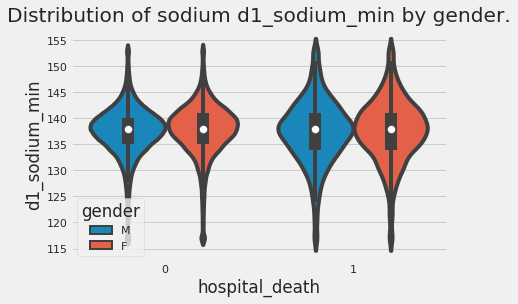

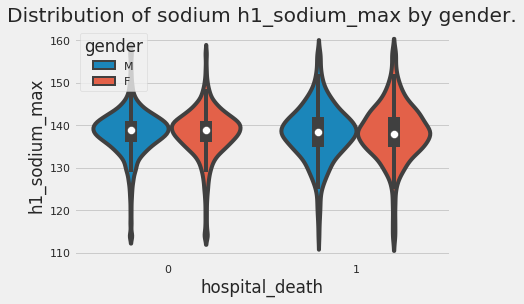

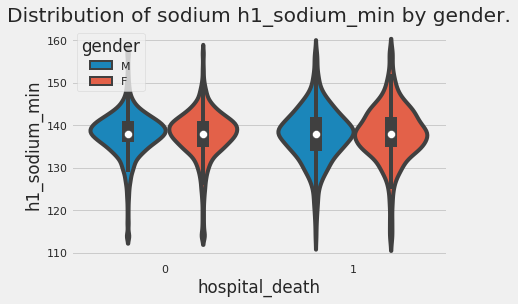

In [0]:
for i in sodium:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of sodium {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

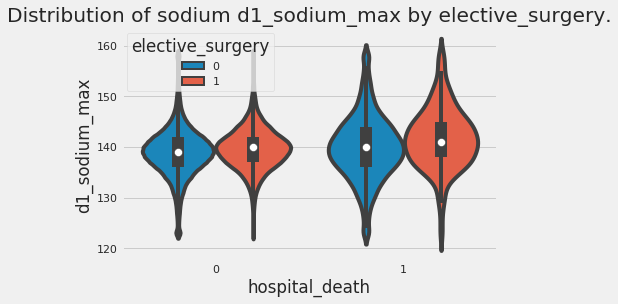

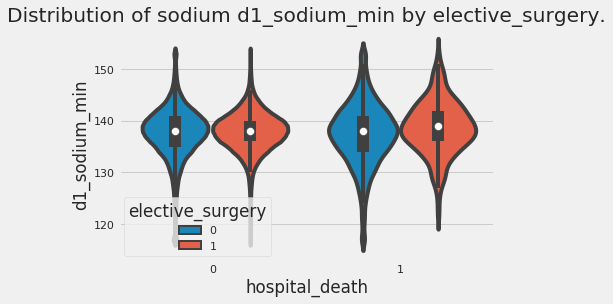

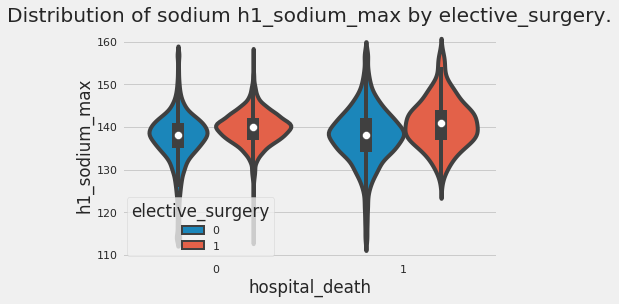

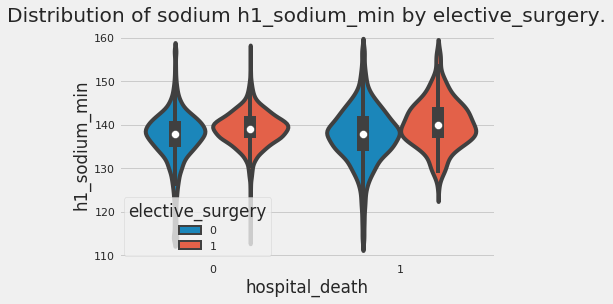

In [0]:
for i in sodium:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of sodium {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

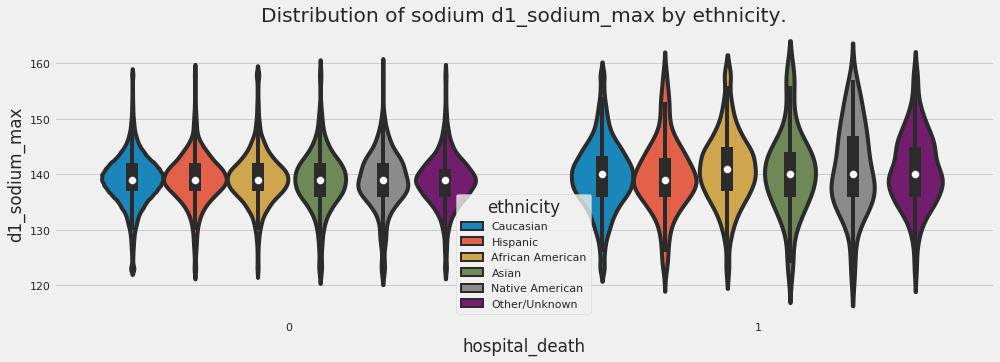

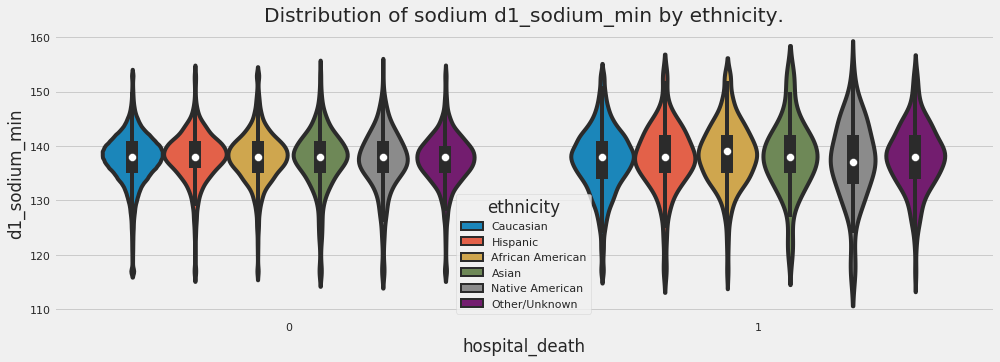

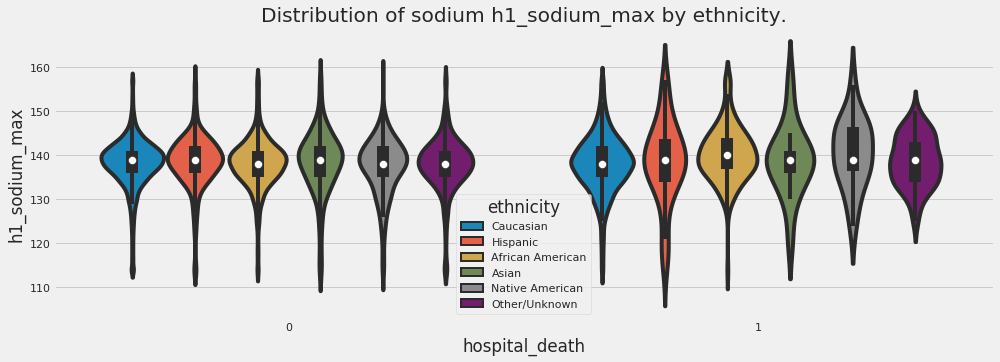

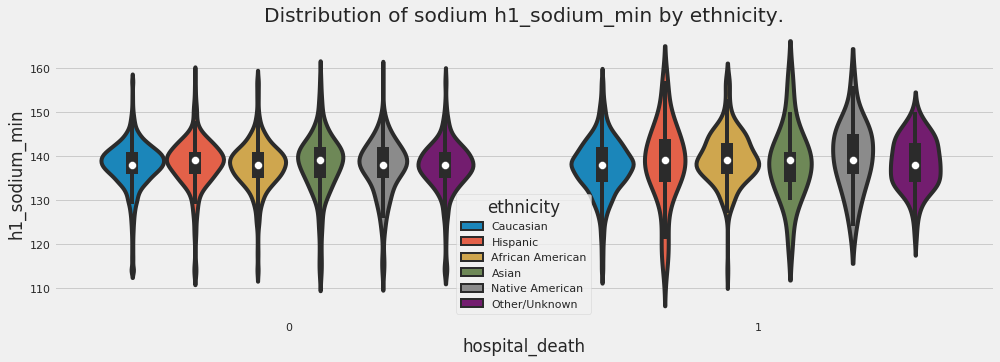

In [0]:
for i in sodium:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of sodium {} by ethnicity.'.format(i))
  plt.show()

##### wbc

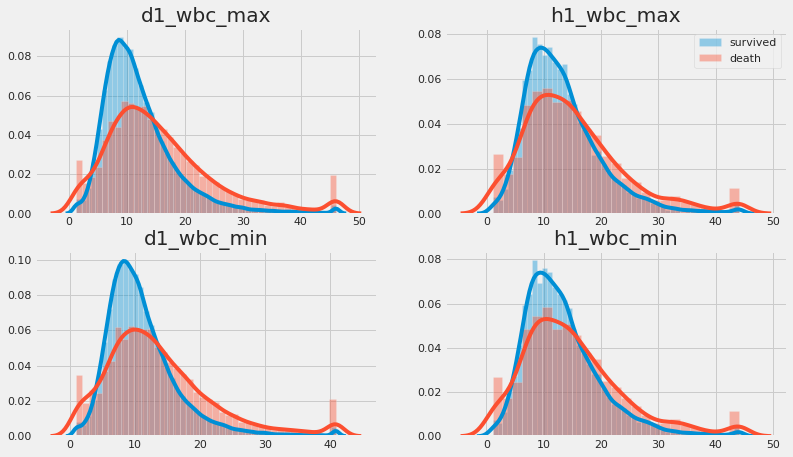

In [0]:
#check same measurements for first hour and first 24 hour
wbc=['d1_wbc_max','d1_wbc_min','h1_wbc_max','h1_wbc_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),wbc[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),wbc[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])

###### Demo-Gender

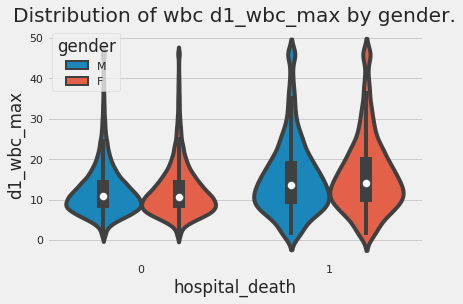

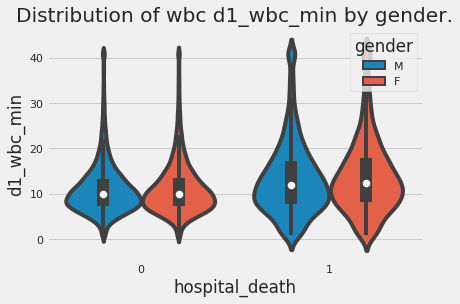

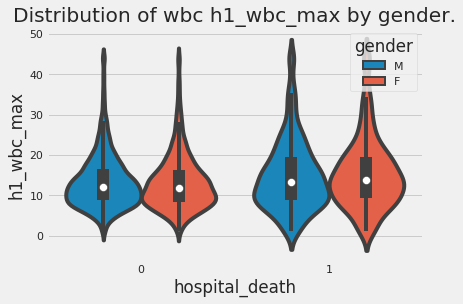

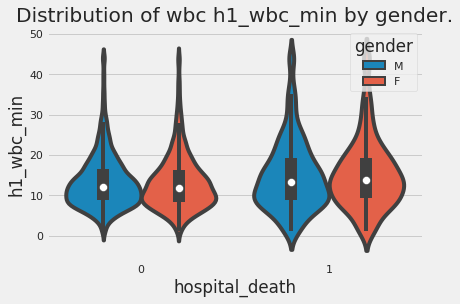

In [0]:
for i in wbc:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of wbc {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

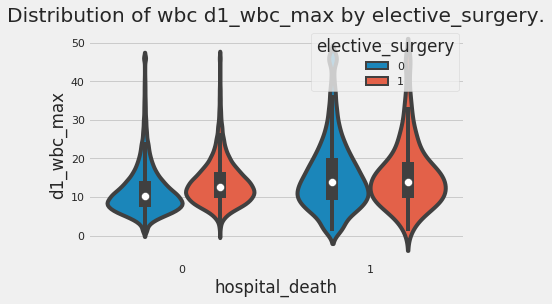

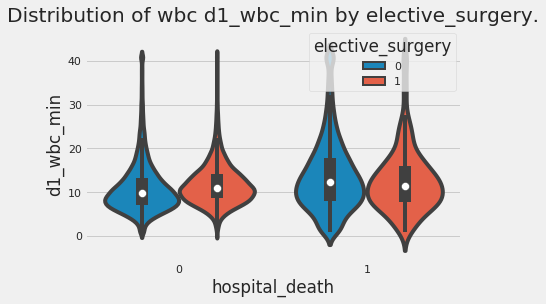

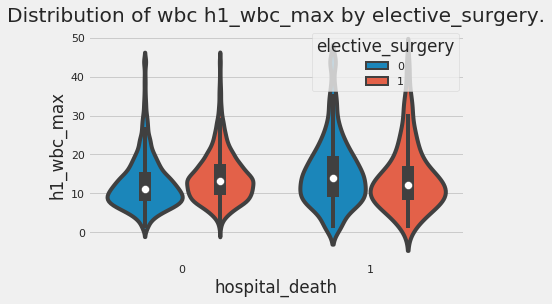

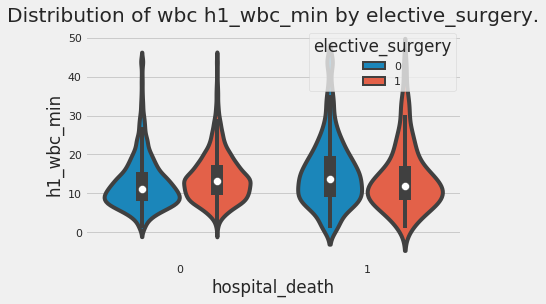

In [0]:
for i in wbc:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of wbc {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

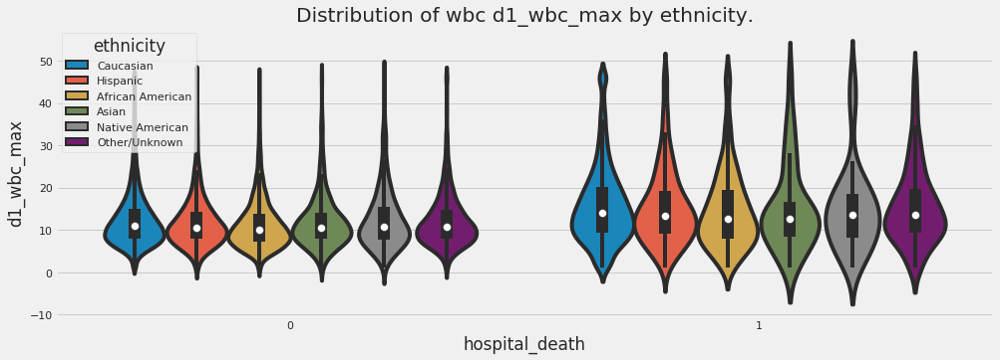

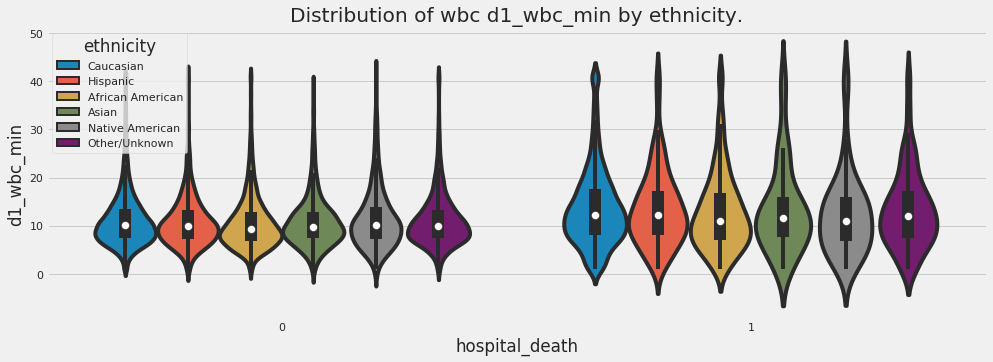

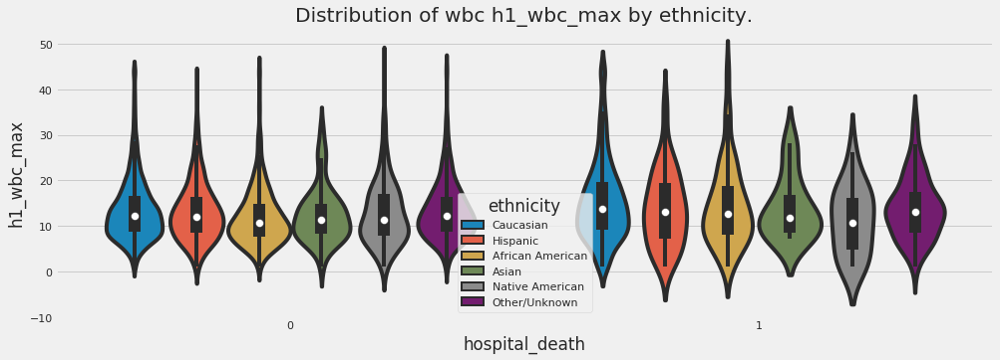

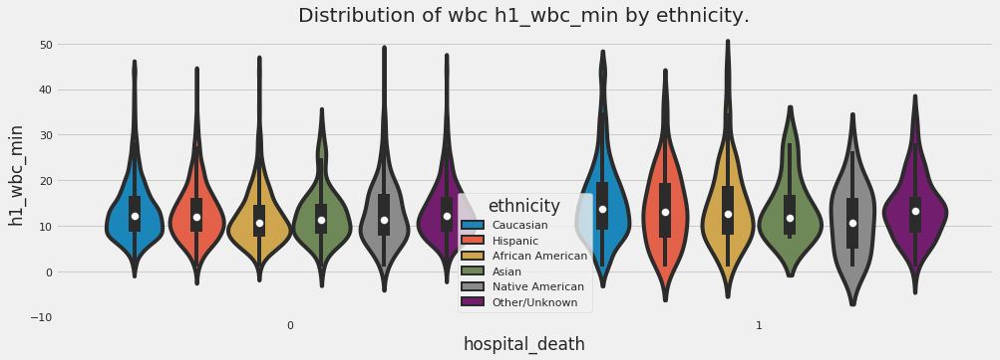

In [0]:
for i in wbc:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of wbc {} by ethnicity.'.format(i))
  plt.show()

##### pco2

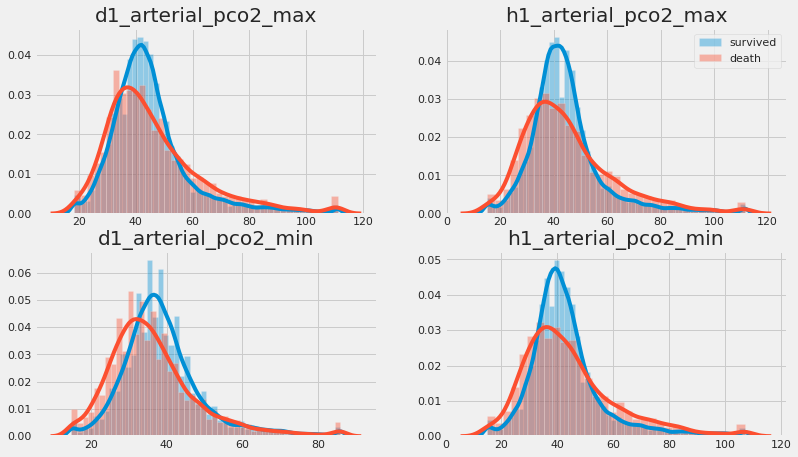

In [0]:
pco2 = ['d1_arterial_pco2_max', 'd1_arterial_pco2_min','h1_arterial_pco2_max', 'h1_arterial_pco2_min' ]
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),pco2[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),pco2[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])

###### Demo-Gender

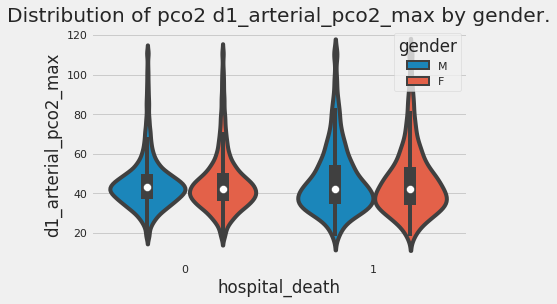

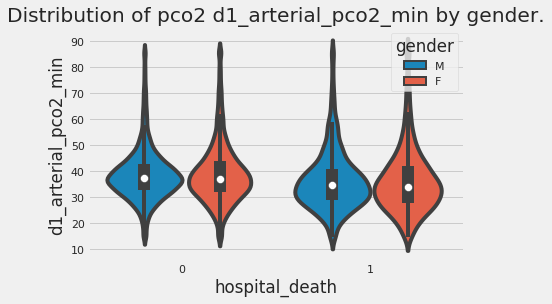

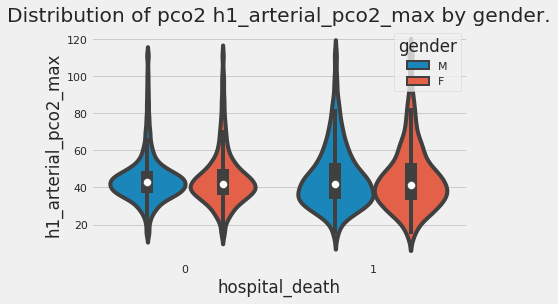

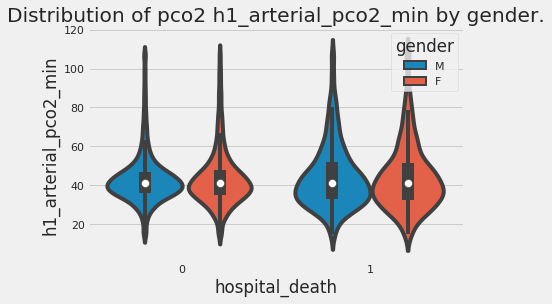

In [0]:
for i in pco2:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of pco2 {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

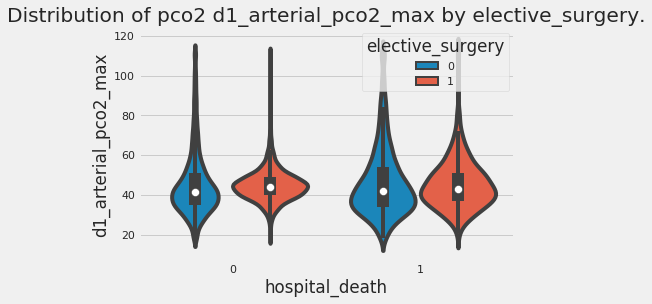

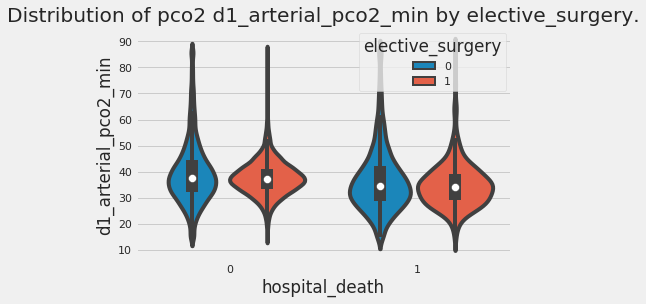

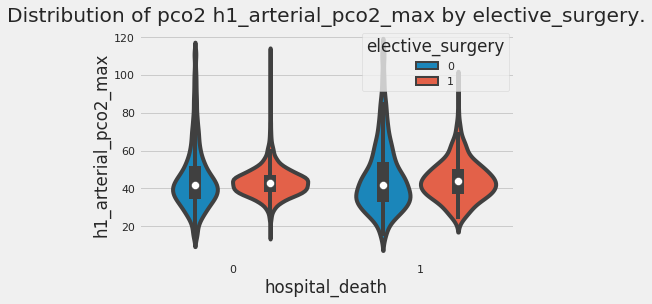

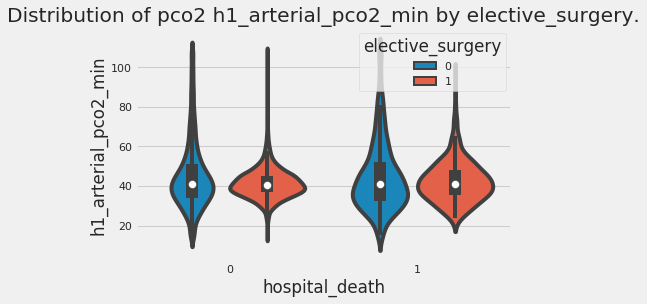

In [0]:
for i in pco2:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of pco2 {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

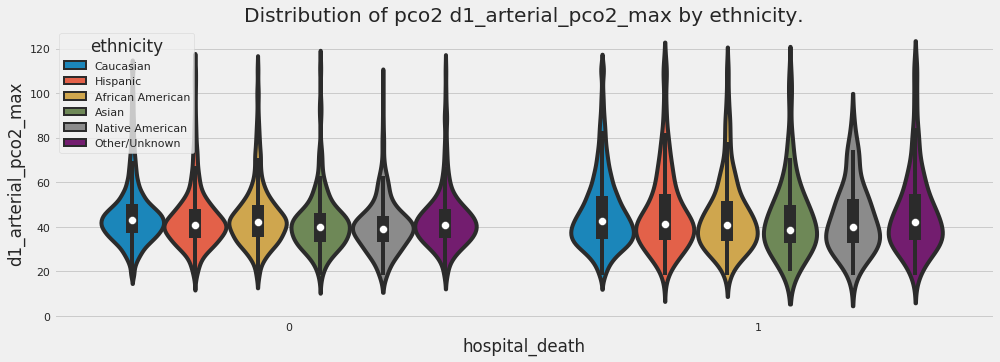

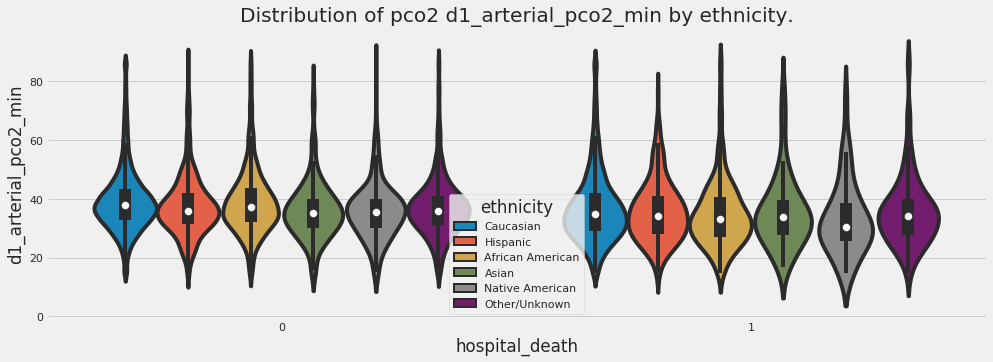

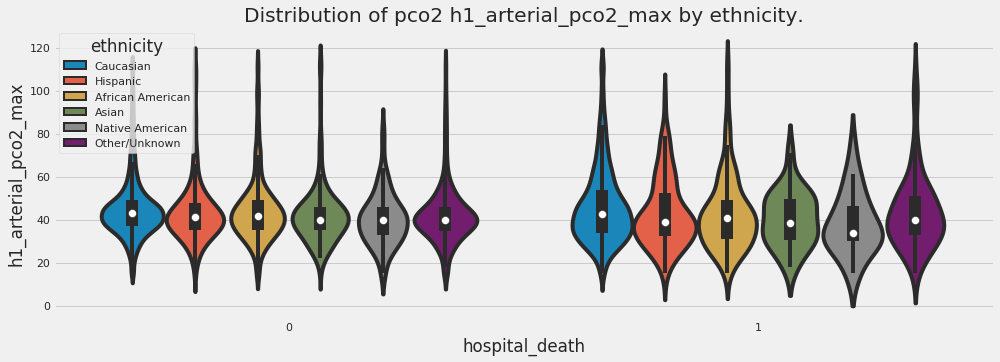

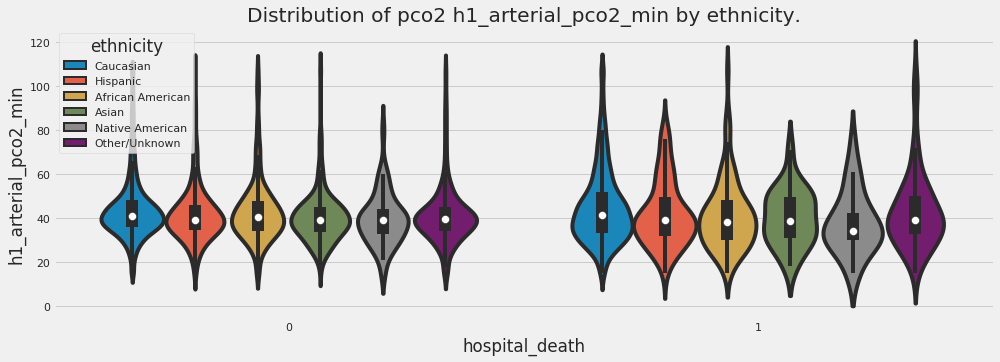

In [0]:
for i in pco2:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of pco2 {} by ethnicity.'.format(i))
  plt.show()

##### arterial ph
The normal arterial blood pH range is between 7.36 and 7.44 ([H+] between 44 and 36 nEq/L). Acidemia is defined as an arterial pH <7.36 ([H+] >44 nEq/L) and may result from a primary elevation in pCO2, a fall in [HCO3−], or both.

ph_apache : 
 - Missing value: 77.3%
 - The pH from the arterial blood gas taken during the first 24 hours of unit admission which produces the highest APACHE III score for acid-base disturbance

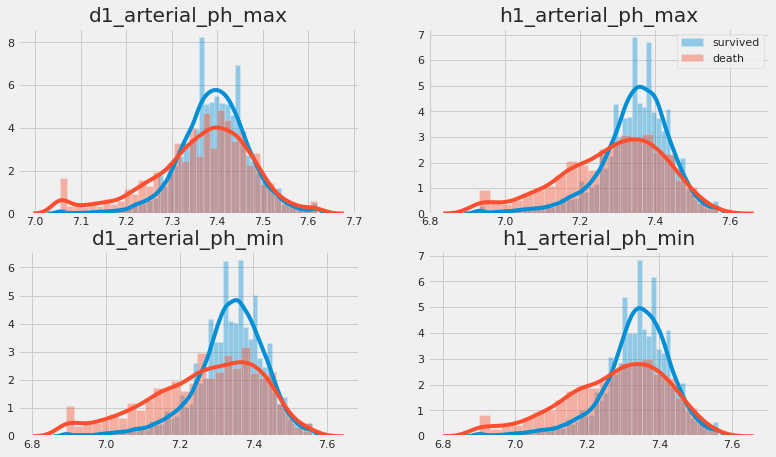

In [0]:
ph =['d1_arterial_ph_max', 'd1_arterial_ph_min', 'h1_arterial_ph_max', 'h1_arterial_ph_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),ph[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),ph[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])

###### Demo-Gender

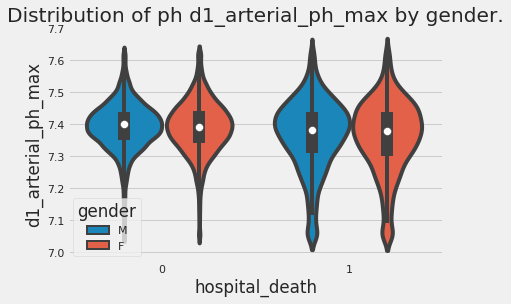

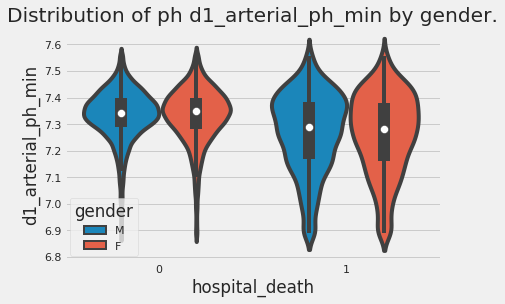

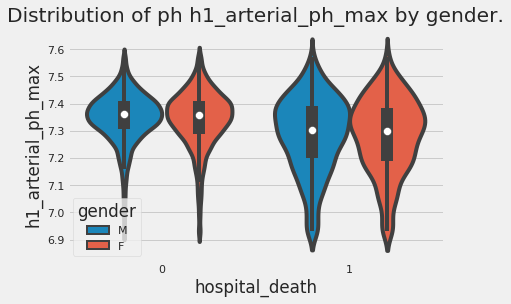

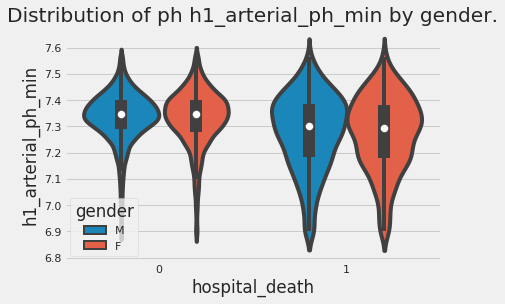

In [0]:
for i in ph:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of ph {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

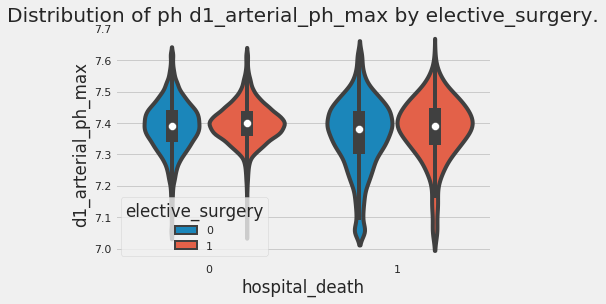

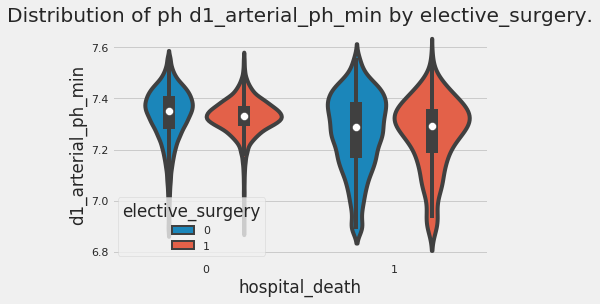

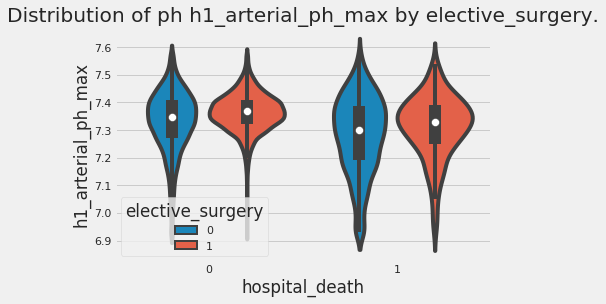

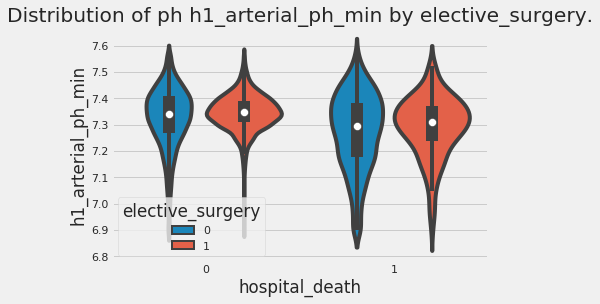

In [0]:
for i in ph:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of ph {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

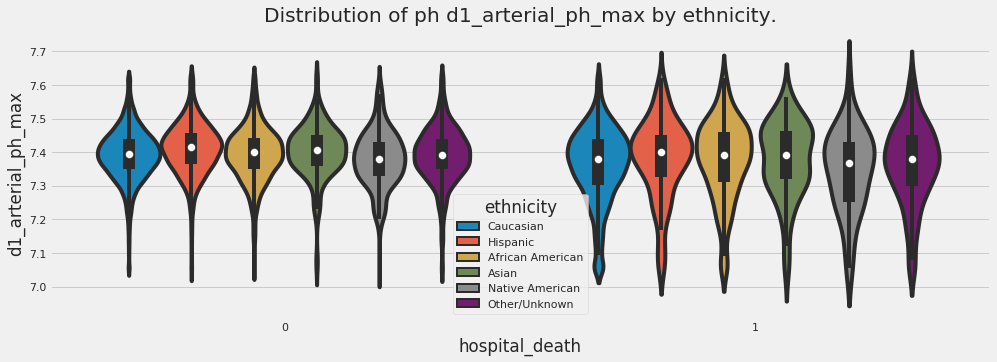

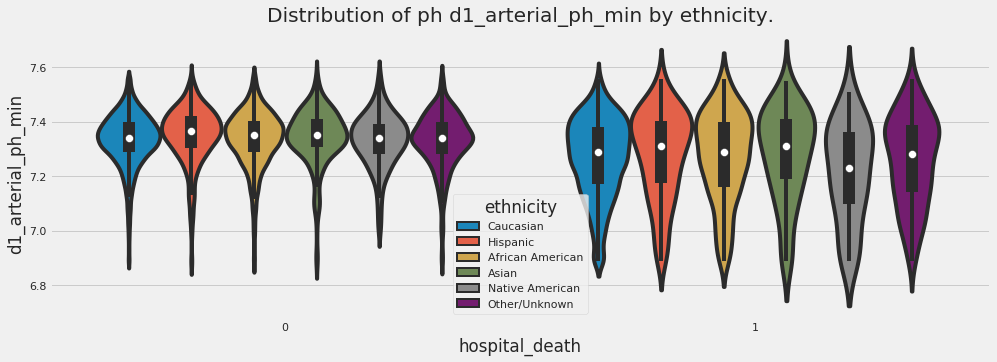

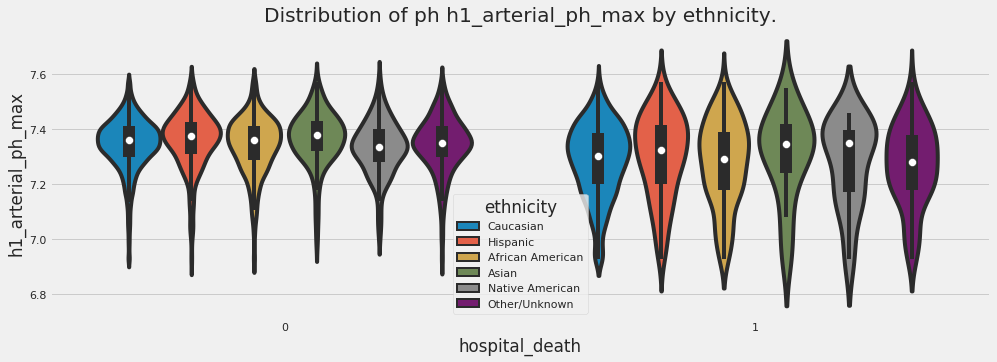

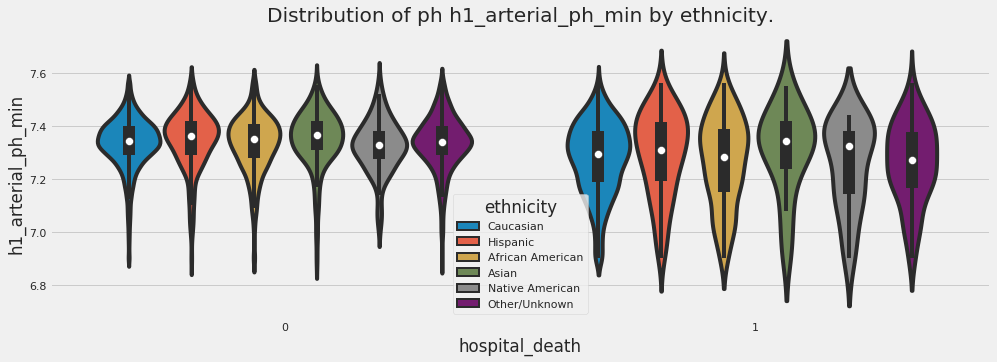

In [0]:
for i in ph:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of ph {} by ethnicity.'.format(i))
  plt.show()

###### ph_apache

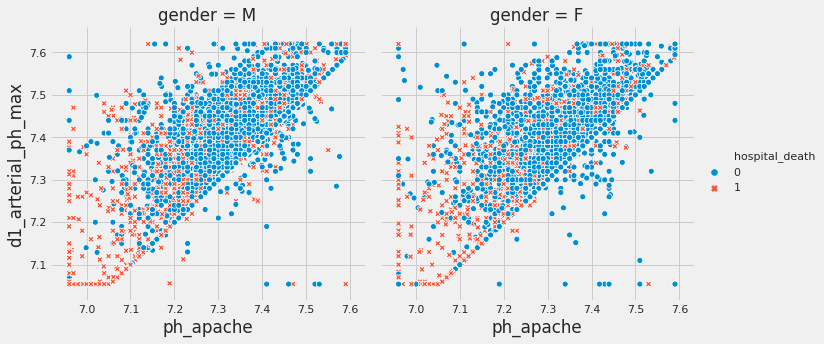

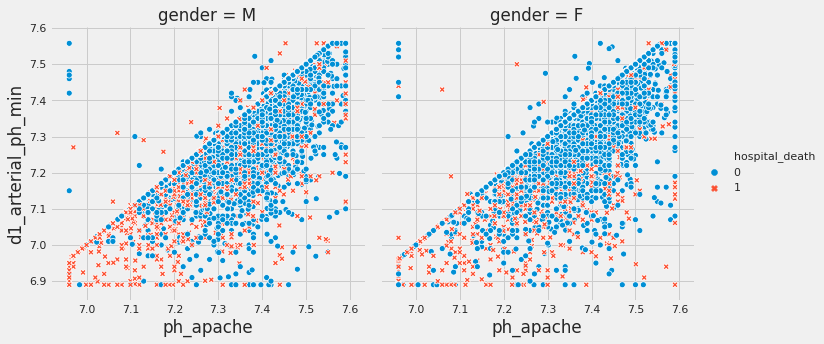

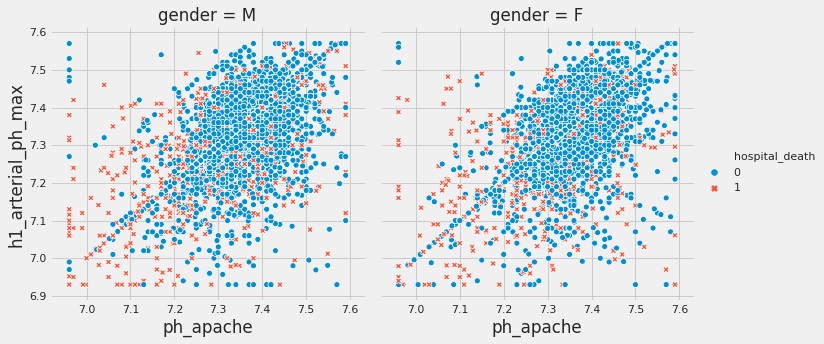

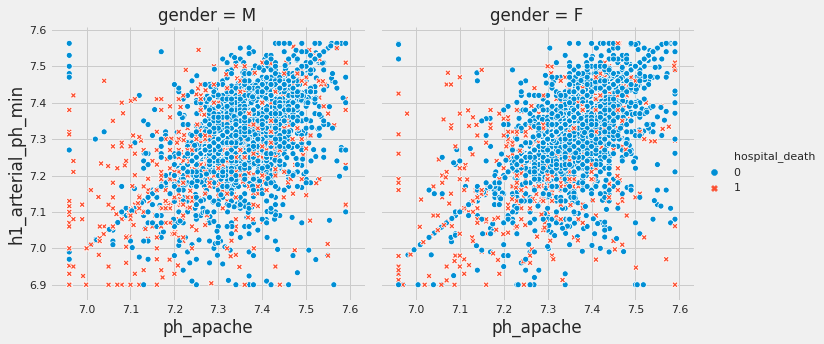

In [0]:
for i in ph:
  sns.relplot(x="ph_apache", y=i,col="gender", hue="hospital_death", style="hospital_death",kind="scatter", data=df)

##### po2

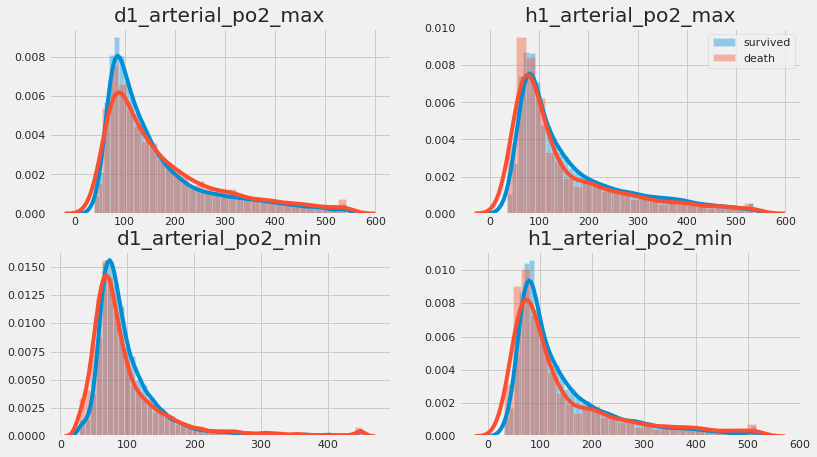

In [0]:
po2 =['d1_arterial_po2_max', 'd1_arterial_po2_min', 'h1_arterial_po2_max', 'h1_arterial_po2_min']
fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),po2[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)


for (j,i) in zip(range(0,2),po2[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])


###### Demo-Gender

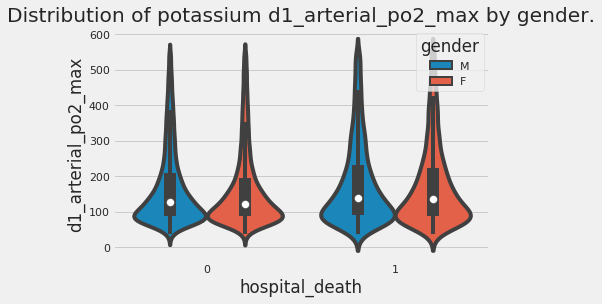

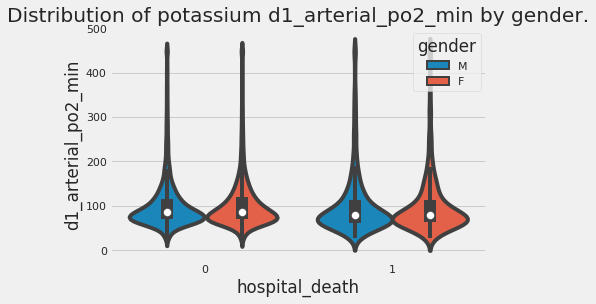

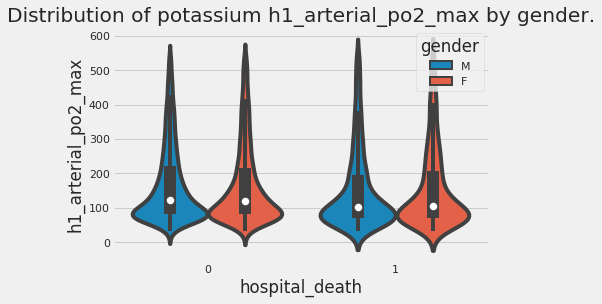

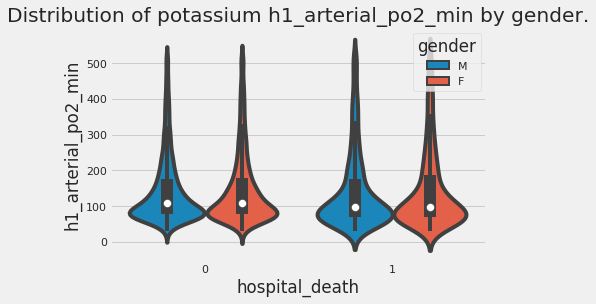

In [0]:
for i in po2:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of potassium {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

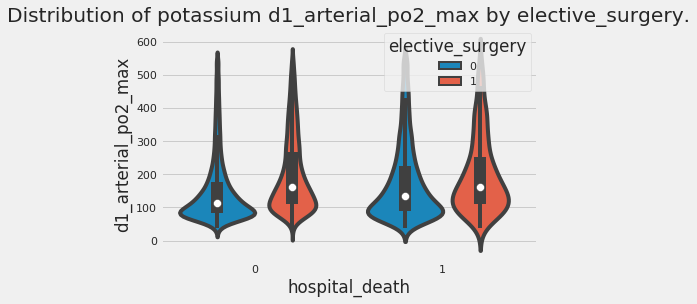

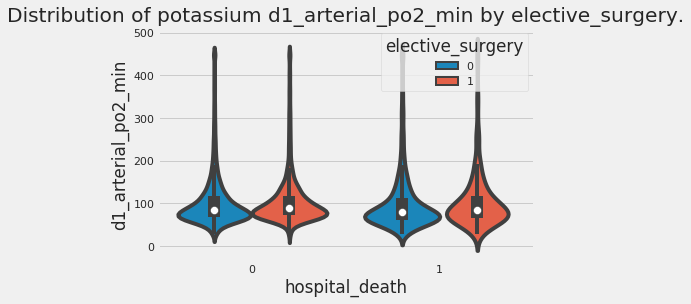

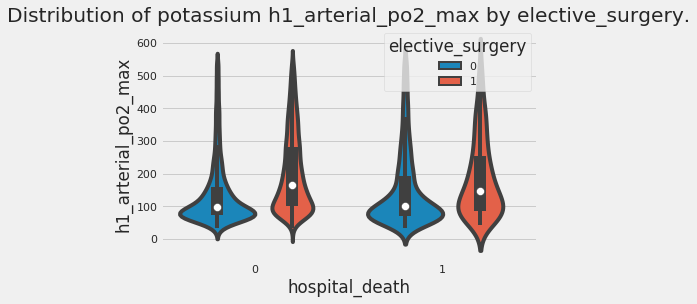

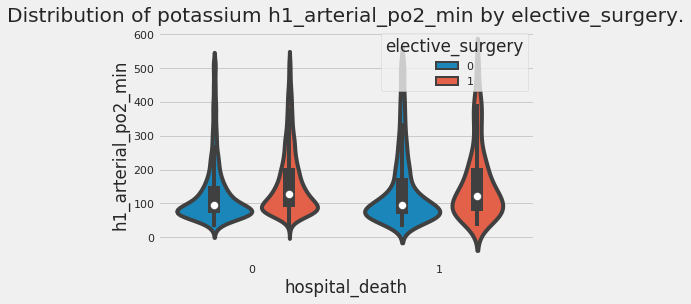

In [0]:
for i in po2:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of potassium {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

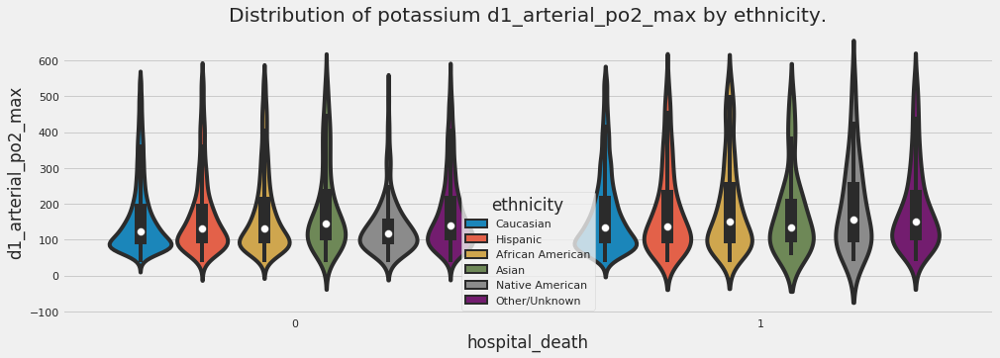

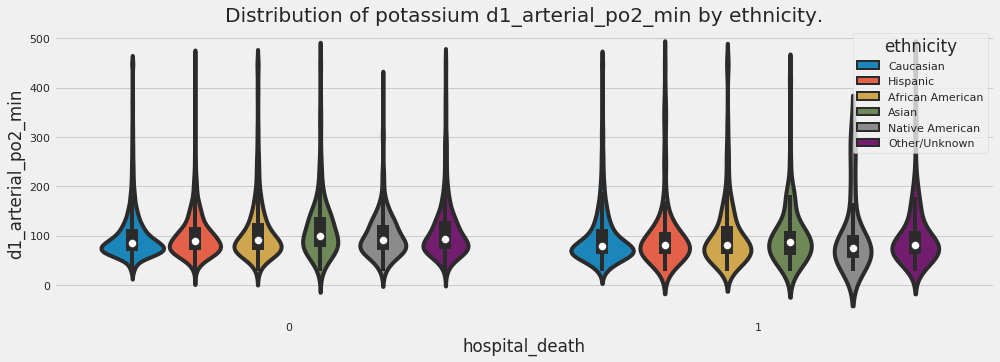

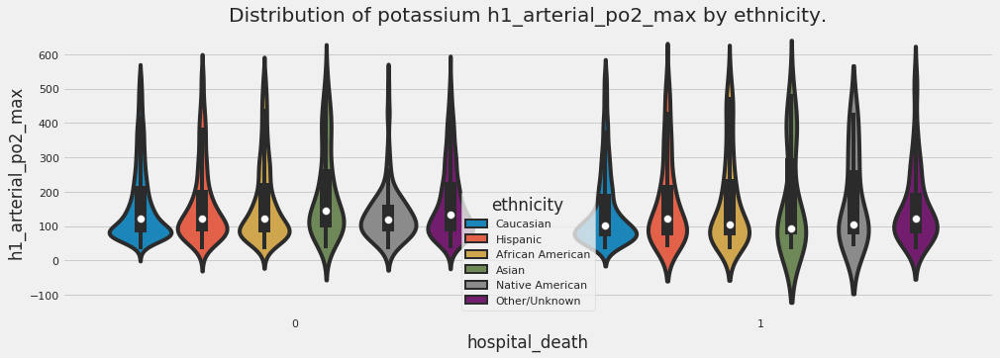

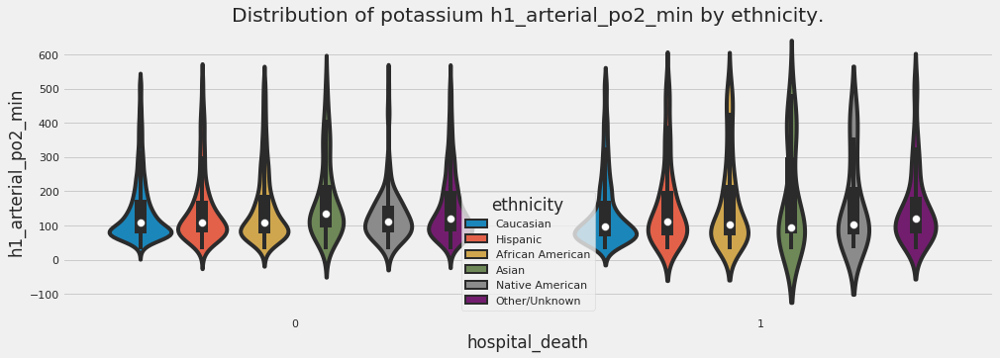

In [0]:
for i in po2:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of potassium {} by ethnicity.'.format(i))
  plt.show()

##### pao2fio2ratio

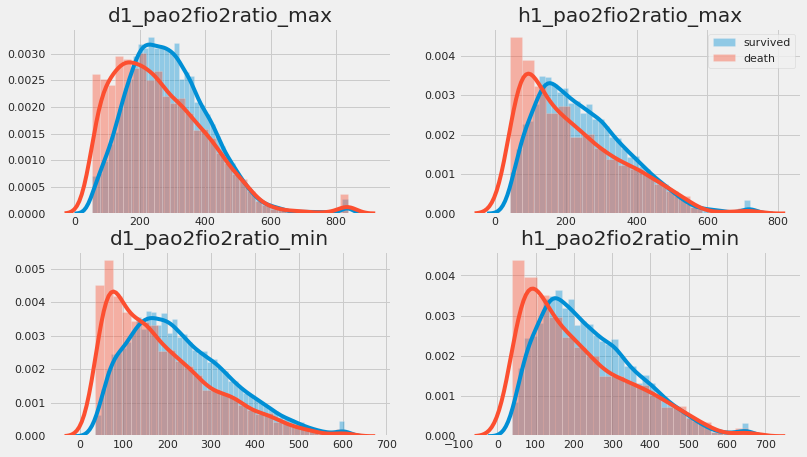

In [0]:
 pao2fio2ratio=['d1_pao2fio2ratio_max','d1_pao2fio2ratio_min','h1_pao2fio2ratio_max','h1_pao2fio2ratio_min']
 fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for (j,i) in zip(range(0,2),pao2fio2ratio[:2]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][0])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][0]).set_title(i)
  #ax[j][0].set_ylim([0, 0.06])

for (j,i) in zip(range(0,2),pao2fio2ratio[2:]):
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[j][1])
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[j][1]).set_title(i)
  ax[0][1].legend(['survived','death'])
  #ax[j][1].set_ylim([0, 0.06])

###### Demo-Gender

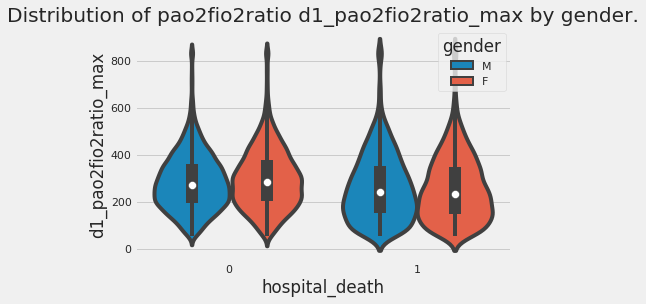

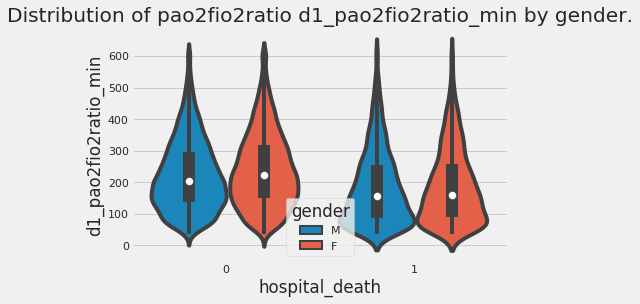

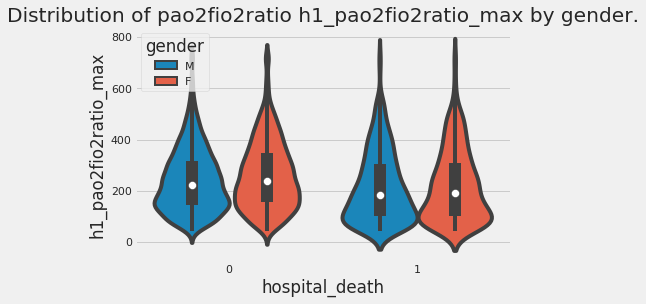

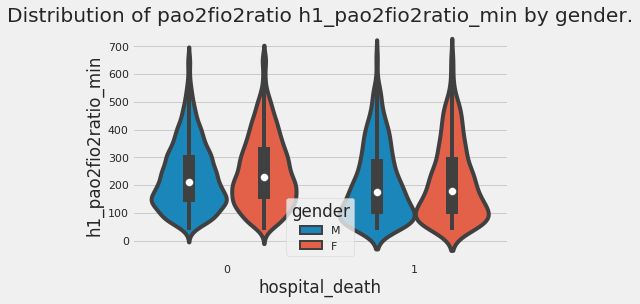

In [0]:
for i in pao2fio2ratio:
  sns.violinplot(x='hospital_death', y=i , hue = 'gender',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of pao2fio2ratio {} by gender.'.format(i))
  plt.show()

###### Demo-elective_surgery

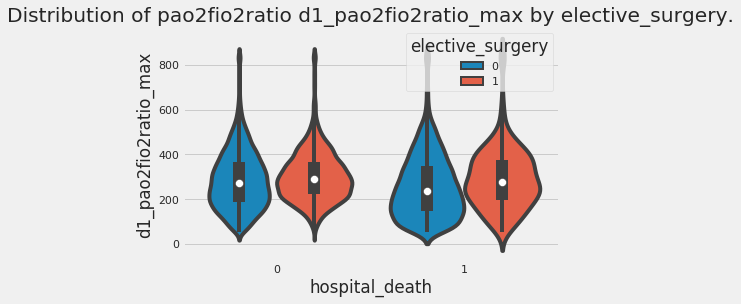

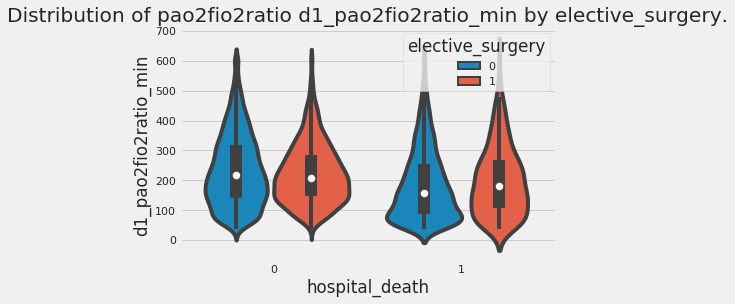

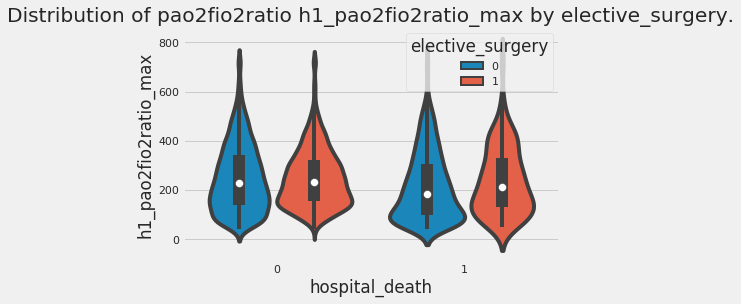

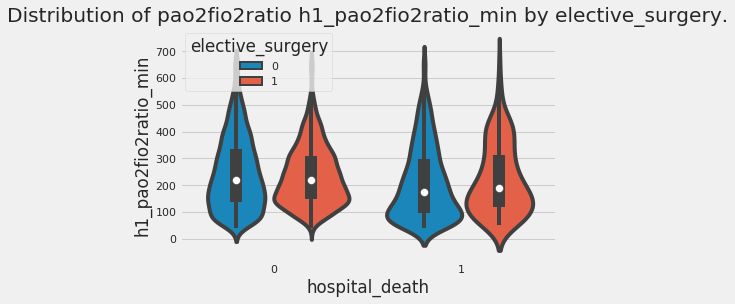

In [0]:
for i in pao2fio2ratio:
  sns.violinplot(x='hospital_death', y=i , hue = 'elective_surgery',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of pao2fio2ratio {} by elective_surgery.'.format(i))
  plt.show()

###### Demo-ethnicity

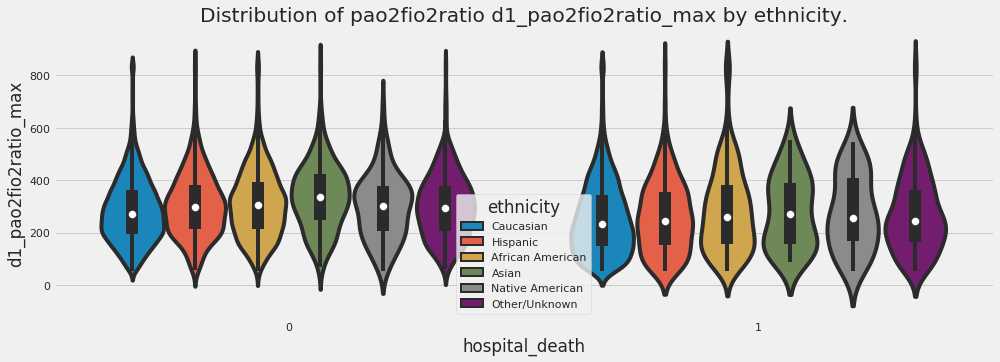

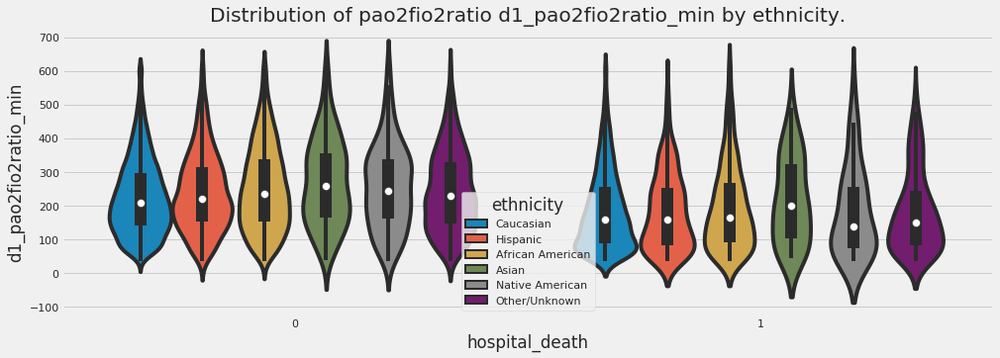

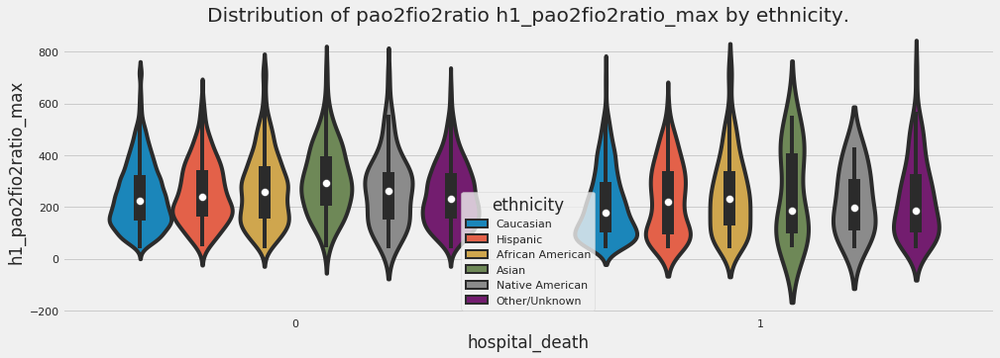

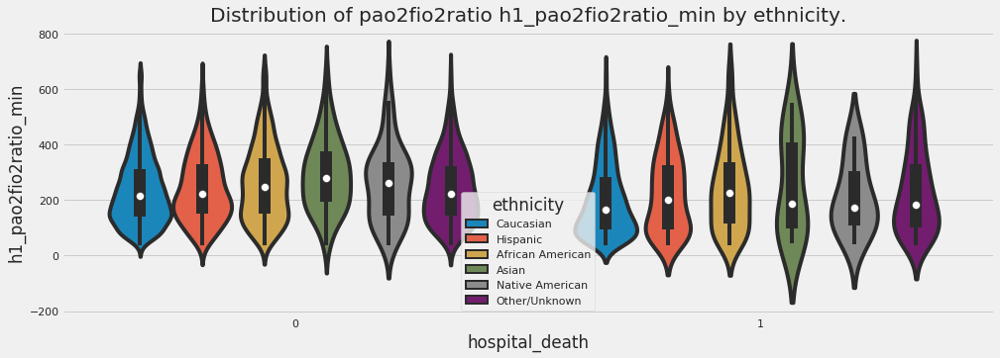

In [0]:
for i in pao2fio2ratio:
  plt.figure(figsize=(15, 5))
  sns.violinplot(x='hospital_death', y=i , hue = 'ethnicity',data=df)
  #plt.yticks(np.arange(0, 6, step=1))
  plt.title('Distribution of pao2fio2ratio {} by ethnicity.'.format(i))
  plt.show()

### 3.Demographic and APACHE data

#### 3.1  Features that is missing 50% and more

In [0]:
#sns.boxplot(x="d1_heartrate_min", y="apache_3j_bodysystem" , data=df);

In [0]:
index=df.columns[:46]
df_deAP=df[index]
df_deAP.isnull().sum()*100/df_deAP.shape[0]
#bmi

encounter_id            0.0 
patient_id              0.0 
hospital_id             0.0 
hospital_death          0.0 
age                     4.6 
bmi                     3.7 
elective_surgery        0.0 
ethnicity               1.5 
gender                  0.0 
height                  1.5 
hospital_admit_source   23.3
icu_admit_source        0.1 
icu_id                  0.0 
icu_stay_type           0.0 
icu_type                0.0 
pre_icu_los_days        0.0 
readmission_status      0.0 
weight                  3.0 
albumin_apache          59.3
apache_2_diagnosis      1.8 
apache_3j_diagnosis     1.2 
apache_post_operative   0.0 
arf_apache              0.8 
bilirubin_apache        63.4
bun_apache              21.0
creatinine_apache       20.6
fio2_apache             77.3
gcs_eyes_apache         2.1 
gcs_motor_apache        2.1 
gcs_unable_apache       1.1 
gcs_verbal_apache       2.1 
glucose_apache          12.0
heart_rate_apache       1.0 
hematocrit_apache       21.7
intubated_apac

* Conclusion: [albumin_apache,bilirubin_apache, fio2_apache, paco2_apache, paco2_for_ph_apache, pao2_apache, ph_apache, urineoutput_apache] have too many missing value(>50%), so we consider to drop these features

In [0]:
def plot_histograms( df , variables , n_rows , n_cols ):
    fig = plt.figure( figsize = ( 16 , 12 ) )
    for i, var_name in enumerate( variables ):
        ax=fig.add_subplot( n_rows , n_cols , i+1 )
        df[ var_name ].hist( bins=10 , ax=ax )
        ax.set_title( 'Skew: ' + str( round( float( df[ var_name ].skew() ) , ) ) ) # + ' ' + var_name ) #var_name+" Distribution")
        ax.set_xticklabels( [] , visible=False )
        ax.set_yticklabels( [] , visible=False )
    fig.tight_layout()  # Improves appearance a bit.
    plt.show()

def plot_distribution( df , var , target , **kwargs ):
    row = kwargs.get( 'row' , None )
    col = kwargs.get( 'col' , None )
    facet = sns.FacetGrid( df , hue=target , aspect=4 , row = row , col = col )
    facet.map( sns.kdeplot , var , shade= True )
    facet.set( xlim=( 0 , df[ var ].max() ) )
    facet.add_legend()
def plot_categories( df , cat , target , **kwargs ):
    row = kwargs.get( 'row' , None )
    col = kwargs.get( 'col' , None )
    facet = sns.FacetGrid( df , row = row , col = col )
    facet.map( sns.barplot , cat , target )
    facet.add_legend()

def plot_correlation_map( df ):
    corr = df.corr()
    _ , ax = plt.subplots( figsize =( 12 , 10 ) )
    cmap = sns.diverging_palette( 220 , 10 , as_cmap = True )
    _ = sns.heatmap(
        corr, 
        cmap = cmap,
        square=True, 
        cbar_kws={ 'shrink' : .9 }, 
        ax=ax, 
        annot = False, 
        annot_kws = { 'fontsize' : 12 }
    )
def describe_more( df ):
    var = [] ; l = [] ; t = []
    for x in df:
        var.append( x )
        l.append( len( pd.value_counts( df[ x ] ) ) )
        t.append( df[ x ].dtypes )
    levels = pd.DataFrame( { 'Variable' : var , 'Levels' : l , 'Datatype' : t } )
    levels.sort_values( by = 'Levels' , inplace = True )
    return levels

def plot_variable_importance( X , y ):
    tree = DecisionTreeClassifier( random_state = 99 )
    tree.fit( X , y )
    plot_model_var_imp( tree , X , y )
    
def plot_model_var_imp( model , X , y ):
    imp = pd.DataFrame( 
        model.feature_importances_  , 
        columns = [ 'Importance' ] , 
        index = X.columns 
    )
    imp = imp.sort_values( [ 'Importance' ] , ascending = True )
    imp[ : 10 ].plot( kind = 'barh' )
    print (model.score( X , y ))

#### 3.2 demographic features

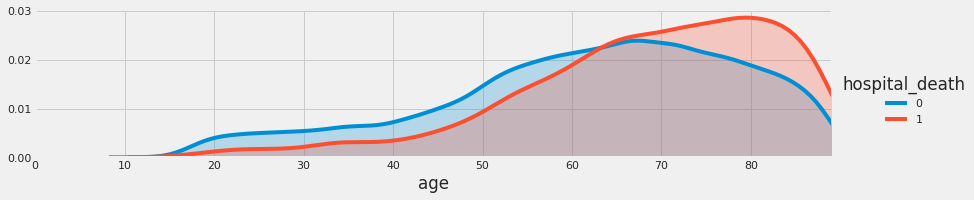

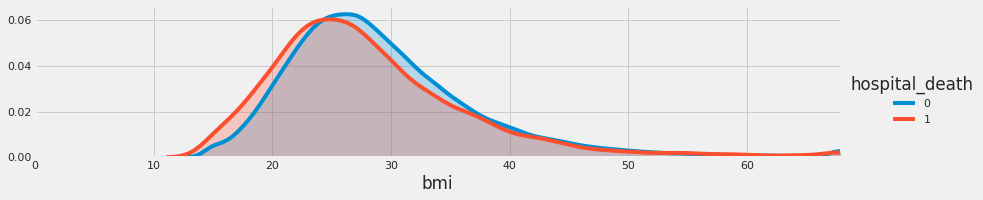

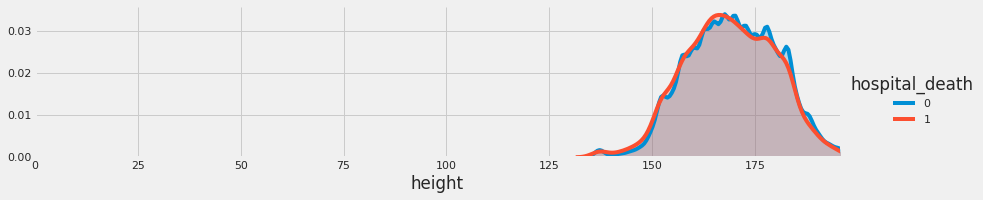

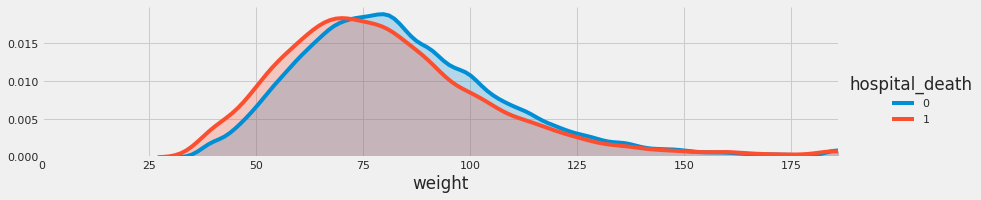

In [0]:
demographic_cont=['age',
 'bmi',
 'height', #mean or median
 'weight',]
for i in demographic_cont:
  plot_distribution(df_deAP, var=i, target="hospital_death")

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:728: UserWarning:

Using the barplot function without specifying `order` is likely to produce an incorrect plot.

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:728: UserWarning:

Using the barplot function without specifying `order` is likely to produce an incorrect plot.



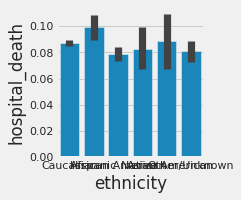

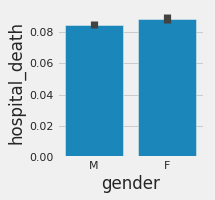

In [0]:
demographic_cat=['ethnicity','gender']
for i in demographic_cat:
  plot_categories(df_deAP,cat=i, target="hospital_death")

In [0]:
 sns.violinplot(x='hospital_death', y='ethnicity' , hue = 'gender',data=df)

NameError: ignored

#### 3.3 hospital admission related features

Feature definition:
* elective_surgery: Whether the patient was admitted to the hospital for a scheduled surgery in advance, not emergency
* hospital_admit_source: The location of the patient prior to being admitted to the hospital, such as:  

         'Acute Care/Floor': 1910,
         'Chest Pain Center': 134,
         'Direct Admit': 6441,
         'Emergency Department': 36962,
         'Floor': 8055,
         'ICU': 35,
         'ICU to SDU': 45,
         'Observation': 10,
         'Operating Room': 9787,
         'Other': 7,
         'Other Hospital': 1641,
         'Other ICU': 233,
         'PACU': 1017,
         'Recovery Room': 2896,
         'Step-Down Unit (SDU)': 1131

#### 3.4 ICU admission related features

feature definitions:
* icu_admit_source: The location of the patient prior to being admitted to the unit, such as:

         'Accident & Emergency': 54060,
         'Floor': 15611,
         'Operating Room / Recovery': 18713,
         'Other Hospital': 2358,
         'Other ICU': 859

* icu_stay_type: readmit, transfer, admit
* icu_type: A classification which indicates the type of care the unit is capable of providing, such as:

         'CCU-CTICU': 7156, (coronary care unit-Cardiothoracic Intensive Care Unit)
         'CSICU': 4613, (Cardiac Surgery Intensive Care Unit)
         'CTICU': 4003, (Cardiothoracic Intensive Care Unit)
         'Cardiac ICU': 4776,
         'MICU': 7695,
         'Med-Surg ICU': 50586,
         'Neuro ICU': 7675,
         'SICU': 5209

* pre_icu_los_days: The length of stay of the patient between hospital admission and unit admission (days)

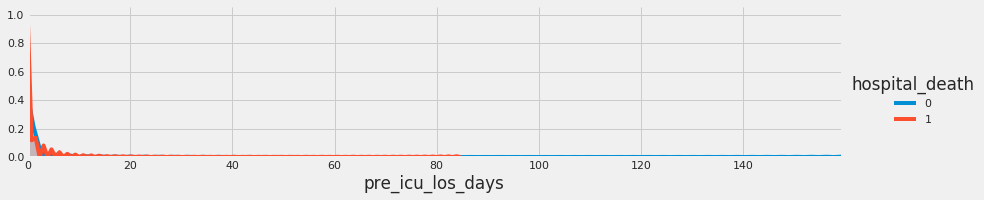

In [0]:
icu_cont=["pre_icu_los_days"]
for i in icu_cont:
  plot_distribution(df_deAP, var=i, target="hospital_death")

##### blood urea nitrogen
* bun_apache: The blood urea nitrogen concentration measured during the first 24 hours which results in the highest APACHE III score

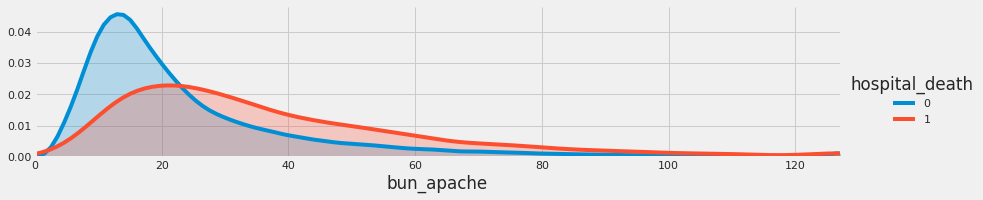

In [0]:
plot_distribution(df_deAP,var="bun_apache", target="hospital_death")

##### creatinine
* creatinine_apache: The creatinine concentration measured during the first 24 hours which results in the highest APACHE III score

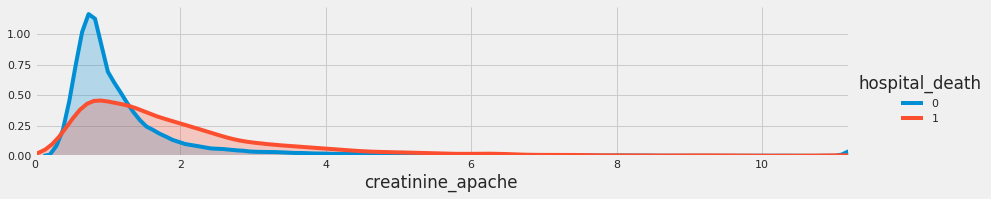

In [0]:
plot_distribution(df_deAP,var="creatinine_apache", target="hospital_death")

##### sedation
* gcs_unable_apache: Whether the Glasgow Coma Scale was unable to be assessed due to patient sedation

##### verbal
* gcs_verbal_apache: The verbal component of the Glasgow Coma Scale measured during the first 24 hours which results in the highest APACHE III score

##### glucose
* glucose_apache: The glucose concentration measured during the first 24 hours which results in the highest APACHE III score

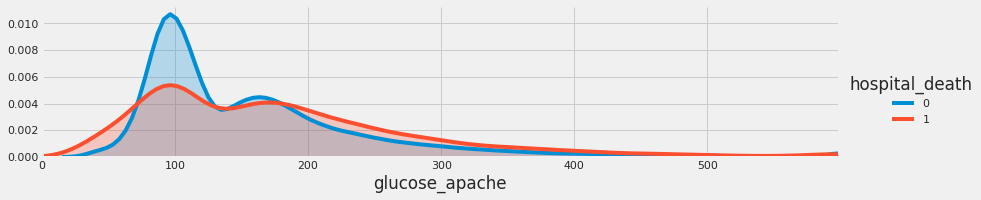

In [0]:
plot_distribution(df_deAP,var="glucose_apache", target="hospital_death")

##### heart rate
* heart_rate_apache: The heart rate measured during the first 24 hours which results in the highest APACHE III score

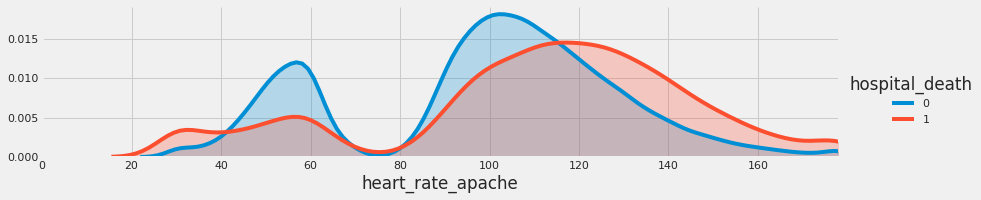

In [0]:
plot_distribution(df_deAP,var="heart_rate_apache", target="hospital_death")

##### hematocrit
* hematocrit_apache: The hematocrit measured during the first 24 hours which results in the highest APACHE III score

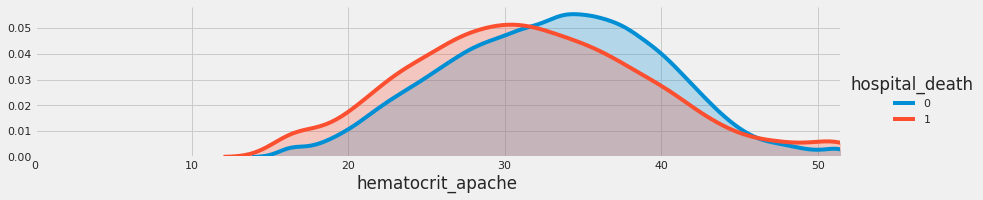

In [0]:
plot_distribution(df_deAP,var="hematocrit_apache", target="hospital_death")

##### intubated and ventilated
* intubated_apache: Whether the patient was intubated at the time of the highest scoring arterial blood gas used in the oxygenation score
* ventilated_apache: Whether the patient was invasively ventilated at the time of the highest scoring arterial blood gas using the oxygenation scoring algorithm, including any mode of positive pressure ventilation delivered through a circuit attached to an endo-tracheal tube or tracheostomy

##### mean arterial pressure
* map_apache: The mean arterial pressure measured during the first 24 hours which results in the highest APACHE III score

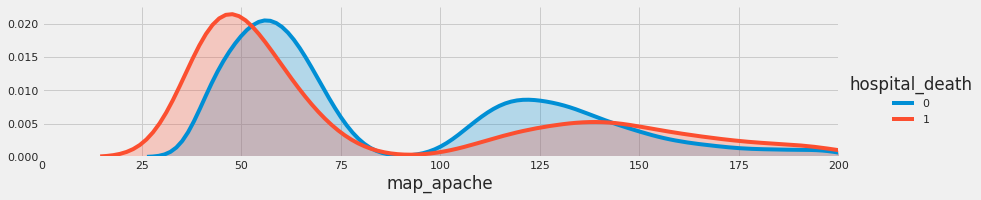

In [0]:
plot_distribution(df_deAP,var="map_apache", target="hospital_death")

##### respratory rate
* resprate_apache: The respiratory rate measured during the first 24 hours which results in the highest APACHE III score

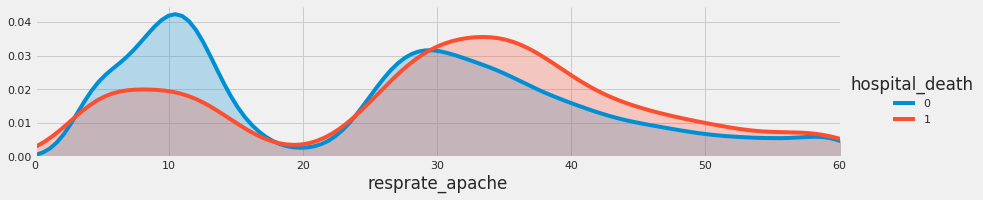

In [0]:
plot_distribution(df_deAP,var="resprate_apache", target="hospital_death")

##### sodium concentration
* sodium_apache: The sodium concentration measured during the first 24 hours which results in the highest APACHE III score

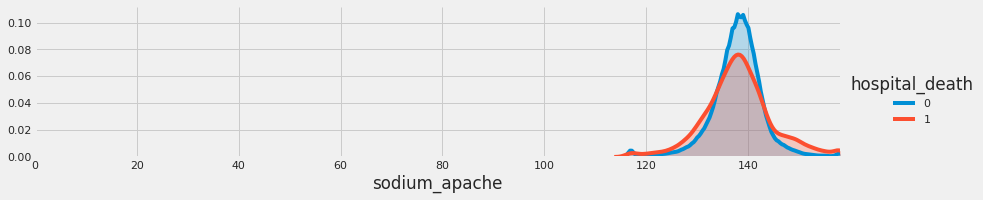

In [0]:
plot_distribution(df_deAP,var="sodium_apache", target="hospital_death")

##### temperature
* temp_apache: The temperature measured during the first 24 hours which results in the highest APACHE III score

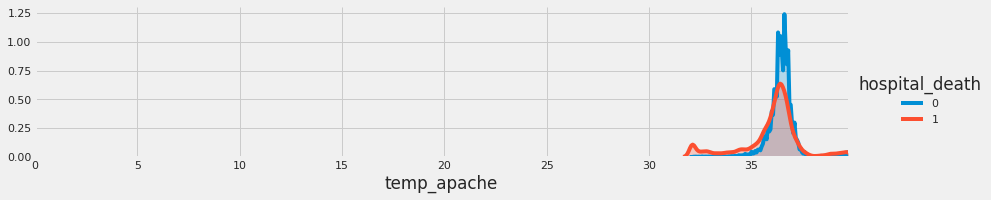

In [0]:
plot_distribution(df_deAP,var="temp_apache", target="hospital_death")

##### white blood cell
* wbc_apache: The white blood cell count measured during the first 24 hours which results in the highest APACHE III score

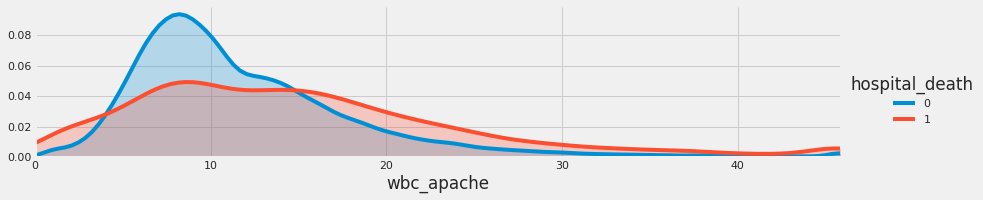

In [0]:
plot_distribution(df_deAP,var="wbc_apache", target="hospital_death")

___
### 4.Vitals

https://www.ncbi.nlm.nih.gov/pubmed/28489610

Invasive methods remain the most accurate at measuring ICP, but they are prone to a variety of complications including infection, hemorrhage and neurological deficits.

Noninvasive methods for measuring and evaluating ICP have been developed and classified in five broad categories, but have not been reliable enough to use on a routine basis.

Invasive, noninvasive: Measurement of intracranial pressure (ICP) can be invaluable in the management of critically ill patients

In [0]:
vital_cols = dictionary[dictionary['Category'] == 'vitals']['Variable Name'].to_list()
vital_cols.append('hospital_death')
vitals = df[vital_cols]

target_0 = vitals.loc[vitals['hospital_death'] == 0]
target_1 = vitals.loc[vitals['hospital_death'] == 1]

In [0]:
# look at how many missing values for the columns
missing_values_count= vitals.isnull().sum()
missing_values_percentage=np.round(vitals.isnull().sum()/vitals.shape[0]*100,2)

#show it in dataframe
data = {'Number_missing':missing_values_count, 'Missing_percentage':missing_values_percentage} 
  
# Create DataFrame 
missing_info = pd.DataFrame(data) 
  
# Print the output. 
missing_info.sort_values('Missing_percentage',ascending = False)

,Number_missing,Missing_percentage
h1_diasbp_invasive_max,74928,81.7
h1_diasbp_invasive_min,74928,81.7
h1_sysbp_invasive_min,74915,81.7
h1_sysbp_invasive_max,74915,81.7
h1_mbp_invasive_min,74844,81.6
h1_mbp_invasive_max,74844,81.6
d1_diasbp_invasive_min,67984,74.1
d1_diasbp_invasive_max,67984,74.1
d1_sysbp_invasive_max,67959,74.1
d1_sysbp_invasive_min,67959,74.1


#### Correlation

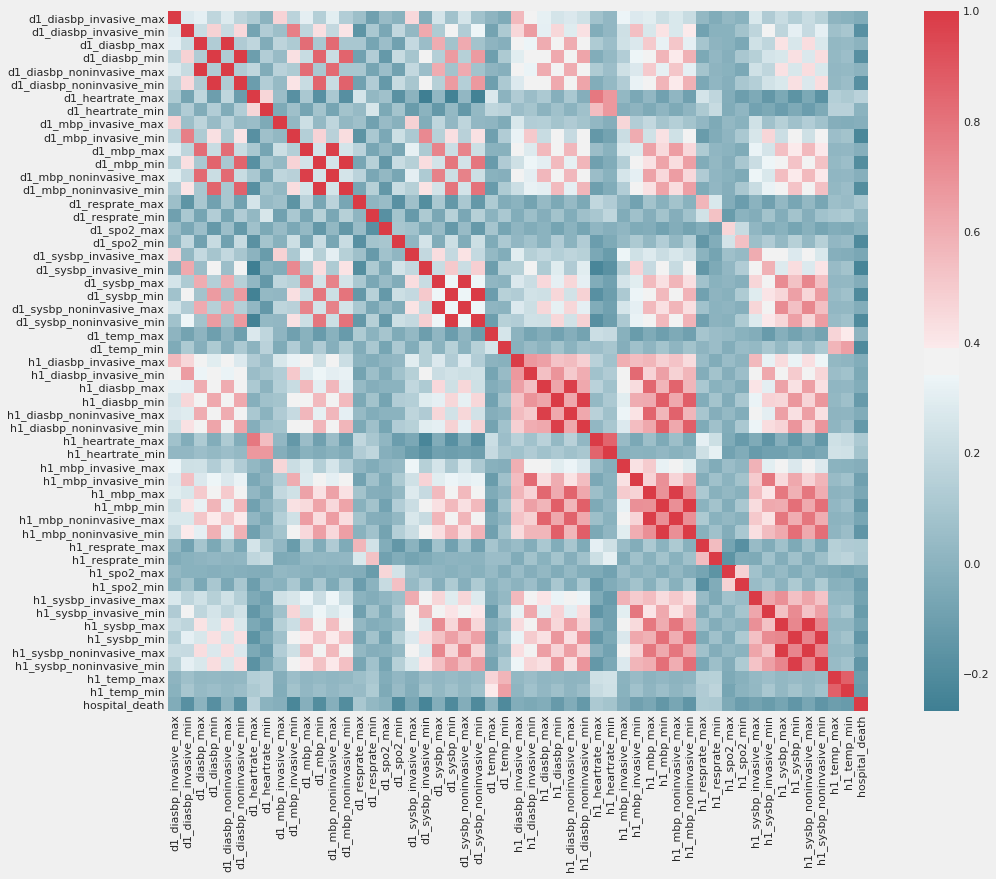

In [0]:
#heat map to check the correlation
f, ax = plt.subplots(figsize=(18, 12))
corr = vitals.corr()
sns.heatmap(corr, mask=np.zeros_like(corr, dtype=np.bool), cmap=sns.diverging_palette(220, 10, as_cmap=True),
            square=True, ax=ax)
plt.show()

____
**The charts below are not really useful, but some of them indicate significant different patterns of death and survived patients. **
___

In [0]:
sns.pairplot(vitals, hue="hospital_death")

Output hidden; open in https://colab.research.google.com to view.

#### temp

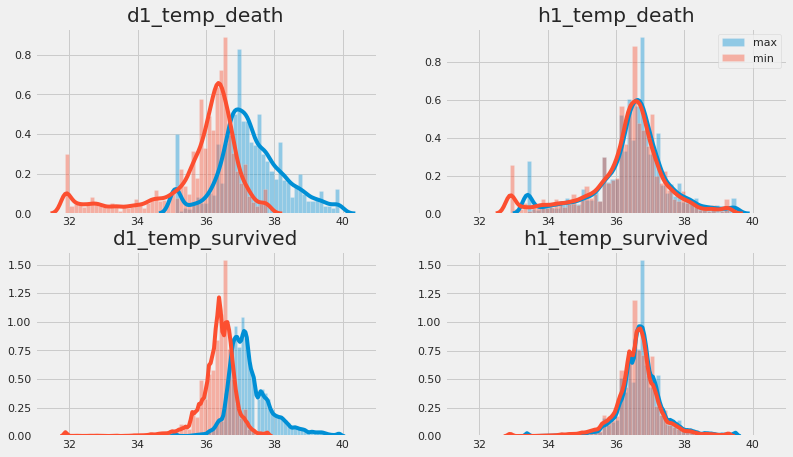

In [0]:
vitals_temp = ['d1_temp_max','d1_temp_min','h1_temp_max','h1_temp_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_temp[:2]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_temp_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_temp_death")
  ax[0][0].set_xlim([31, 41])
  ax[1][0].set_xlim([31, 41])
for i in vitals_temp[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_temp_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_temp_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([31, 41])
  ax[0][1].set_xlim([31, 41])

#### resprate

h1_resprate_max
h1_resprate_max
h1_resprate_min
h1_resprate_min


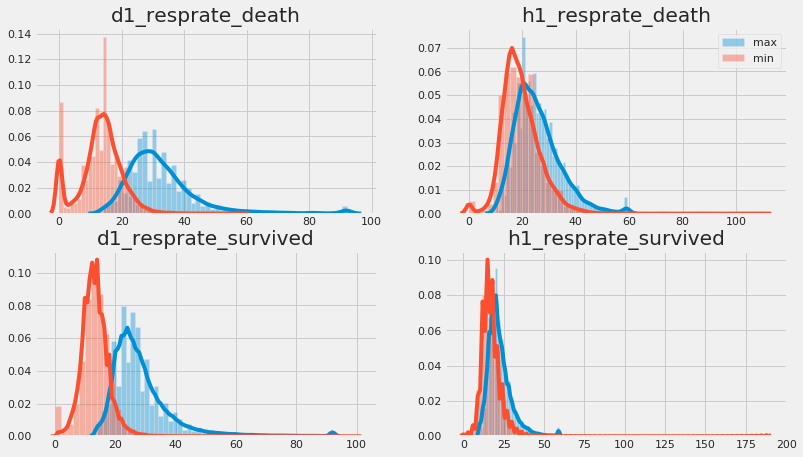

In [0]:
vitals_resprate = ['d1_resprate_max','d1_resprate_min','h1_resprate_max','h1_resprate_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_resprate[:2]:
  target_0 = vitals.loc[vitals['hospital_death'] == 0]
  target_1 = vitals.loc[vitals['hospital_death'] == 1]
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_resprate_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_resprate_death")
for i in vitals_resprate[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_resprate_survived")
  print(i)
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_resprate_death")
  print(i)
  ax[0][1].legend(['max','min'])
  # Add xlim

In [0]:
vitals_resprate[2:]

['h1_resprate_max', 'h1_resprate_min']

In [0]:
for i in vitals_resprate[2:]:
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_resprate_death")
  print(i)

h1_resprate_max
h1_resprate_min


#### heartrate

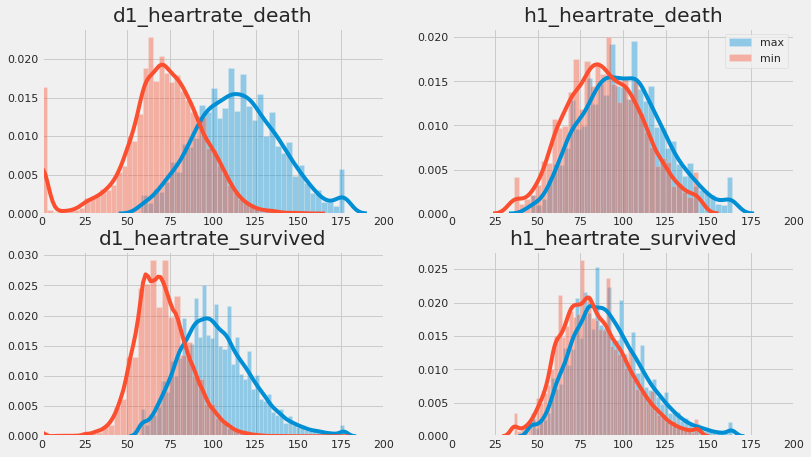

In [0]:
vitals_heartrate = ['d1_heartrate_max','d1_heartrate_min','h1_heartrate_max','h1_heartrate_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_heartrate[:2]:
  target_0 = vitals.loc[vitals['hospital_death'] == 0]
  target_1 = vitals.loc[vitals['hospital_death'] == 1]
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_heartrate_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_heartrate_death")
  ax[0][0].set_xlim([0, 200])
  ax[1][0].set_xlim([0, 200])
for i in vitals_heartrate[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_heartrate_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_heartrate_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 200])
  ax[0][1].set_xlim([0, 200])

#### spo2

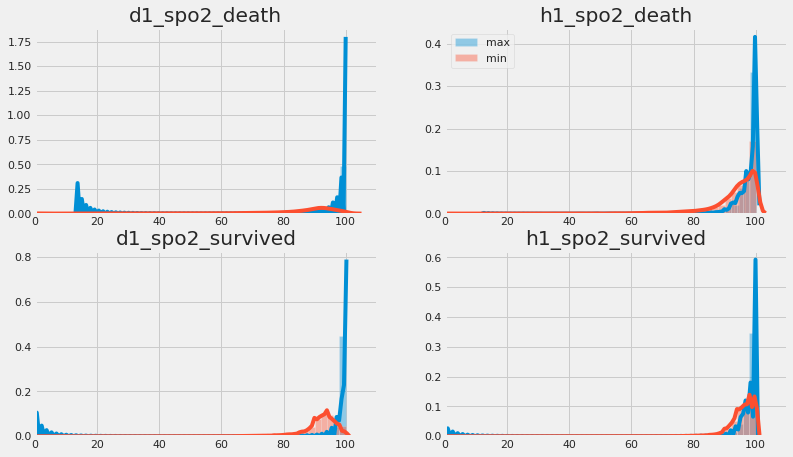

In [0]:
vitals_spo2 = ['d1_spo2_max','d1_spo2_min','h1_spo2_max','h1_spo2_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_spo2[:2]:
  target_0 = vitals.loc[vitals['hospital_death'] == 0]
  target_1 = vitals.loc[vitals['hospital_death'] == 1]
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_spo2_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_spo2_death")
  ax[0][0].set_xlim([0, 110])
  ax[1][0].set_xlim([0, 110])
for i in vitals_spo2[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_spo2_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_spo2_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 110])
  ax[0][1].set_xlim([0, 110])

#### diasbp

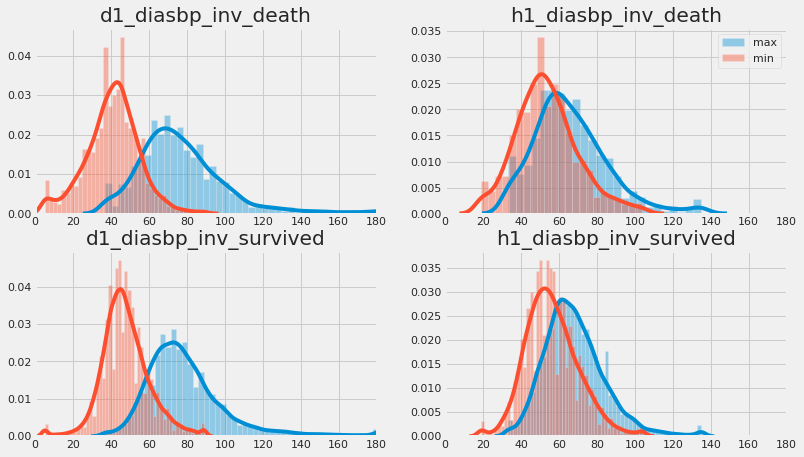

In [0]:
vitals_diasbp_invasive = ['d1_diasbp_invasive_max','d1_diasbp_invasive_min','h1_diasbp_invasive_max','h1_diasbp_invasive_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_diasbp_invasive[:2]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_diasbp_inv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_diasbp_inv_death")
  ax[0][0].set_xlim([0, 180])
  ax[1][0].set_xlim([0, 180])
for i in vitals_diasbp_invasive[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_diasbp_inv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_diasbp_inv_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 180])
  ax[0][1].set_xlim([0, 180])

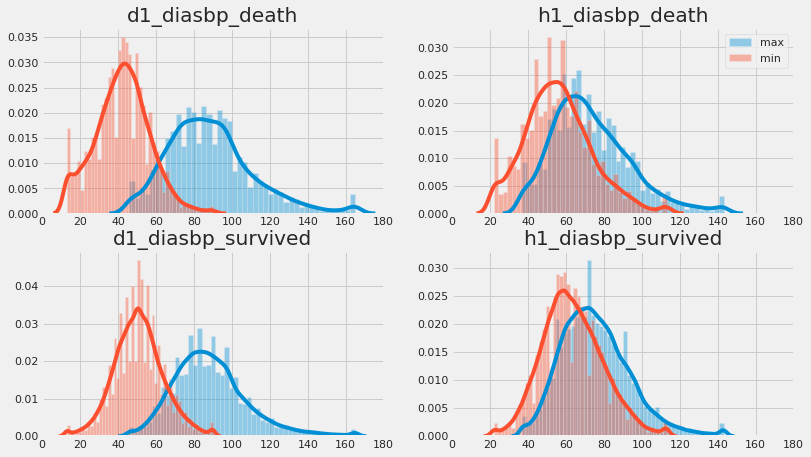

In [0]:
vitals_diasbp = ['d1_diasbp_max','d1_diasbp_min','h1_diasbp_max','h1_diasbp_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_diasbp[:2]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_diasbp_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_diasbp_death")
  ax[0][0].set_xlim([0, 180])
  ax[1][0].set_xlim([0, 180])
for i in vitals_diasbp[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_diasbp_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_diasbp_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 180])
  ax[0][1].set_xlim([0, 180])

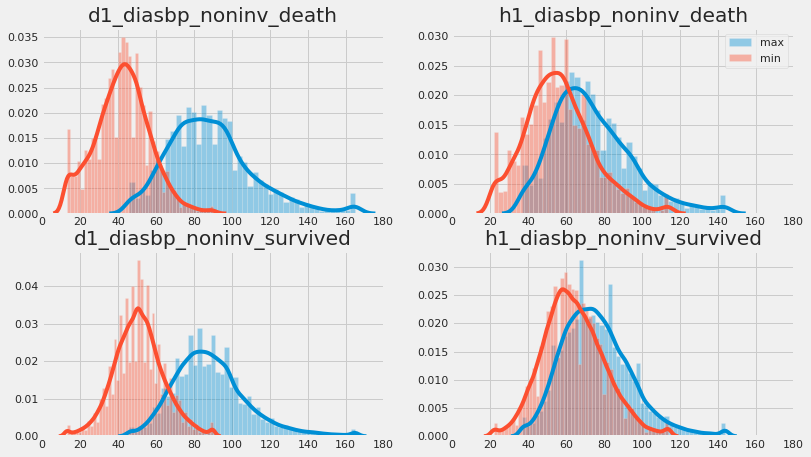

In [0]:
vitals_diasbp_noninv = ['d1_diasbp_noninvasive_max','d1_diasbp_noninvasive_min','h1_diasbp_noninvasive_max','h1_diasbp_noninvasive_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_diasbp_noninv[:2]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_diasbp_noninv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_diasbp_noninv_death")
  ax[0][0].set_xlim([0, 180])
  ax[1][0].set_xlim([0, 180])
for i in vitals_diasbp_noninv[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_diasbp_noninv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_diasbp_noninv_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 180])
  ax[0][1].set_xlim([0, 180])

#### mbp

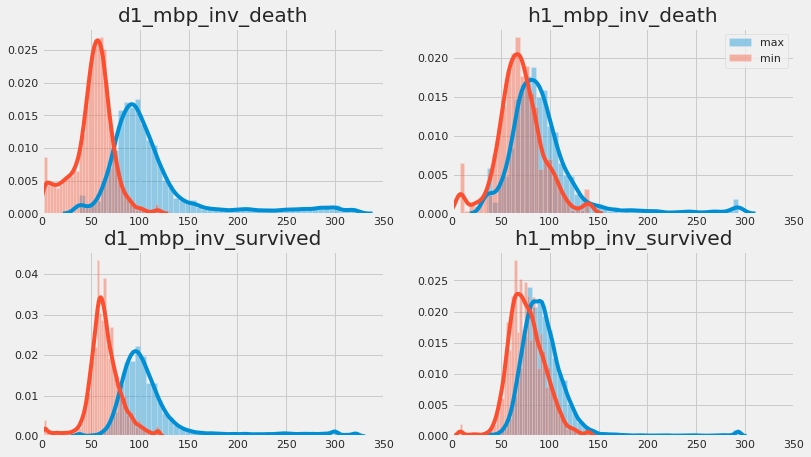

In [0]:
# mbp_invasive
vitals_mbp_inv = ['d1_mbp_invasive_max','d1_mbp_invasive_min','h1_mbp_invasive_max','h1_mbp_invasive_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_mbp_inv[:2]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_mbp_inv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_mbp_inv_death")
  ax[0][0].set_xlim([0, 350])
  ax[1][0].set_xlim([0, 350])
for i in vitals_mbp_inv[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_mbp_inv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_mbp_inv_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 350])
  ax[0][1].set_xlim([0, 350])

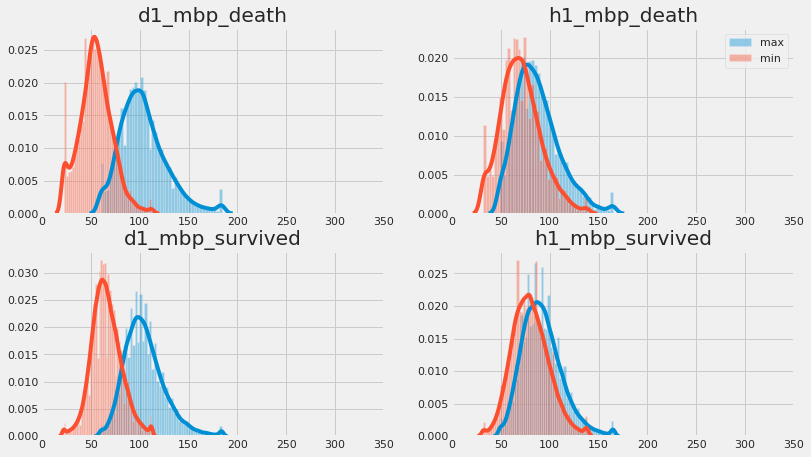

In [0]:
# mbp_invasive
vitals_mbp = ['d1_mbp_max','d1_mbp_min','h1_mbp_max','h1_mbp_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_mbp[:2]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_mbp_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_mbp_death")
  ax[0][0].set_xlim([0, 350])
  ax[1][0].set_xlim([0, 350])
for i in vitals_mbp[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_mbp_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_mbp_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 350])
  ax[0][1].set_xlim([0, 350])

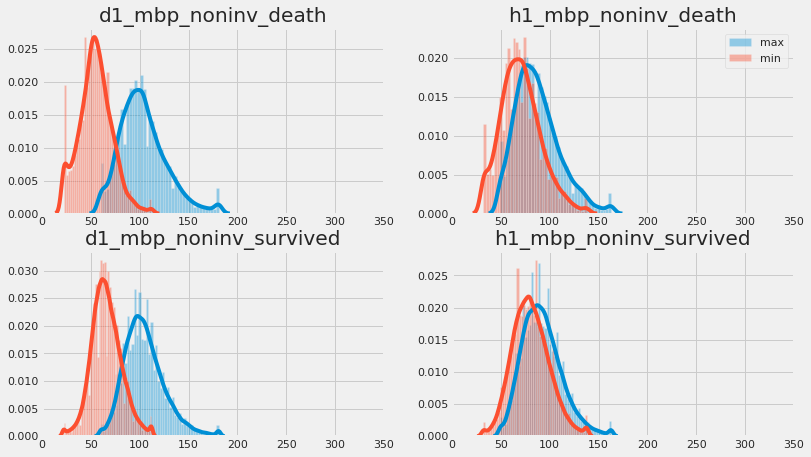

In [0]:
vitals_mbp_noninv = ['d1_mbp_noninvasive_max','d1_mbp_noninvasive_min','h1_mbp_noninvasive_max','h1_mbp_noninvasive_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_mbp_noninv[:2]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_mbp_noninv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_mbp_noninv_death")
  ax[0][0].set_xlim([0, 350])
  ax[1][0].set_xlim([0, 350])
for i in vitals_mbp_noninv[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_mbp_noninv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_mbp_noninv_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 350])
  ax[0][1].set_xlim([0, 350])

#### sysbp

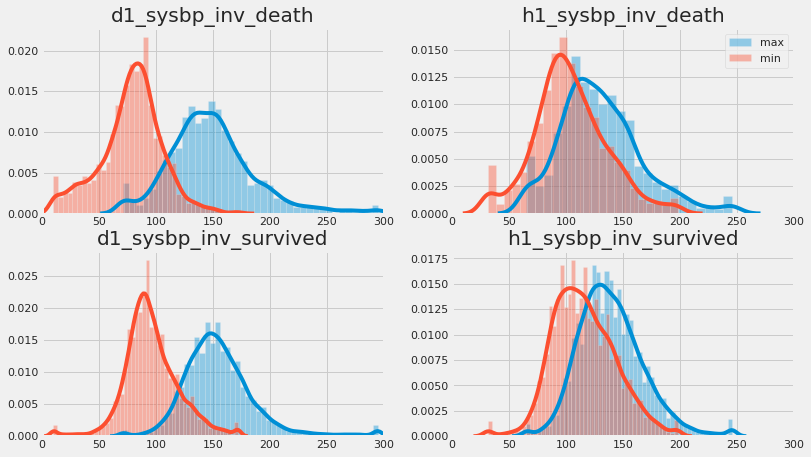

In [0]:
# sysbp_invasive
vitals_sysbp_inv = ['d1_sysbp_invasive_max','d1_sysbp_invasive_min','h1_sysbp_invasive_max','h1_sysbp_invasive_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_sysbp_inv[:2]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_sysbp_inv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_sysbp_inv_death")
  ax[0][0].set_xlim([0, 300])
  ax[1][0].set_xlim([0, 300])
for i in vitals_sysbp_inv[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_sysbp_inv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_sysbp_inv_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 300])
  ax[0][1].set_xlim([0, 300])

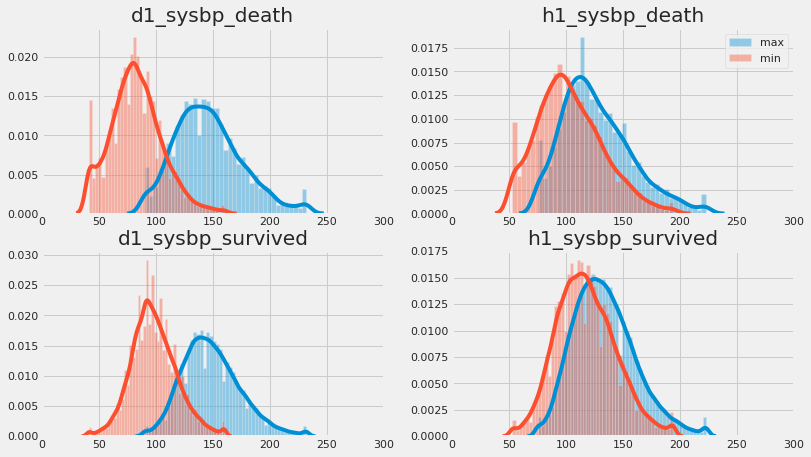

In [0]:
# sysbp

vitals_sysbp = ['d1_sysbp_max','d1_sysbp_min','h1_sysbp_max','h1_sysbp_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_sysbp[:2]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_sysbp_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_sysbp_death")
  ax[0][0].set_xlim([0, 300])
  ax[1][0].set_xlim([0, 300])
for i in vitals_sysbp[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_sysbp_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_sysbp_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 300])
  ax[0][1].set_xlim([0, 300])

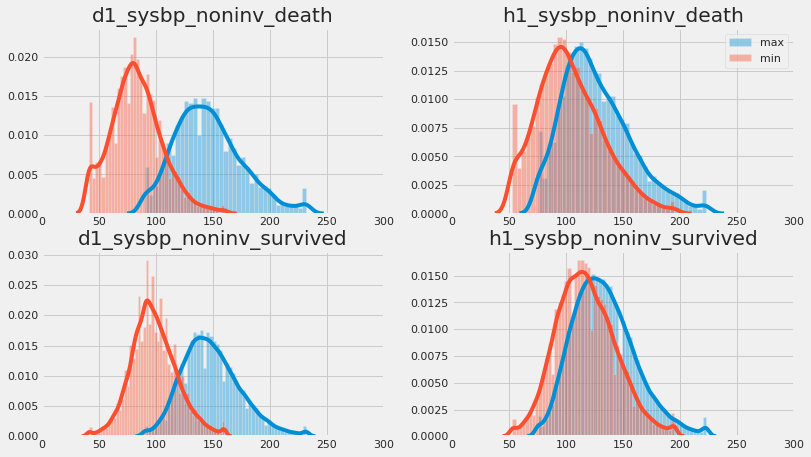

In [0]:
# sysbp_noninvasive

vitals_sysbp_noninv = ['d1_sysbp_noninvasive_max','d1_sysbp_noninvasive_min','h1_sysbp_noninvasive_max','h1_sysbp_noninvasive_min']

fig, ax = plt.subplots(2, 2, figsize=(12, 7))
for i in vitals_sysbp_noninv[:2]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][0]).set_title("d1_sysbp_noninv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][0]).set_title("d1_sysbp_noninv_death")
  ax[0][0].set_xlim([0, 300])
  ax[1][0].set_xlim([0, 300])
for i in vitals_sysbp_noninv[2:]:
  sns.distplot(target_0[[i]], hist=True, kde=True, ax = ax[1][1]).set_title("h1_sysbp_noninv_survived")
  sns.distplot(target_1[[i]], hist=True, kde=True, ax = ax[0][1]).set_title("h1_sysbp_noninv_death")
  ax[0][1].legend(['max','min'])
  ax[1][1].set_xlim([0, 300])
  ax[0][1].set_xlim([0, 300])

#### all in one

Pretty hard to look at. 

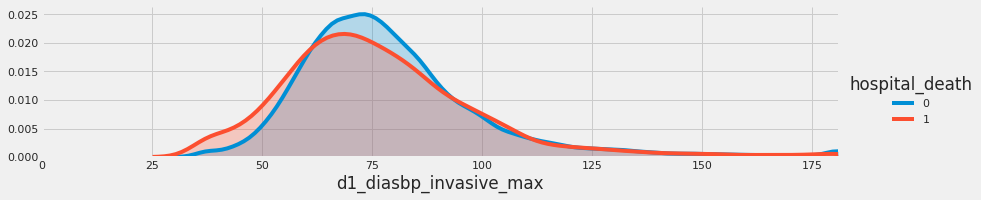

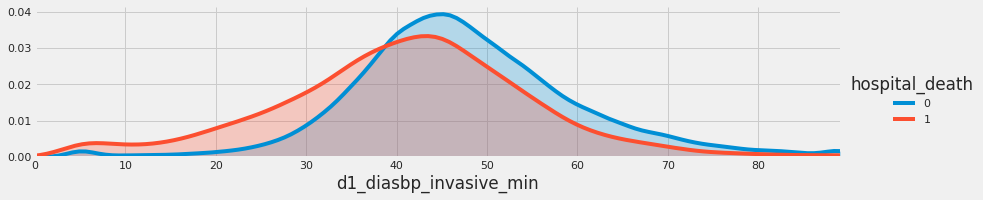

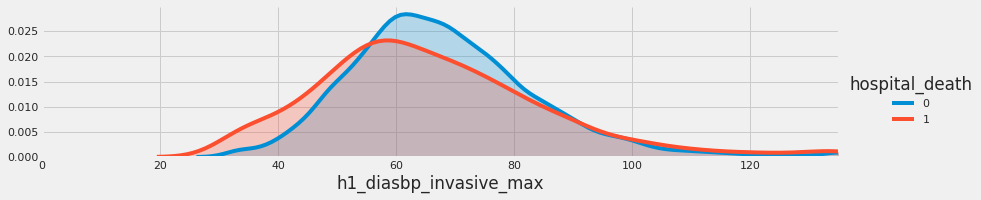

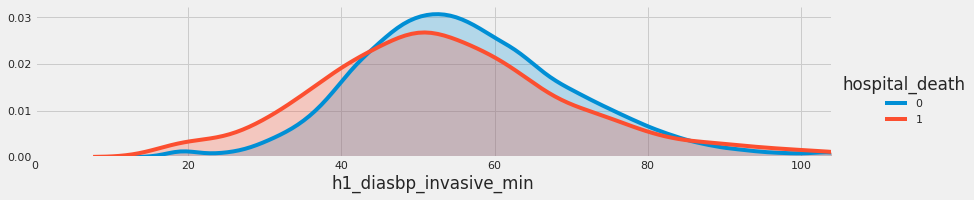

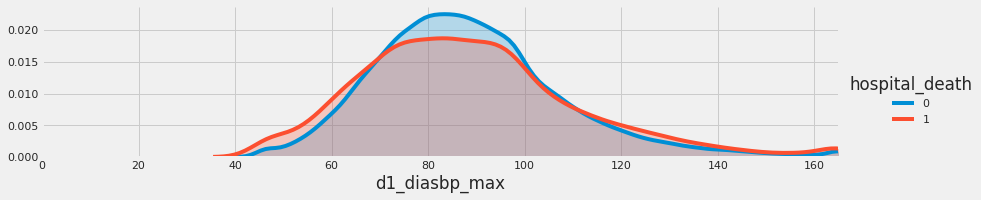

...

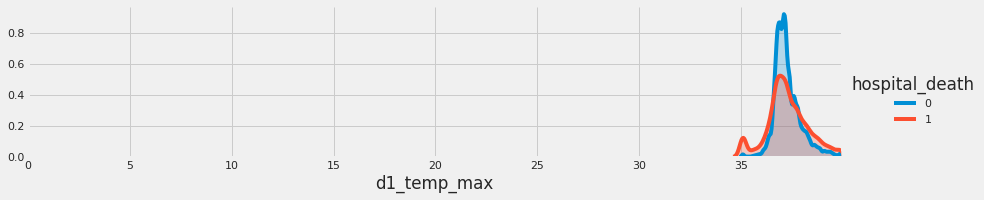

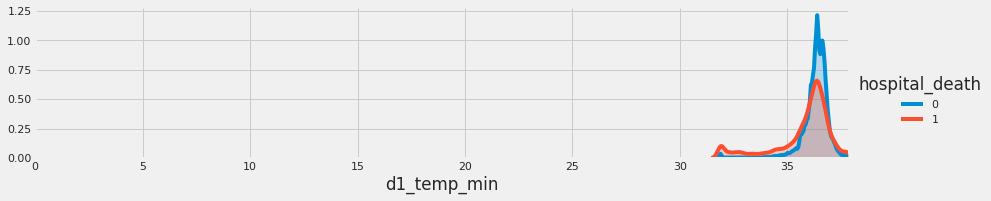

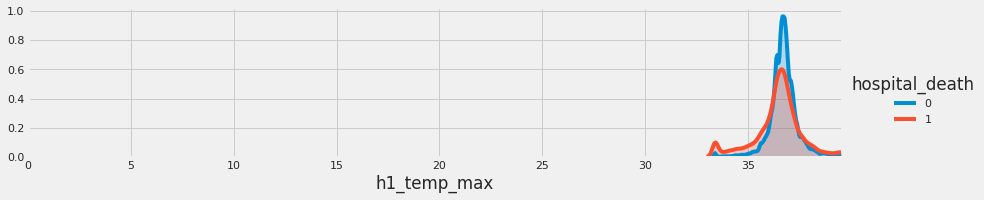

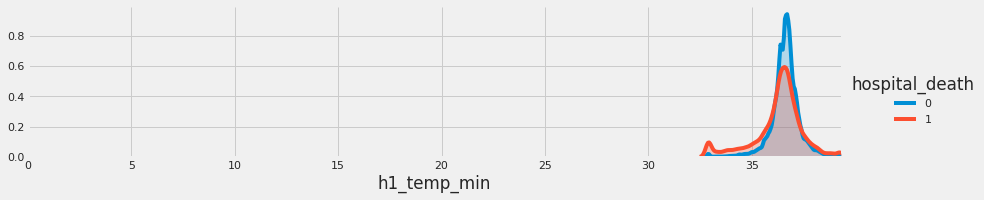

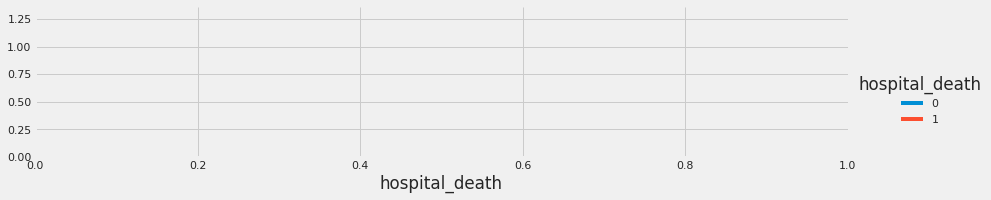

In [0]:
vital_cols = dictionary[dictionary['Category'] == 'vitals']['Variable Name'].to_list()
vital_cols.append('hospital_death')
vitals = df[vital_cols]

vital_cols = [#'d1_diasbp_invasive_max','d1_diasbp_invasive_min','h1_diasbp_invasive_max','h1_diasbp_invasive_min',
              #'d1_diasbp_max','d1_diasbp_min','h1_diasbp_max','h1_diasbp_min',
              #'d1_diasbp_noninvasive_max','d1_diasbp_noninvasive_min','h1_diasbp_noninvasive_max','h1_diasbp_noninvasive_min',
              #'d1_heartrate_max','d1_heartrate_min','h1_heartrate_max','h1_heartrate_min',
              # 'd1_mbp_invasive_max','d1_mbp_invasive_min','h1_mbp_invasive_max','h1_mbp_invasive_min',
              # 'd1_mbp_max','d1_mbp_min','h1_mbp_max','h1_mbp_min',
              # 'd1_mbp_noninvasive_max','d1_mbp_noninvasive_min','h1_mbp_noninvasive_max','h1_mbp_noninvasive_min',
              #'d1_resprate_max','d1_resprate_min','h1_resprate_max','h1_resprate_min',
              #'d1_spo2_max','d1_spo2_min','h1_spo2_max','h1_spo2_min',
              #'d1_sysbp_invasive_max','d1_sysbp_invasive_min','h1_sysbp_invasive_max','h1_sysbp_invasive_min',
              #'d1_sysbp_max','d1_sysbp_min','h1_sysbp_max','h1_sysbp_min',
              #'d1_sysbp_noninvasive_max','d1_sysbp_noninvasive_min','h1_sysbp_noninvasive_max','h1_sysbp_noninvasive_min',
              #'d1_temp_max','d1_temp_min','h1_temp_max','h1_temp_min','hospital_death']
              
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=RuntimeWarning)
warnings.filterwarnings("ignore", category=UserWarning)

for i in vital_cols:
  plot_distribution(vitals, var=i, target="hospital_death")

### 5.APACHE comorbidity

Chronic Health Evaluation: APACHE II | III-J

https://www.anzics.com.au/wp-content/uploads/2018/08/ANZICS-APD-Data-Dictionary.pdf

_Evidence of organ insufficiency or immunocompromised state PRIOR to the hospital admission._

APACHE II:
Evidence/existence of the **6 co-morbidities** listed below should be recorded at the time of admission to hospital AND must conform to the following 6 criteria

APACHE III-J:
Evidence/existence of the **7 co-morbidities** listed below should be recorded at the time of the hospital admission AND must conform to the following 7 criteria

This section is not clear enough. Work again!

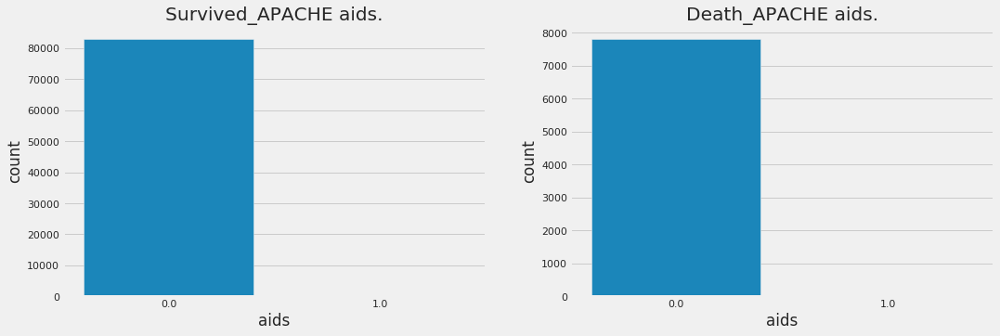

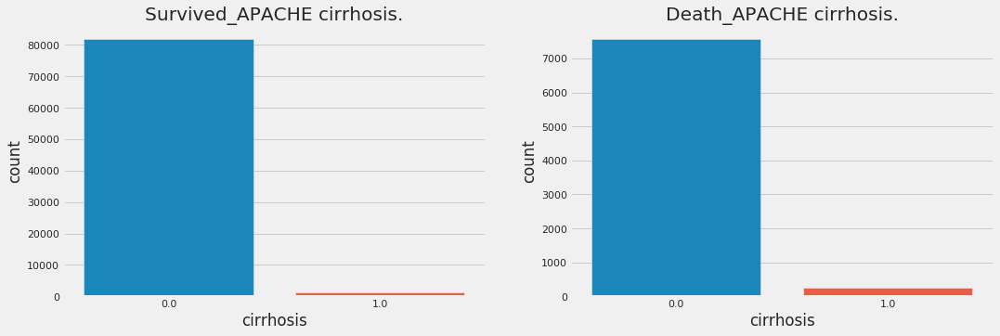

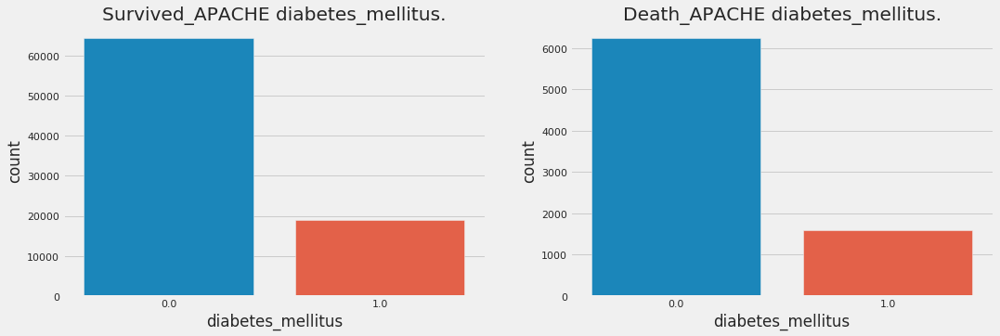

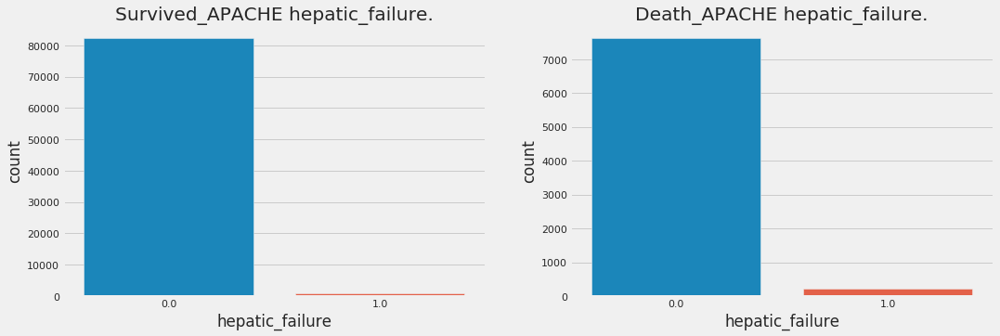

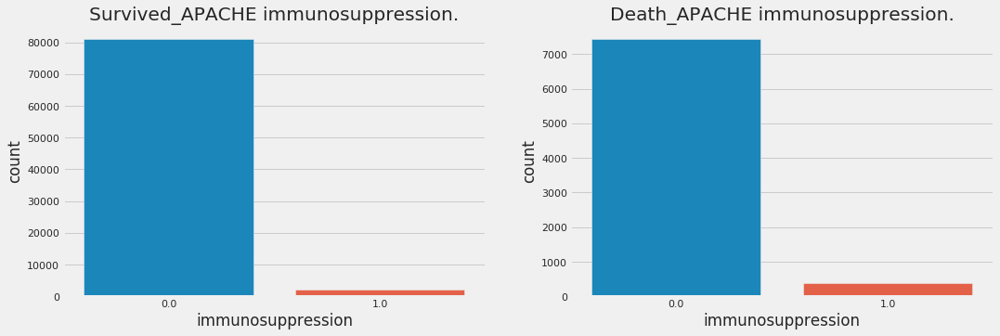

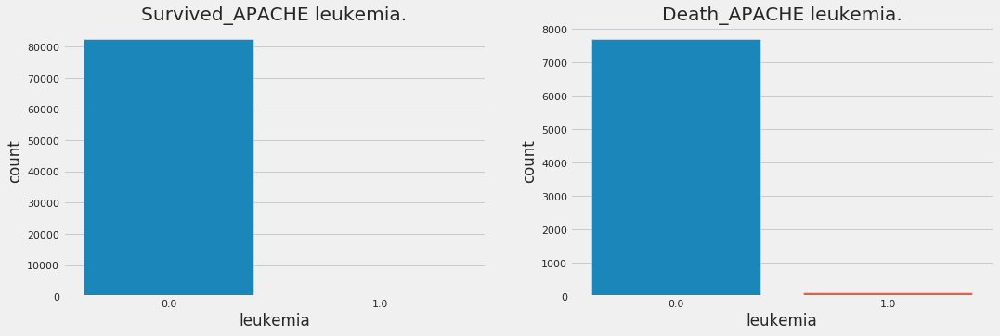

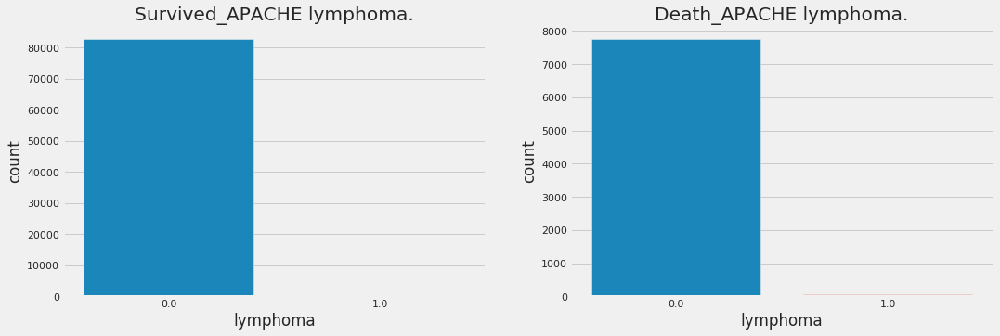

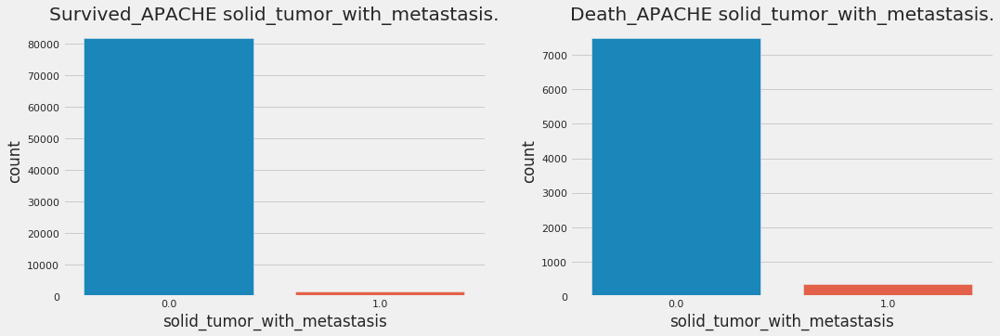

In [0]:
comorbidity_cols = ['aids', 'cirrhosis', 'diabetes_mellitus', 'hepatic_failure', 'immunosuppression', 'leukemia', 'lymphoma', 'solid_tumor_with_metastasis']
    
for i in comorbidity_cols:
    fig, ax = plt.subplots(1, 2, figsize=(16, 5))
   
    target_0 = df.loc[df['hospital_death'] == 0]
    target_1 = df.loc[df['hospital_death'] == 1]

    sns.countplot(target_0[i], ax=ax[0])
    sns.countplot(target_1[i], ax =ax[1])
    ax[0].title.set_text('Survived_APACHE {}.'.format(i))
    ax[1].title.set_text('Death_APACHE {}.'.format(i))

    plt.show()

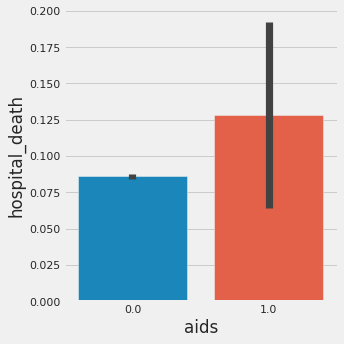

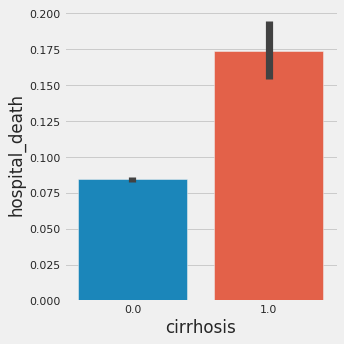

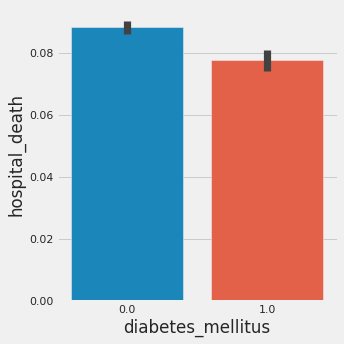

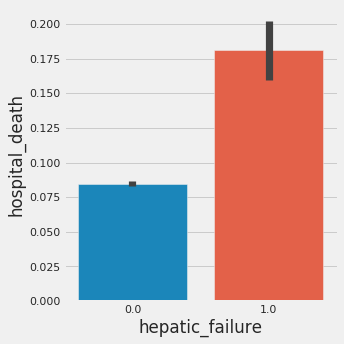

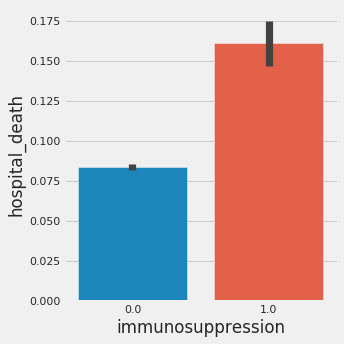

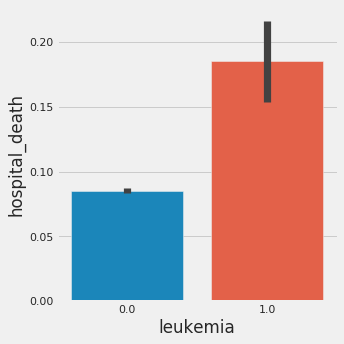

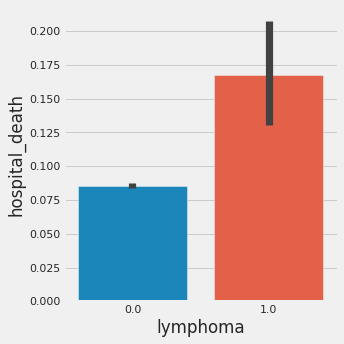

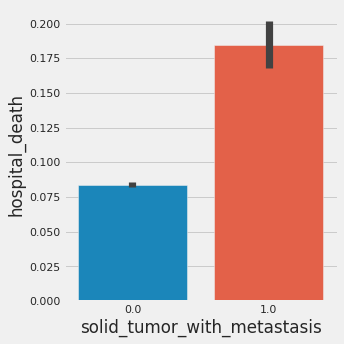

In [0]:
for i in comorbidity_cols:
  sns.catplot(x=i, y="hospital_death", kind="bar", data=df)

___
### 6.APACHE prediction

- `apache_4a_hospital_death_prob` and `apache_4a_icu_death_prob` are 100% correlated >> keep one of them for modeling or have to make any assumption if use both

In [0]:
cols = ['apache_4a_hospital_death_prob', 'apache_4a_icu_death_prob', 'hospital_death']
apache_prediction = df[cols]

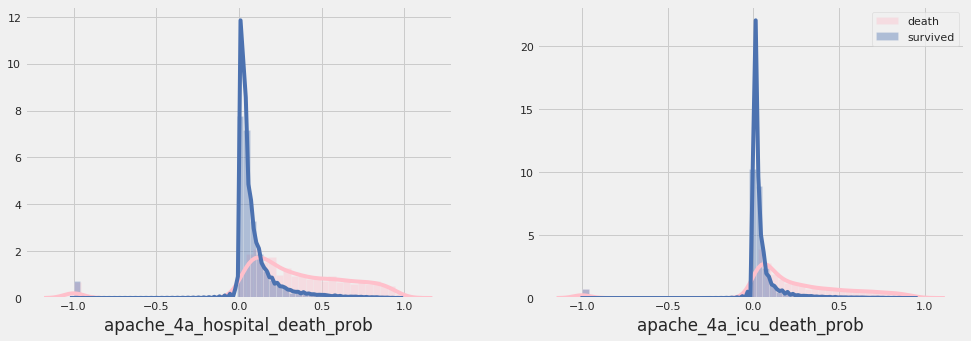

In [0]:
# Plot distribution of apache_prediction_probability by both icu and hospital
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
sns.distplot(apache_prediction[apache_prediction['hospital_death']==1].apache_4a_hospital_death_prob, hist=True, kde=True, ax = ax[0], color ='pink',  label='death')
sns.distplot(apache_prediction[apache_prediction['hospital_death']==0].apache_4a_hospital_death_prob, hist=True, kde=True, ax = ax[0], color='b',  label='survived')
sns.distplot(apache_prediction[apache_prediction['hospital_death']==1].apache_4a_icu_death_prob, hist=True, kde=True,ax = ax[1],color ='pink',  label='death')
sns.distplot(apache_prediction[apache_prediction['hospital_death']==0].apache_4a_icu_death_prob, hist=True, kde=True,ax = ax[1], color='b',  label='survived')
plt.legend();

In [0]:
# Check correlation between icu and hospital (apache_4a)
from scipy.stats import pearsonr
corr, _ = pearsonr(apache_prediction.apache_4a_icu_death_prob.notnull(), apache_prediction.apache_4a_hospital_death_prob.notnull())
print('Pearsons correlation: %.3f' % corr)

Pearsons correlation: 1.000


In [0]:
# Missing values for these two features
print('missing%_apache_4a_icu_death_prob: ',round((apache_prediction.apache_4a_icu_death_prob.isnull().sum()/apache_prediction.shape[0])*100,2))
print('missing%_apache_4a_hospital_death_prob: ',round((apache_prediction.apache_4a_hospital_death_prob.isnull().sum()/apache_prediction.shape[0])*100,2))

missing%_apache_4a_icu_death_prob:  8.67
missing%_apache_4a_hospital_death_prob:  8.67


In [0]:
missing_icu_prob_death = df[(df.apache_4a_icu_death_prob.isnull()) & (df['hospital_death']==1)]
missing_icu_prob_survived = df[(df.apache_4a_icu_death_prob.isnull()) & (df['hospital_death']==0)]

print('death:',missing_icu_prob_death.shape)
print('survived:',missing_icu_prob_survived.shape)

death: (552, 186)
survived: (7395, 186)


___
### 7.APACHE grouping

Decide to choose between these two features: 
- apache_2_bodysystem: 2 variables: undefined diagnosis.
- apache_3j_bodysystem: New variable: `Sepsis`. 


*__Sepsis__ is a potentially life-threatening condition caused by the body's response to an infection. The body normally releases chemicals into the bloodstream to fight an infection. Sepsis occurs when the body's response to these chemicals is out of balance, triggering changes that can damage multiple organ systems.
Diseases or conditions caused: Shock (circulatory)*

In [0]:
# Unique varaibles by apache_2_bodysystem and apache_3j_bodysystem
print('apache_3j_bodysystem:',len(df.apache_3j_bodysystem.unique()))
print('apache_2_bodysystem:',len(df.apache_2_bodysystem.unique()))

apache_3j_bodysystem: 12
apache_2_bodysystem: 11


In [0]:
apache_3j_bodysystem= df.groupby('apache_3j_bodysystem')['hospital_death'].count().reset_index().sort_values('hospital_death', ascending = False)
apache_3j_bodysystem.columns =["apache_3j_bodysystem", 'Count']
apache_3j_bodysystem['Percentage'] = round((apache_3j_bodysystem['Count']/apache_3j_bodysystem.Count.sum())*100,2)
apache_3j_bodysystem.sort_values('Percentage', ascending=False)

,apache_3j_bodysystem,Count,Percentage
0,Cardiovascular,29999,33.3
7,Neurological,11896,13.2
9,Sepsis,11740,13.0
8,Respiratory,11609,12.9
1,Gastrointestinal,9026,10.0
5,Metabolic,7650,8.5
10,Trauma,3842,4.3
2,Genitourinary,2172,2.4
6,Musculoskeletal/Skin,1166,1.3
4,Hematological,638,0.7


In [0]:
apache_2_bodysystem = df.groupby('apache_2_bodysystem')['hospital_death'].count().reset_index().sort_values('hospital_death', ascending = False)
apache_2_bodysystem.columns =["apache_2_bodysystem", 'Count']
apache_2_bodysystem['Percentage'] = round((apache_2_bodysystem['Count']/apache_2_bodysystem.Count.sum())*100,2)
apache_2_bodysystem.sort_values('Percentage', ascending=False)

,apache_2_bodysystem,Count,Percentage
0,Cardiovascular,38816,43.1
4,Neurologic,11896,13.2
6,Respiratory,11609,12.9
1,Gastrointestinal,9026,10.0
3,Metabolic,7650,8.5
7,Trauma,3842,4.3
9,Undefined diagnoses,3768,4.2
5,Renal/Genitourinary,2460,2.7
2,Haematologic,638,0.7
8,Undefined Diagnoses,346,0.4


In [0]:
df[['apache_2_bodysystem', 'apache_3j_bodysystem']]

,apache_2_bodysystem,apache_3j_bodysystem
0,Cardiovascular,Sepsis
1,Respiratory,Respiratory
2,Metabolic,Metabolic
3,Cardiovascular,Cardiovascular
4,Trauma,Trauma
...,...,...
91708,Cardiovascular,Sepsis
91709,Cardiovascular,Sepsis
91710,Metabolic,Metabolic
91711,Respiratory,Respiratory


In [0]:
# 'Unknown diagnosis' in APACHE II were diagnosed with 'Cardiovascular' and 'Musculoskeletal/Skin' in APACHE III - 4114 cases
print(df[(df['apache_2_bodysystem']== 'Undefined Diagnoses') | (df['apache_2_bodysystem']== 'Undefined diagnoses')].apache_3j_bodysystem.unique())
print(df[(df['apache_2_bodysystem']== 'Undefined Diagnoses') | (df['apache_2_bodysystem']== 'Undefined diagnoses')].shape)

['Cardiovascular' 'Musculoskeletal/Skin']
(4114, 186)


In [0]:
# New 'Sepsis' category in APACHE III is coming from 'Cardiovascular' in APACHE II, 11740 cases
print(df[(df['apache_3j_bodysystem']== 'Sepsis')].apache_2_bodysystem.unique())
print(df[(df['apache_3j_bodysystem']== 'Sepsis')].apache_2_bodysystem.shape)

['Cardiovascular']
(11740,)


(0, 0.16)

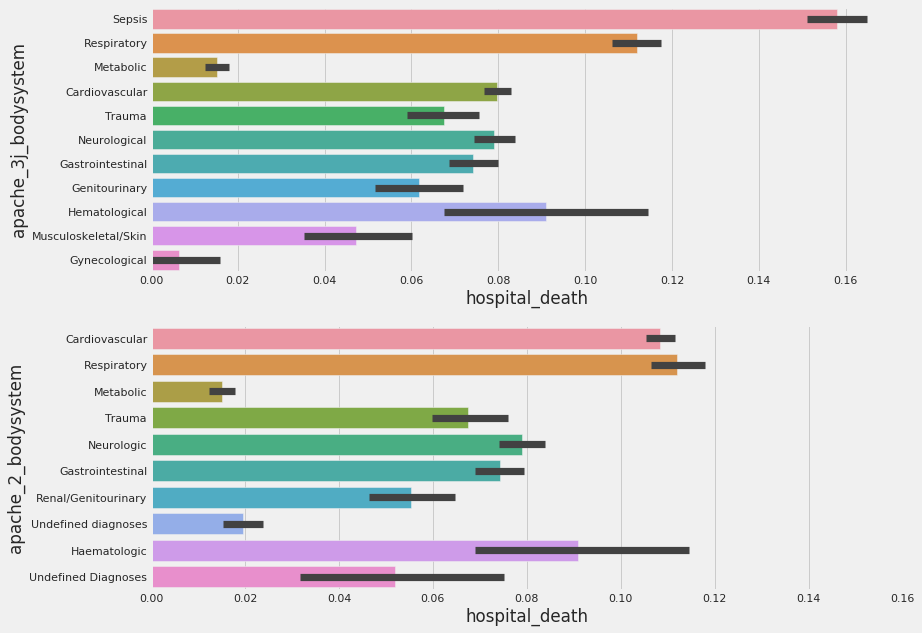

In [0]:
# Hospital_death vs. apache_3j_bodysystem and apache_2_bodysystem
fig, ax = plt.subplots(2, 1, figsize=(12, 10))
sns.barplot(y="apache_3j_bodysystem", x="hospital_death" , data=df, ax= ax[0])
sns.barplot(y="apache_2_bodysystem", x="hospital_death" , data=df, ax= ax[1])
plt.xlim(0,0.16)

In [0]:
df.apache_3j_bodysystem.isnull().sum()

1662

In [0]:
plt.figure(figsize=(12,8))
# plot barh chart with index as x values
ax = sns.barplot(pd_df.apache_3j_bodysystem, pd_df.Count)
ax.get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}".format(int(x))))
ax.set(xlabel="Dim", ylabel='Count')
# add proper Dim values as x labels
ax.set_xticklabels(pd_df.Dim)
for item in ax.get_xticklabels(): item.set_rotation(90)
for i, v in enumerate(pd_df["Count"].iteritems()):        
    ax.text(i ,v[1], "{:,}".format(v[1]), color='m', va ='bottom', rotation=45)
plt.tight_layout()
plt.show()


__NOTES:__

Can impute missing values by two ways:
- Create group: Others
- Based on Apache comorbidity and other diagnosis to impute missing values